# Рынок заведений общественного питания Москвы

## Обзор и предобработка данных

In [113]:
#импортируем все нужные библиотеки 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import folium
from folium import Map, Choropleth
from folium.plugins import MarkerCluster
from folium import Map, Marker
from folium.features import CustomIcon
from folium.plugins import HeatMap
import json
import geopandas as gpd


# библиотека для простого подсчета расстояний между координатами 
import haversine as hs 

In [2]:
data = pd.read_csv('/Users/ivansuckov/yp-projects/yp_data_analytics_projects/moscow_cafe/moscow_places.csv')
    
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [3]:
# сохраняем geojson с административным делением в переменную state_geo
json_file = '/Users/ivansuckov/yp-projects/yp_data_analytics_projects/moscow_cafe/admin_level_geomap.geojson'
with open(json_file, 'r') as j:
    state_geo = json.loads(j.read())

In [4]:
# выводим информацию о датасете

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


В нашем распоряжении 8406 строк - столько заведений представлено в датасете (пока мы не удалили возможные дубликаты).

Названия колонок нас устраивают. 

Пропуски есть в слудющих колонках: 
- `hours` - если это сетевые заведения, то восстановим часы работы по остальным заведениям сети; а если не сетевые - поставим заглушку "unknown";
- `price` - если для заведения есть показатель `middle_avg_bill`, то можно восстановить пропуски по общим значениям для датасета. Если нет, то поставим заглушку "unknown"; 
- пропуски в колонках `avg_bill`, `middle_avg_bill`, `middle_coffee_cup` оставим в формате Null, так как по этим колонкам возможно придется считать средние показатели, а восстановить данные косвенным путем будет проблематично; 
- пропуски в колонке количества мест оставим как есть, потому что восстанавливать по косвенным данным может быть не совсем корректно: даже для заведений одной сети или в одном районе показатель количества мест может очень сильно разниться. 

Типы данных: 
- поменяем тип данных в колонке `chain` на bool. 
- во всех остальных колонках типы данных правильные. 

In [5]:
# проверим явные дубликаты

print(f'количество явных дубликатов: {data.duplicated().sum()}')
display(data[data.duplicated() == True])

количество явных дубликатов: 0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


Явных дубликатов нет.

---

Првоерим уникальные значения в столбцах с категориями и округами.

In [6]:
list(data['category'].unique())

['кафе',
 'ресторан',
 'кофейня',
 'пиццерия',
 'бар,паб',
 'быстрое питание',
 'булочная',
 'столовая']

Категоризация справедливая. Проблем нет.

In [7]:
list(data['district'].unique())

['Северный административный округ',
 'Северо-Восточный административный округ',
 'Северо-Западный административный округ',
 'Западный административный округ',
 'Центральный административный округ',
 'Восточный административный округ',
 'Юго-Восточный административный округ',
 'Южный административный округ',
 'Юго-Западный административный округ']

9 округов. В датасет попала Москва в пределах МКАД. 

---

Необходимо выявить и исправить неявные дубликаты в колонке `name`.

In [8]:
# проверим, есть ли вообще неявные дубликаты в именах

sorted(list(data['name'].unique()))

['#КешбэкКафе',
 '+39 Pizzeria Mozzarella bar',
 '1 Этаж',
 '1-я Креветочная',
 '10 Идеальных Пицц',
 '1001 Ночь',
 '100ловая',
 '100лоффка',
 '13',
 '13 Chef doner',
 '15 Kitchen+Bar',
 '15-й Шар',
 '16 Июня',
 '16 Тонн',
 '18 Грамм',
 '1901 Comfort Food Zone',
 '1у',
 '2 Типа',
 '2-й Этаж',
 '2046',
 '21 Век',
 '22 Акра Кофе&Хлеб',
 '2U-Ту-Ю',
 '3 Ступени',
 '351 Bar',
 '4 Сезона',
 '4.2. Bar',
 '4/1 Restaurant',
 '42 Coffee Shop',
 '47',
 '495',
 '4friends Coffee',
 '4tuna Cafe&Grill',
 '5 Stars Coffee',
 '55.709201, 37.392257',
 '6 Am Bread Kitchen',
 '6 Рукопожатий',
 '69 раков',
 '7 Сэндвичей',
 '7 элемент',
 '7/12',
 '8 Oz',
 '8 Вафель',
 '8 Зёрен',
 '8 Пончиков',
 '800°с Contemporary Steak',
 '8bit Pizza',
 '9 Bar Coffe',
 '9 Bar Coffee',
 '9 Зёрен',
 'A-cafe',
 'ABC Coffee Roasters',
 'ABC coffee roasters',
 'Acai Family',
 'Accent',
 "Adam's Chicken",
 'Adria Mare',
 'Ahava',
 'Air Coffee',
 'Al Halal',
 'Al33 Пиццерия бар Боттега',
 'All Day',
 'Alma',
 'Alternative coffee',

Есть. Например, 'ABC Coffee Roasters' и 'ABC coffee roasters'; или 'Bb Grill' и 'Bb grill'. 
Посотрим на этих примерах, дубликаты ли это или лишь разные написания названий заведений из одной сети. 

In [9]:
data.loc[data['name'].isin(['ABC Coffee Roasters', 'ABC coffee roasters'])]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1442,ABC coffee roasters,кофейня,"Москва, Ленинградский проспект, 72, корп. 1",Северный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.805547,37.520395,4.5,средние,Цена чашки капучино:220–270 ₽,NaN,245.0,0,625.0
3813,ABC Coffee Roasters,кофейня,"Москва, Большая Никитская улица, 19/16с1",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.757162,37.600701,4.4,NaN,NaN,NaN,NaN,1,NaN
4163,ABC Coffee Roasters,кофейня,"Москва, Усачёва улица, 11И",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.727530,37.570567,4.4,NaN,NaN,NaN,NaN,1,NaN
4696,ABC Coffee Roasters,кофейня,"Москва, улица Покровка, 7/9-11к1, подъезд 10",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.759012,37.642190,4.4,NaN,NaN,NaN,NaN,1,NaN
5156,ABC Coffee Roasters,кофейня,"Москва, Ордынский тупик, 4А",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.741026,37.623384,4.5,NaN,NaN,NaN,NaN,1,NaN


In [10]:
data.loc[data['name'].isin(['Bb Grill', 'Bb grill'])]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2694,Bb grill,"бар,паб","Москва, Семёновская площадь, 1",Восточный административный округ,"ежедневно, 12:00–23:00",55.782891,37.720496,4.6,высокие,Средний счёт:1500–2500 ₽,2000.0,NaN,0,100.0
6371,Bb Grill,"бар,паб","Москва, Автозаводская улица, 18",Южный административный округ,"ежедневно, 10:00–23:00",55.705429,37.641989,4.4,выше среднего,Средний счёт:1700 ₽,1700.0,NaN,0,455.0


- В случае с ABC - одна кофейня действительно часть сети, но записана по-другому, причем не стоит и отметка о сети. Судя по всему, причина ошибки в заполнении данных в Яндекс картах.
- В случае с Bb grill - оба заведения, вероятно, тоже относятся к одной сети, но ни у одного не стоит отметка о том, что заведение входит в сеть. 

Таким образом, речь не сколько о дубликатах, а о разном написании названия заведений внутри сетей. 

Поступим так: избавимся от ошибки разного написания названий, не обращая внимания на то, стоит отметка о сети или нет (как, например, в случае с Bb grill отметка может не стоять потому что заведений всего два). И только после этого заполним отметками о сети все значения в колонке chain, где это необходимо.

In [11]:
# колонка с названиями в формате без заглавных букв
data['name_lowstr'] = data['name'].str.lower()

# колонка, которая покажет, есть ли несоотвествие между количеством заведений по двум видам записи
data['missmatch'] = (
    data['name'].map(data.groupby('name')['lat'].count().to_dict()) != \
    data['name_lowstr'].map(data.groupby('name_lowstr')['lat'].count().to_dict())
)

# выводим отсортированный список проблемных названий
sorted(data.query('missmatch == True')['name'].unique())

['ABC Coffee Roasters',
 'ABC coffee roasters',
 'BFL’S',
 'Bb Grill',
 'Bb grill',
 'Bfl’s',
 'Burger Club',
 'Burger club',
 'Carrots and Beans',
 'Carrots and beans',
 'Coffee Point',
 'Coffee point',
 'Deli2Go',
 'Deli2go',
 'Di Villaggio',
 'Di villaggio',
 'Espresso Bar',
 'Espresso bar',
 'FLIP',
 'Flip',
 'Han Cook',
 'Han cook',
 'HelloPapaya',
 'Hellopapaya',
 'I Like Wine',
 'I like wine',
 'IL Pizzaiolo',
 'IL pizzaiolo',
 'Istanbul Kebab',
 'Istanbul kebab',
 'Korean Chick',
 'Korean chick',
 'Ku: Рамен Изакая бар',
 'Ku: рамен изакая бар',
 'More Poke',
 'More poke',
 'Noba Coffee',
 'Noba coffee',
 'Nova Bubble Tea',
 'Nova bubble tea',
 'One Price Coffee',
 'One price coffee',
 'One&Double',
 'One&double',
 'Pasta Cup & Pizza',
 'Pasta cup & pizza',
 'Pho Street',
 'Pho street',
 'PiNzeria by Bontempi',
 'Pinzeria by Bontempi',
 'Poke House',
 'Poke house',
 'Pomodoro Royal',
 'Pomodoro royal',
 'Raw to Go',
 'Raw to go',
 'SeDelice',
 'Sedelice',
 'Sova Coffee',
 'Sova

In [12]:
# производим замену значений, которые расположились не подряд 

data = (
    data
    .replace(
        {"name": 
         {"Bfl’s": "BFL’S",
          "Вкус востока": "Вкус Востока",
          "Вкус дня": "Вкус Дня",
          "Донер бистро": "Донер Бистро",
          "Донер кебаб": "Донер Кебаб",
          "Донер хаус": "Донер Хаус",
          "Ма Ми": "МА Ми",
          "Хлеб насущный": "Хлеб Насущный",
          "Чудо печка": "Чудо Печка",
          "Чудо тандыр": "Чудо Тандыр",
          "Шашлык хаус": "Шашлык Хаус"}
        }
    )
)


In [13]:
# проводим проверку еще раз

# колонка с названиями в формате без заглавных букв
data['name_lowstr'] = data['name'].str.lower()

# колонка, которая покажет, есть ли несоотвествие между количеством заведений по двум видам записи
data['missmatch'] = (
    data['name'].map(data.groupby('name')['lat'].count().to_dict()) != \
    data['name_lowstr'].map(data.groupby('name_lowstr')['lat'].count().to_dict())
)

# выводим отсортированный список проблемных названий
trouble_names = sorted(data.query('missmatch == True')['name'].unique())
trouble_names

['ABC Coffee Roasters',
 'ABC coffee roasters',
 'Bb Grill',
 'Bb grill',
 'Burger Club',
 'Burger club',
 'Carrots and Beans',
 'Carrots and beans',
 'Coffee Point',
 'Coffee point',
 'Deli2Go',
 'Deli2go',
 'Di Villaggio',
 'Di villaggio',
 'Espresso Bar',
 'Espresso bar',
 'FLIP',
 'Flip',
 'Han Cook',
 'Han cook',
 'HelloPapaya',
 'Hellopapaya',
 'I Like Wine',
 'I like wine',
 'IL Pizzaiolo',
 'IL pizzaiolo',
 'Istanbul Kebab',
 'Istanbul kebab',
 'Korean Chick',
 'Korean chick',
 'Ku: Рамен Изакая бар',
 'Ku: рамен изакая бар',
 'More Poke',
 'More poke',
 'Noba Coffee',
 'Noba coffee',
 'Nova Bubble Tea',
 'Nova bubble tea',
 'One Price Coffee',
 'One price coffee',
 'One&Double',
 'One&double',
 'Pasta Cup & Pizza',
 'Pasta cup & pizza',
 'Pho Street',
 'Pho street',
 'PiNzeria by Bontempi',
 'Pinzeria by Bontempi',
 'Poke House',
 'Poke house',
 'Pomodoro Royal',
 'Pomodoro royal',
 'Raw to Go',
 'Raw to go',
 'SeDelice',
 'Sedelice',
 'Sova Coffee',
 'Sova coffee',
 'Star Hit

In [14]:
# функция для переделки списка в словарь
def converter(lst):
    """
    функция поможет превратить список в словарь,
    где ключ - индекс [i] их списка, а значение - индекс [i+1]
    """
    result_dict = {lst[i+1]: lst[i] for i in range(0, len(lst), 2)}
    return result_dict

In [15]:
# создаем словарь и производим замену в датасете

new_names = converter(trouble_names)

data = (
    data
    .replace(
        {"name":
         new_names
        }
    )
)

In [16]:
# проводим проверку еще раз

# колонка с названиями в формате без заглавных букв
data['name_lowstr'] = data['name'].str.lower()

# колонка, которая покажет, есть ли несоотвествие между количеством заведений по двум видам записи
data['missmatch'] = (
    data['name'].map(data.groupby('name')['lat'].count().to_dict()) != \
    data['name_lowstr'].map(data.groupby('name_lowstr')['lat'].count().to_dict())
)

# выводим отсортированный список проблемных названий
trouble_names = sorted(data.query('missmatch == True')['name'].unique())
trouble_names

[]

Подобные названия исправили. Но взглянем на список еще раз. 

In [17]:
print(len(data['name'].unique()))
data['name'].unique()

5512


array(['WoWфли', 'Четыре комнаты', 'Хазри', ..., 'Миславнес', 'Самовар',
       'Kebab Time'], dtype=object)

Названий слишком много, чтобы просматривать их вручную - наверняка там еще есть недочеты. Остановимся на том что есть, к тому же возможные недочеты не будут критичны. 

Единсвтенное, нам удалось заметить, что в списке названий две Яндекс лавки и две Чайхоны №1. Исправим этот момент и перейдем к следущим правкам.

In [18]:
# сколько каких яндекс лавок и чайхоны №1

print(len(data.loc[data['name'] == "Яндекс Лавка"]))
print(len(data.loc[data['name'] == "Яндекс.Лавка"]))

print(len(data.loc[data['name'] == "Чайхона № 1"]))
print(len(data.loc[data['name'] == "Чайхона №1"]))

69
3
4
5


In [19]:
# замена
data = (data.replace({"name": {"Яндекс.Лавка": "Яндекс Лавка", "Чайхона № 1":"Чайхона №1"}}))

In [20]:
# проверка
len(data.loc[(data['name'] == "Яндекс.Лавка") | (data['name'] == "Чайхона № 1")])

0

---

Теперь поправим значения в колонке `Chain` там, где мы уверены. И поменяем тип на bool.

In [21]:
# получим список заведений, которые встречаются больше одного раза

chains = list(pd.DataFrame(data.groupby('name')['lat'].count()).reset_index().query('lat > 1')['name'])
chains

['10 Идеальных Пицц',
 '18 Грамм',
 '7 Сэндвичей',
 '8 Вафель',
 '9 Bar Coffee',
 'ABC Coffee Roasters',
 'Air Coffee',
 'Americano Black Coffee & Food',
 'Arabix',
 'Arcus Bar And Food',
 'Asia Gourmet',
 'BB&Burgers',
 'BFL’S',
 'Bb Grill',
 'Black Star Burger',
 'Bodrero',
 'Bon Lavash',
 'Boston seafood & bar',
 'Bowl Family',
 'Brasserie Lambic',
 'Bro&n',
 'Brooms',
 'Burger Club',
 'Burger Heroes',
 'Bổ',
 'CHICKO',
 'Cafe',
 'Cafe inn',
 'Café de Paris',
 'Camera Obscura',
 'Camorra Pizza e Birra',
 'Campus',
 'Carrots and Beans',
 'Cassette Cafe',
 'Chicha San Chen',
 'Cinnabon',
 'City life',
 'CofeFest',
 'Coffee Bean',
 'Coffee Break',
 'Coffee Guru',
 'Coffee Like',
 'Coffee Moose',
 'Coffee Music',
 'Coffee Party',
 'Coffee Point',
 'Coffee Way',
 'Coffee and the City',
 'Coffee in',
 "CoffeeBar'17",
 'CoffeeShots',
 'Coffeebrain',
 "Coffeekaldi's",
 'Coffeeshop Company',
 'Coffeesphere',
 'Coffprice',
 'Cofix',
 'Conversation',
 'Cosmic latte',
 'Crop. coffee & smoothie 

In [22]:
# значения, которые надо из списка убрать, потому что это скорее всего просто рандомные базовые названия, а не сети

exceptions = [
    'Cafe',
    'Бистро',
    'Бистро 24', 
    'Блинная',
    'Блины',
    'Быстрое питание',
    'Выпечка'
    'Восточная кухня',
    'Вьетнамская кухня',
    'Гастробар',
    'Гораздо',
    'Грузинская кухня',
    'Еврокафе',
    'Еда',
    'Домашние обеды',
    'Домашний вкус',
    'Домашняя еда',
    'Донер',
    'Донер & Гриль',
    'Донер Бистро',
    'Донер Кебаб',
    'Донер в пите',
    'Кулинария',
    'Кафе',
    'Кафе Шашлык',
    'Кафе бар',
    'Кафе для поминок',
    'Кафе-Столовая',
    'Кафе-бар',
    'Кафе-кулинария',
    'Кафе-пекарня',
    'Кафетерий',
    'Кафетеррия',
    'Кафешка',
    'Китайская кухня',
    'Китайский ресторан',
    'Кофе',
    'Кофейня',
    'Пекарня',
    'Пиццерия',
    'Плов',
    'Плов центр',
    'Ресторан', 
    'Регистан',
    'Свежая выпечка',
    'Семейная Пекарня',
    'Семейное кафе',
    'Столовая',
    'Тандыр',
    'Тандыр № 1', 
    'Уют',
    'Французская пекарня',
    'Халяль', 
    'Халял',
    'Хинкальная',
    'Чай', 
    'Чайная',
    'Чайхана',
    'Чайхона',
    'Чебуречная',
    'Шаверма',
    'Шаурма',
    'Шашлык',
    'Японская кухня'
]

In [23]:
# меняем значение chain на единицу для тех, кто попал в список и не попал в исключения
data.loc[(data['name'].isin(chains)) & (~data['name'].isin(exceptions)), 'chain'] = 1

#так как мы подбирали исключения вручную, мы уверены в том, что можем убрать у них статус сетей 
data.loc[data['name'].isin(exceptions), 'chain'] = 0

# проверка
len(data.loc[(data['name'].isin(chains)) & (data['chain'] == 0) & (~data['name'].isin(exceptions))])

0

In [24]:
# меняем тип данных

data['chain'] = data['chain'].astype(bool)

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   bool   
 13  seats              4795 non-null   float64
 14  name_lowstr        8406 non-null   object 
 15  missmatch          8406 non-null   bool   
dtypes: bool(2), float64(6), 

---

Теперь необходимо заполнить пропуски в часах работы там, где это возможно.

In [25]:
# Проверим заведения без времени работы

no_time_places = data.loc[data['hours'].isnull() & (data['chain'] == True)]
print(f'количество сетевых заведений без времени работы: {len(no_time_places)}')

# список сетевых заведений без времени работы
no_time_places_list = sorted(no_time_places['name'].unique())
print(no_time_places_list)

количество сетевых заведений без времени работы: 55
['Burger Heroes', 'Deli2Go', 'Home', 'I Like Wine', "Jeffrey's Coffee", 'Wild Bean Cafe', 'Wаурма', 'Арамье', 'Баракат', 'Булкер', 'Буфет', 'Буханка', 'В своей тарелке', 'Весна', 'Восточная кухня', 'Вояж', 'Выпечка', 'Греки Здесь', 'Гриль парк', 'Гурманика', 'Дайнинг Холл', 'Дружба', 'Калина', 'Кариночка', 'Лента Онлайн', 'Ля Фантази', 'Мангал', 'Мимино', 'Музейное кафе', 'Нэм Нэм', 'Оля', 'Орхан', 'Пицца на районе', 'Полянка', 'Прованс', 'Публика', 'Работа', 'Рома', 'Роса', 'Салют', 'Сириус', 'Точка', 'Халва', 'Халва, Сеть Почтоматов', 'Хлеб да Выпечка', 'Чудо Тандыр', 'Я люблю суши', 'Яндекс Лавка']


In [26]:
# создаем словарь
hours = data.loc[data['name'].isin(no_time_places_list) & data['hours'].notnull()][['name', 'hours']].drop_duplicates()
hours_dict = hours.set_index('name')['hours'].to_dict()

# заполняем пропуски по словарю
data['hours'] = data['hours'].fillna(data['name'].map(hours_dict))

# заполняем остальные пропуски на 'unknown'
data['hours'] = data['hours'].fillna('unknown')

# проверка, не осталось ли пропусков
data['hours'].isnull().sum()

0

Мы не смогли восстановить все данные для пропусков в колонке часов работы, но заметно улучшили качество датасета. 

---

Осталось разобраться с пропусками `price` - если для заведения есть показатель `middle_avg_bill`, то можно восстановить пропуски по общим значениям для датасета. Если нет, то поставим заглушку "unknown"

In [27]:
# какие вообще есть значения в колонке price

data['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

In [28]:
(
data
    .pivot_table(index='price', values=('middle_avg_bill', 'middle_coffee_cup'), aggfunc='mean')
    .reset_index()
    .sort_values(by='middle_avg_bill')
)

,price,middle_avg_bill,middle_coffee_cup
2,низкие,217.311828,136.614035
3,средние,598.908273,209.403670
1,выше среднего,1344.189189,203.000000
0,высокие,2472.631579,250.000000


Удивительно, но согласно классификации из датасета, средняя чашка капуччино в кофейнях среднего сегмента чуть дороже, чем в сегменте "выше среднего". Видимо, эти заведения берут чем-то другим, средний чек там выше. В остальном все закономерно. 

In [29]:
# создадим интервалы, где т заканчивать и начинаться ценовые категории,
# так как мы будем оириентироваться по средним значениям.

low = np.mean([217, 598])
mid = np.mean([598, 1344])
up_mid = np.mean([1344, 2472])

In [30]:
data['price'].isnull().sum()

5091

In [31]:
data.loc[
            (data['price'].isnull() == True) & \
            (data['middle_avg_bill'] < low) & \
            (data['middle_avg_bill'].isnull() == False)
            ,'price'
        ] = data.loc[
            (data['price'].isnull() == True) & \
            (data['middle_avg_bill'] < low) & \
            (data['middle_avg_bill'].isnull() == False)
            ,'price'
        ].fillna('низкие')

data.loc[
            (data['price'].isnull() == True) & \
            (data['middle_avg_bill'] > low) & \
            (data['middle_avg_bill'] < mid) & \
            (data['middle_avg_bill'].isnull() == False), 
            'price'
        ] = data.loc[
            (data['price'].isnull() == True) & \
            (data['middle_avg_bill'] > low) & \
            (data['middle_avg_bill'] < mid) & \
            (data['middle_avg_bill'].isnull() == False), 
            'price'
        ].fillna('средние')

data.loc[
            (data['price'].isnull() == True) & \
            (data['middle_avg_bill'] > mid) & \
            (data['middle_avg_bill'] < up_mid) & \
            (data['middle_avg_bill'].isnull() == False), 
            'price'
        ] = data.loc[
            (data['price'].isnull() == True) & \
            (data['middle_avg_bill'] > mid) & \
            (data['middle_avg_bill'] < up_mid) & \
            (data['middle_avg_bill'].isnull() == False), 
            'price'
        ].fillna('выше среднего')

data.loc[
            (data['price'].isnull() == True) & \
            (data['middle_avg_bill'] > up_mid) & \
            (data['middle_avg_bill'].isnull() == False), 
            'price'
        ] = data.loc[
            (data['price'].isnull() == True) & \
            (data['middle_avg_bill'] > up_mid) & \
            (data['middle_avg_bill'].isnull() == False), 
            'price'
        ].fillna('высокие')

data['price'].isnull().sum()

4621

Удалось снизить количство пропусков в колонке price на 470 шт.

In [32]:
# ставим заглушку на остальные пропуски 

data['price'] = data['price'].fillna('unknown')

data['price'].isnull().sum()

0

Также мы можем поставить заглушку на пропуски в колонке `avg_bill`, потому что она содержит категорийные данные. 

In [33]:
data['avg_bill'] = data['avg_bill'].fillna('unknown')

data['avg_bill'].isnull().sum()

0

Мы проверили дубликаты и типы данных, заполнили пропуски. Теперь необходимо добавить столбцы. 

---

Название улицы - `street`

In [34]:
# проверим, все ли адреса находятся в Москве

data.loc[data['address'].str.contains('Москва', case=False)]['address'].count()

8406

In [35]:
# у нас заданная структура строки в столбце с адресом, так что можно использовать метод split с разделением по запятым

data['street'] = data['address'].str.split(',', expand=True)[1]
data['street'].head(15)

0                улица Дыбенко
1                улица Дыбенко
2           Клязьминская улица
3      улица Маршала Федоренко
4          Правобережная улица
5               Ижорская улица
6           Клязьминская улица
7           Клязьминская улица
8            Дмитровское шоссе
9              Ангарская улица
10          Левобережная улица
11     улица Маршала Федоренко
12                        МКАД
13             Базовская улица
14             Ангарская улица
Name: street, dtype: object

Колонку с названиями улиц (или других объектов) создали - `street`.

---

Теперь создадим колонку с пометкой, работает ли заведение 24/7

In [36]:
# как выглядит запись в колонке для таких заведений

data.loc[data['hours'].str.contains('круглосуточно', case=False) & \
        data['hours'].str.contains('ежедневно', case=False)]['hours'].unique()

array(['ежедневно, круглосуточно'], dtype=object)

In [37]:
# создаем колонку

data['is_24/7'] = np.where(data['hours'] == 'ежедневно, круглосуточно', True, False)

data.query('hours == "ежедневно, круглосуточно"').tail()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lowstr,missmatch,street,is_24/7
8394,Намангале,кафе,"Москва, Ферганская улица, вл17-21",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.705332,37.819244,4.3,unknown,unknown,NaN,NaN,False,NaN,намангале,False,Ферганская улица,True
8399,"Пекарня, кафе-гриль",булочная,"Москва, Болотниковская улица, 52, корп. 2",Юго-Западный административный округ,"ежедневно, круглосуточно",55.662866,37.582572,4.2,низкие,Средний счёт:50–250 ₽,150.0,NaN,False,50.0,"пекарня, кафе-гриль",False,Болотниковская улица,True
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,низкие,Средний счёт:от 150 ₽,150.0,NaN,False,150.0,самовар,False,Люблинская улица,True
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,unknown,unknown,NaN,NaN,True,150.0,чайхана sabr,False,Люблинская улица,True
8405,Kebab Time,кафе,"Москва, Россошанский проезд, 6",Южный административный округ,"ежедневно, круглосуточно",55.598229,37.604702,3.9,unknown,unknown,NaN,NaN,False,12.0,kebab time,False,Россошанский проезд,True


In [38]:
# добавим рабочу колонку с именем и адресом на случай, если нам понадобится искать уникальные заведения

data['unique_place'] = data['name']+data['address']

# проверим количество уникальных заведений
len(data['unique_place'].unique())

8403

In [39]:
# три заведения задвоилось 
data.loc[data['unique_place'].duplicated() == True]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lowstr,missmatch,street,is_24/7,unique_place
1511,More Poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,unknown,unknown,NaN,NaN,True,188.0,more poke,False,Волоколамское шоссе,False,"More PokeМосква, Волоколамское шоссе, 11, стр. 2"
2420,Раковарня Клешни и Хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,unknown,unknown,NaN,NaN,True,150.0,раковарня клешни и хвосты,False,проспект Мира,False,"Раковарня Клешни и ХвостыМосква, проспект Мира..."
3109,Хлеб да Выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738449,37.410937,4.1,unknown,unknown,NaN,NaN,True,276.0,хлеб да выпечка,False,Ярцевская улица,False,"Хлеб да ВыпечкаМосква, Ярцевская улица, 19"


In [40]:
# удаляем лишние строки 

data = data.drop_duplicates(subset=['unique_place'])

Добавим проверку на неявные дубликаты: смотреть дубликаты только по названию не имеет смысла, есть и сетевые заведения, и заведения с одинаковыми названиями. Можно проверить дубликаты в сочетании колонок `name` и `address` - одинаковых заведений по одному и тому же адресу быть не должно (еще можно проверить по сочетанию созданной колонки с уникальным местом, широты и долготы. 

In [41]:
data.duplicated(subset=['name', 'address']).sum()

0

In [42]:
data.duplicated(subset=['unique_place', 'lat', 'lng']).sum()

0

In [43]:
data.duplicated(subset=['unique_place']).sum()

0

Других неявных дубликатов не обнаружено. 

In [44]:
# удалим лишние колонки 

del data['name_lowstr']
del data['missmatch']
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,unique_place
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,unknown,unknown,NaN,NaN,False,NaN,улица Дыбенко,False,"WoWфлиМосква, улица Дыбенко, 7/1"
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,False,4.0,улица Дыбенко,False,"Четыре комнатыМосква, улица Дыбенко, 36, корп. 1"
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,False,45.0,Клязьминская улица,False,"ХазриМосква, Клязьминская улица, 15"
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,unknown,Цена чашки капучино:155–185 ₽,NaN,170.0,False,NaN,улица Маршала Федоренко,False,"Dormouse Coffee ShopМосква, улица Маршала Федо..."
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,True,148.0,Правобережная улица,False,"Иль МаркоМосква, Правобережная улица, 1Б"


---

В заключение предобработки проверим числовые значения в столбцах, чтобы сразу отсеять возможные аномалии или ошибки.

In [45]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8403 entries, 0 to 8405
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8403 non-null   object 
 1   category           8403 non-null   object 
 2   address            8403 non-null   object 
 3   district           8403 non-null   object 
 4   hours              8403 non-null   object 
 5   lat                8403 non-null   float64
 6   lng                8403 non-null   float64
 7   rating             8403 non-null   float64
 8   price              8403 non-null   object 
 9   avg_bill           8403 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8403 non-null   bool   
 13  seats              4792 non-null   float64
 14  street             8403 non-null   object 
 15  is_24/7            8403 non-null   bool   
 16  unique_place       8403 

In [46]:
data.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,seats
count,8403.000000,8403.000000,8403.000000,3149.000000,535.000000,4792.000000
mean,55.750096,37.608604,4.229894,958.053668,174.721495,108.361436
std,0.069664,0.098583,0.470426,1009.732845,88.951103,122.841130
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000
25%,55.705018,37.538637,4.100000,375.000000,124.500000,40.000000
50%,55.753407,37.605260,4.300000,750.000000,169.000000,75.000000
75%,55.795028,37.664810,4.400000,1250.000000,225.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1288.000000


Судя по разнице медианы и среднего, проблемы могут быть в столбцах `middle_avg_bill`, `middle_coffee_cup`, `seats`.

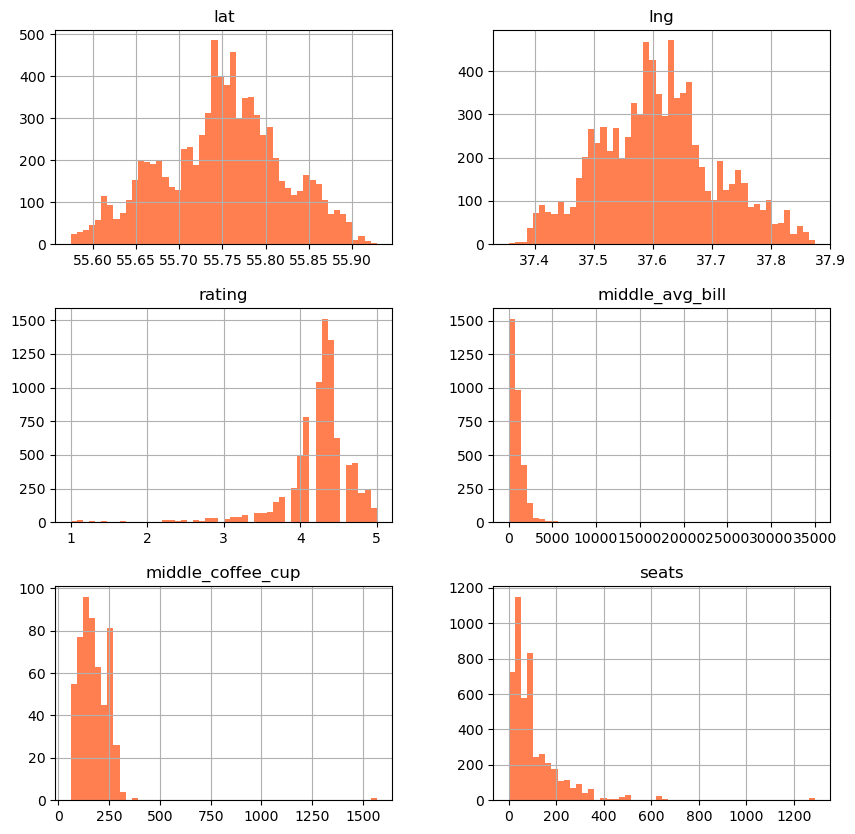

In [47]:
data.hist(figsize=(10, 10), bins=50, color='coral');
plt.show()

Графики помогли увидеть:
- все заведения, судя по координатам, действительно находятся в Москве;
- средние рейтинги находятся примерно между 4 и 5, но есть заведения и с очень низкими оценками - это не аномалии, просто плохие оценки; 
- показатели срдених цен смещены влево, то есть в сторону более дешевых, но это и закономерно; однако есть и очень дорогие заведения - судя и по чашке кофе и по среднему чеку. Это возможная аномалия;
- показатель мест также смещен влево - в сторону меньшего числа мест, это тоже закономерно. 



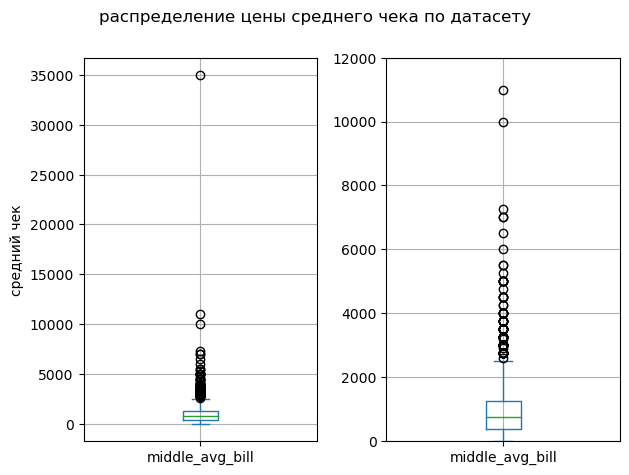

In [48]:
fig, axs = plt.subplots(1, 2)

plt.subplot(1, 2, 1)
data['middle_avg_bill'].plot(
    kind='box', 
    subplots=True, 
    figsize=(5,5),
    grid=True, 
    ylabel='средний чек'
);

plt.subplot(1, 2, 2)
data['middle_avg_bill'].plot(
    kind='box', 
    subplots=True, 
    figsize=(5,5),
    grid=True
)
plt.ylim(ymin=0, ymax = 12000)
plt.tight_layout()
fig.suptitle('распределение цены среднего чека по датасету') 
fig.subplots_adjust(top=0.88)
plt.show()


In [49]:
data.query('middle_avg_bill > 12000')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,unique_place
7177,Кафе,ресторан,"Москва, Каширское шоссе, 23, стр. 2",Южный административный округ,"ежедневно, круглосуточно",55.65745,37.646665,4.1,высокие,Средний счёт:20000–50000 ₽,35000.0,NaN,False,100.0,Каширское шоссе,True,"КафеМосква, Каширское шоссе, 23, стр. 2"


Вряд ли средний чек кафе на Каширском шоссе будет достигать 50000 тысяч. Вероятно, речь о 500 рублях. Заменим значения для этого заведения. 

In [50]:
data = (data.replace({"avg_bill": {"Средний счёт:20000–50000 ₽": "Средний счёт:200–500 ₽"}}))
data = (data.replace({"middle_avg_bill": {35000: 350}}))   
data.query('middle_avg_bill > 12000')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,unique_place


Можно устранить выбросы и по персентилям, но на данном этапе остановимся только на том, что убрали явный одну явную аномалию. 

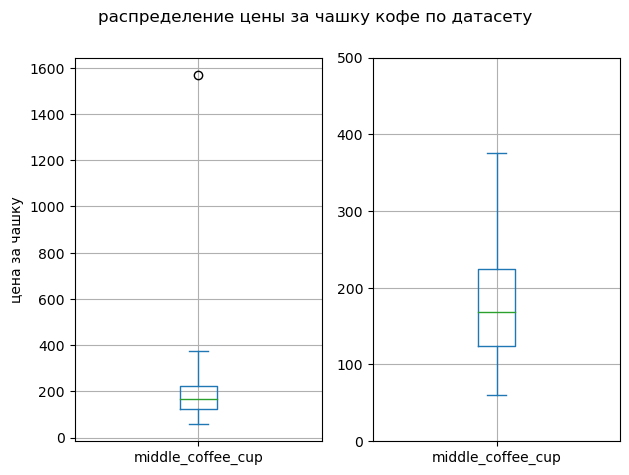

In [51]:
# middle coffee cup

fig, axs = plt.subplots(1, 2)

plt.subplot(1, 2, 1)
data['middle_coffee_cup'].plot(
    kind='box', 
    subplots=True, 
    figsize=(5,5),
    grid=True, 
    ylabel='цена за чашку'
);

plt.subplot(1, 2, 2)
data['middle_coffee_cup'].plot(
    kind='box', 
    subplots=True, 
    figsize=(5,5),
    grid=True
)
plt.ylim(ymin=0, ymax = 500)
plt.tight_layout()
fig.suptitle('распределение цены за чашку кофе по датасету') 
fig.subplots_adjust(top=0.88)
plt.show()


In [52]:
data.query('middle_coffee_cup > 1400')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,unique_place
2859,Шоколадница,кофейня,"Москва, Большая Семёновская улица, 27, корп. 1",Восточный административный округ,"ежедневно, 08:00–23:00",55.782268,37.709022,4.2,средние,Цена чашки капучино:230–2907 ₽,NaN,1568.0,True,48.0,Большая Семёновская улица,False,"ШоколадницаМосква, Большая Семёновская улица, ..."


Вероятно просто вкралась ошибка в значение `avg_bill` и спровоцировала ошибку в `middle_coffee_cup`.

In [53]:
mean_cup = np.mean([230, 290])

In [54]:
data = (data.replace({"avg_bill": {"Цена чашки капучино:230–2907 ₽": "Цена чашки капучино:230–290 ₽"}}))
data = (data.replace({"middle_coffee_cup": {1568.0: mean_cup}}))   
data.query('middle_coffee_cup > 1400')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,unique_place


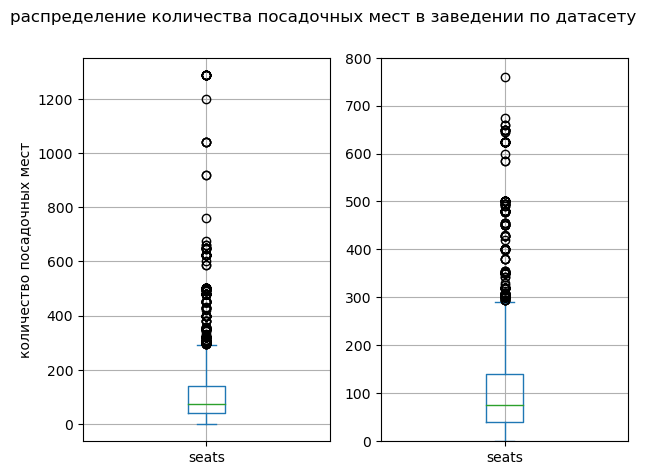

In [55]:
# seats

fig, axs = plt.subplots(1, 2)

plt.subplot(1, 2, 1)
data['seats'].plot(
    kind='box', 
    subplots=True, 
    figsize=(5,5),
    grid=True, 
    ylabel='количество посадочных мест'
);

plt.subplot(1, 2, 2)
data['seats'].plot(
    kind='box', 
    subplots=True, 
    figsize=(5,5),
    grid=True
)
plt.ylim(ymin=0, ymax = 800)
plt.tight_layout()
fig.suptitle('распределение количества посадочных мест в заведении по датасету') 
fig.subplots_adjust(top=0.88)
plt.show()

In [56]:
data.query('seats > 700').head(10)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,unique_place
2713,Ваня и Гоги,"бар,паб","Москва, Измайловское шоссе, 71, корп. А",Восточный административный округ,"ежедневно, 11:00–06:00",55.789842,37.750282,4.2,высокие,Средний счёт:1000–2500 ₽,1750.0,NaN,False,1040.0,Измайловское шоссе,False,"Ваня и ГогиМосква, Измайловское шоссе, 71, кор..."
2722,Маргарита,быстрое питание,"Москва, Измайловское шоссе, 71, корп. А",Восточный административный округ,"ежедневно, 10:00–22:00",55.789527,37.752004,4.3,unknown,unknown,NaN,NaN,True,1040.0,Измайловское шоссе,False,"МаргаритаМосква, Измайловское шоссе, 71, корп. А"
2770,Шоколадница,кофейня,"Москва, Измайловское шоссе, 71, корп. А",Восточный административный округ,"пн-ср 11:00–23:00; чт 11:00–00:00; пт,сб 11:00...",55.789903,37.749822,4.1,unknown,unknown,NaN,NaN,True,1040.0,Измайловское шоссе,False,"ШоколадницаМосква, Измайловское шоссе, 71, кор..."
2966,Матрешка,кафе,"Москва, Измайловское шоссе, 71, корп. А",Восточный административный округ,unknown,55.789867,37.749656,4.0,unknown,unknown,NaN,NaN,False,1040.0,Измайловское шоссе,False,"МатрешкаМосква, Измайловское шоссе, 71, корп. А"
4180,Eataly,"бар,паб","Москва, Киевская улица, 2",Западный административный округ,"ежедневно, 12:00–23:00",55.743405,37.562535,4.6,unknown,unknown,NaN,NaN,False,920.0,Киевская улица,False,"EatalyМосква, Киевская улица, 2"
4231,РестоБар Argomento,столовая,"Москва, Кутузовский проспект, 41, стр. 1",Западный административный округ,"ежедневно, 12:00–23:00",55.738237,37.531819,4.2,высокие,Средний счёт:2500–5000 ₽,3750.0,NaN,False,1200.0,Кутузовский проспект,False,"РестоБар ArgomentoМосква, Кутузовский проспект..."
4245,Стейк & Бургер,кафе,"Москва, Киевская улица, 2",Западный административный округ,"ежедневно, 09:00–21:00",55.742953,37.561872,4.2,unknown,unknown,NaN,NaN,True,920.0,Киевская улица,False,"Стейк & БургерМосква, Киевская улица, 2"
5486,Дом,кафе,"Москва, улица Юности, 1",Восточный административный округ,unknown,55.736204,37.815500,4.9,unknown,unknown,NaN,NaN,False,760.0,улица Юности,False,"ДомМосква, улица Юности, 1"
6518,DelonixCafe,ресторан,"Москва, проспект Вернадского, 94, корп. 1",Западный административный округ,"ежедневно, круглосуточно",55.652577,37.475730,4.1,высокие,Средний счёт:1500–2000 ₽,1750.0,NaN,False,1288.0,проспект Вернадского,True,"DelonixCafeМосква, проспект Вернадского, 94, к..."
6524,Ян Примус,ресторан,"Москва, проспект Вернадского, 121, корп. 1",Западный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.657166,37.481519,4.5,выше среднего,Средний счёт:1500 ₽,1500.0,NaN,True,1288.0,проспект Вернадского,False,"Ян ПримусМосква, проспект Вернадского, 121, ко..."


Явно что-то не так. Одинаковое количество мест для разных заведений, а так же идентичный адрес говорит о том, что мы имеем дело с фудкортами или фудмоллами. Теоретически, посетители одного кафе, конечно могут занять все места на фудкорте, но так не бывает. Учтем это при дальнейшем анализе - например, сделаем срез без фудкортов, но на данном этапе устранять аномалию не будем.

---

In [57]:
display(data.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8403 entries, 0 to 8405
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8403 non-null   object 
 1   category           8403 non-null   object 
 2   address            8403 non-null   object 
 3   district           8403 non-null   object 
 4   hours              8403 non-null   object 
 5   lat                8403 non-null   float64
 6   lng                8403 non-null   float64
 7   rating             8403 non-null   float64
 8   price              8403 non-null   object 
 9   avg_bill           8403 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8403 non-null   bool   
 13  seats              4792 non-null   float64
 14  street             8403 non-null   object 
 15  is_24/7            8403 non-null   bool   
 16  unique_place       8403 

None

---

### Промежуточные итоги

Мы открыли датасет и сохранили в переменную `data`. Всего в нем 8403 заведений. Мы устранили множественные неявные дубликаты в колонке `name`, выполнили проверку на дубликаты и в других столбцах. Добавили к данным три столбца - `street` - название улицы или другого объекта на карте, где расположено заведение; и `is_24/7` - индикатор, является ли заведение круглосуточным семь дней в неделю; `unique_place` - столбец для быстрого нахождения уникальных заведений по адресу и названию. Где было возможно мы устранили пропуски в часах работы (55 сетевых заведений) и категории цен (470 пропусков) - там где восстановить данные было нельзя - поставили заглушку 'unknown'; в среднем чеке также поставили заглушку 'unknown' для пропусков. Столбец `chain` мы перевели в булев тип. 

Также мы обнаружили одну аномалию в столбце `middle_avg_bill` и сразу же исправили. Также устранили одну аномалию в столбце `middle_coffee_cup`. Кроме того, мы заметили, что в столбце с количеством посадочных мест большое число "выбросов" (больше 300 мест в заведении). Наше предположение: причина аномалии состоит в том, что некотоыре заведения расположены в фудкортах или фудмоллах, и для них отображается полное количество мест в той или иной локаци. Это подстверждает одинаковое число мест для разных заведений и одинаковый адрес заведений. Пока мы не устраняли эту аномалию. 

---

## Исследовательский анализ данных


### Категории заведений

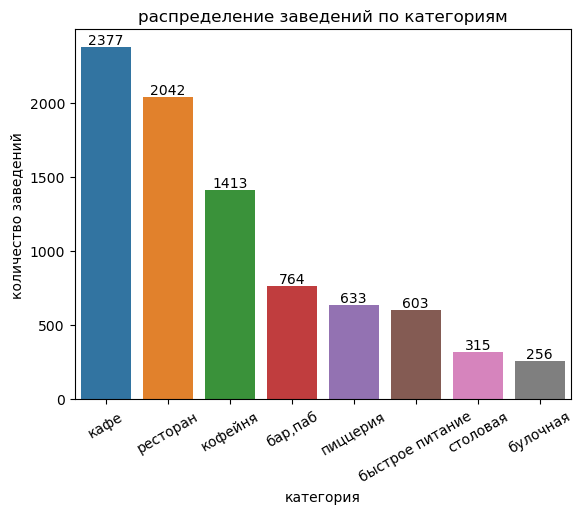

In [58]:
categories = (
    data
    .pivot_table(index='category', values='lat', aggfunc='count')
    .reset_index()
    .sort_values(by='lat', ascending=False)
)

ax = sns.barplot(x='category',
                 y='lat',
                 data=categories)
ax.set_title('распределение заведений по категориям')
ax.set(xlabel='категория', ylabel='количество заведений')
ax.bar_label(ax.containers[0])
plt.xticks(rotation=30);

Кафе и рестораны занимают больше половины заведений. Кофеен почти в два раза больше, чем баров, пиццерий и заведений быстрого питания. Не более 4% занимают столовые и булочные.

---

### Посадочные места

В предыдущей части мы увидели, что значениях количества мест присутсвуют экстермально большие числа. 

Можно проверить, сгруппировав по одинаковым количествам мест, отобразив количество уникальных адресов и названий. Если на один адрес придется несколько названий, то заведения находятся в одном помещении. 

In [59]:
# группировка

(
    data
    .pivot_table(index='seats', values=('name','address'), aggfunc=('nunique'))
    .reset_index()
    .sort_values('name', ascending=False)
).query('seats > 300').head(10)

,seats,address,name
201,350.0,30,55
197,320.0,14,32
219,625.0,14,23
216,500.0,6,21
212,480.0,8,13
228,1288.0,6,11
205,400.0,2,10
193,306.0,1,8
221,650.0,5,6
215,495.0,1,6


In [60]:
# посмотрим на самое поплуярное число мест

data.query('seats == 350')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,unique_place
127,Арарат,кафе,"Москва, Дмитровское шоссе, 165, корп. 1",Северо-Восточный административный округ,"ежедневно, 06:00–20:00",55.914310,37.538953,4.2,unknown,unknown,NaN,NaN,True,350.0,Дмитровское шоссе,False,"АраратМосква, Дмитровское шоссе, 165, корп. 1"
171,One Price Coffee,кофейня,"Москва, Дмитровское шоссе, 163А, корп. 1",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.909838,37.541526,4.0,unknown,unknown,NaN,NaN,True,350.0,Дмитровское шоссе,False,"One Price CoffeeМосква, Дмитровское шоссе, 163..."
176,Вуди пицца,пиццерия,"Москва, Дмитровское шоссе, 107А, корп. 1",Северный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.878504,37.540110,4.0,средние,Средний счёт:400–600 ₽,500.0,NaN,False,350.0,Дмитровское шоссе,False,"Вуди пиццаМосква, Дмитровское шоссе, 107А, кор..."
194,Ленкорань,кафе,"Москва, Дмитровское шоссе, 165, корп. 1",Северо-Восточный административный округ,"ежедневно, 06:00–20:00",55.914574,37.539103,1.4,unknown,unknown,NaN,NaN,False,350.0,Дмитровское шоссе,False,"ЛенкораньМосква, Дмитровское шоссе, 165, корп. 1"
216,Грузинский бульвар,быстрое питание,"Москва, Дмитровское шоссе, 163А, корп. 1",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.909115,37.540112,4.0,unknown,unknown,NaN,NaN,False,350.0,Дмитровское шоссе,False,"Грузинский бульварМосква, Дмитровское шоссе, 1..."
676,Эскалоп,пиццерия,"Москва, Дмитровское шоссе, 48, корп. 1",Северный административный округ,пн-сб 11:00–22:00,55.845090,37.570305,4.3,средние,Средний счёт:300–1000 ₽,650.0,NaN,False,350.0,Дмитровское шоссе,False,"ЭскалопМосква, Дмитровское шоссе, 48, корп. 1"
680,Сундук,ресторан,"Москва, Дмитровское шоссе, 46, корп. 1",Северный административный округ,"ежедневно, 10:00–23:00",55.844415,37.570272,4.3,средние,Средний счёт:500–1000 ₽,750.0,NaN,True,350.0,Дмитровское шоссе,False,"СундукМосква, Дмитровское шоссе, 46, корп. 1"
681,Сады Семирамиды,ресторан,"Москва, Дмитровское шоссе, 53, корп. 1",Северный административный округ,"пн-чт 11:00–00:00; пт,сб 11:00–01:00; вс 11:00...",55.843005,37.568729,4.4,высокие,Средний счёт:2000–3000 ₽,2500.0,NaN,False,350.0,Дмитровское шоссе,False,"Сады СемирамидыМосква, Дмитровское шоссе, 53, ..."
690,Семейный ресторан Boobo,"бар,паб","Москва, Дмитровское шоссе, 73, стр. 1",Северный административный округ,"пн-чт 11:00–23:00; пт,сб 11:00–05:00; вс 11:00...",55.857159,37.558842,4.4,высокие,Средний счёт:1500–2000 ₽,1750.0,NaN,False,350.0,Дмитровское шоссе,False,"Семейный ресторан BooboМосква, Дмитровское шос..."
742,Калина,кафе,"Москва, Дмитровское шоссе, 46, корп. 1",Северный административный округ,"ежедневно, 08:00–22:30",55.843843,37.569952,4.0,unknown,unknown,NaN,NaN,True,350.0,Дмитровское шоссе,False,"КалинаМосква, Дмитровское шоссе, 46, корп. 1"


Наша гипотеза подтвердилась лишь частично - где-то действительно несколько заведений по одному адресу (но это тоже не 100% гарантия того, что они под одной крышей), а где-то просто совпадает число мест. 

Не будем ничего с этим делать, но для наглядности построим полные распределения и с ограничением по оси x.

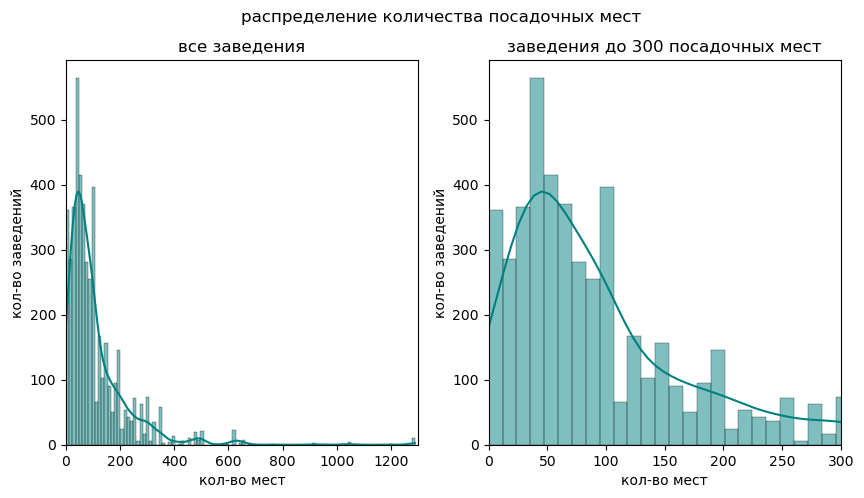

In [61]:
# гистограмма для всего датасета (с ограничением и без)

fig = plt.figure(figsize=(10, 5))

ax1 = plt.subplot(1, 2, 1)
sns.histplot(x='seats', data=data, kde=True, color='teal')
plt.xlim(0, 1300)
plt.xlabel('кол-во мест')
plt.ylabel('кол-во заведений')
plt.title('все заведения')

ax2 = plt.subplot(1, 2, 2)
sns.histplot(x='seats', data=data, kde=True, color='teal')
plt.xlim(0, 300)
plt.xlabel('кол-во мест')
plt.ylabel('кол-во заведений');
plt.title('заведения до 300 посадочных мест')

fig.suptitle('распределение количества посадочных мест');

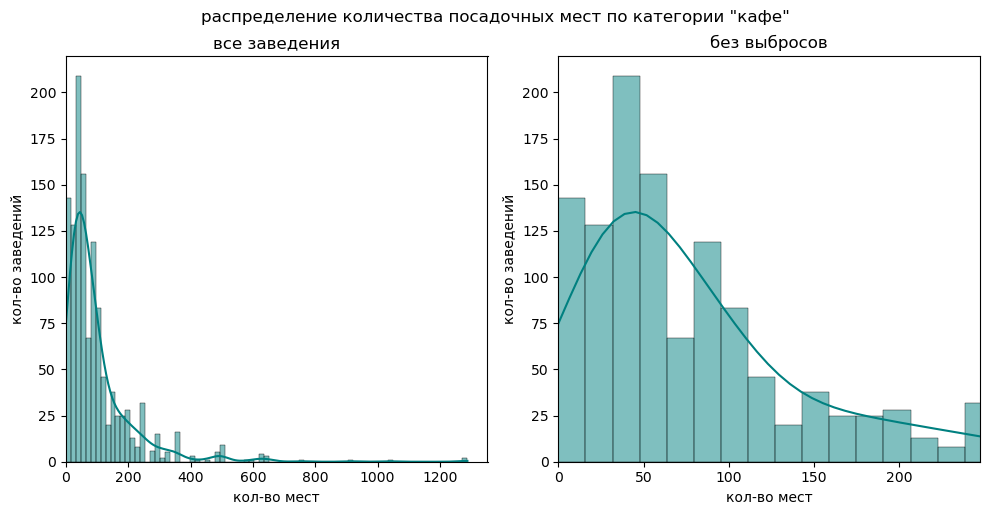

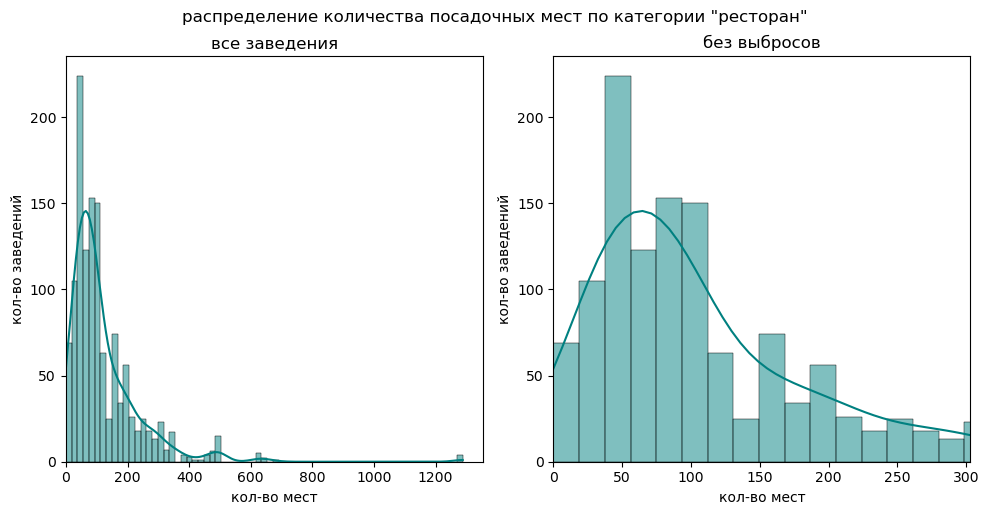

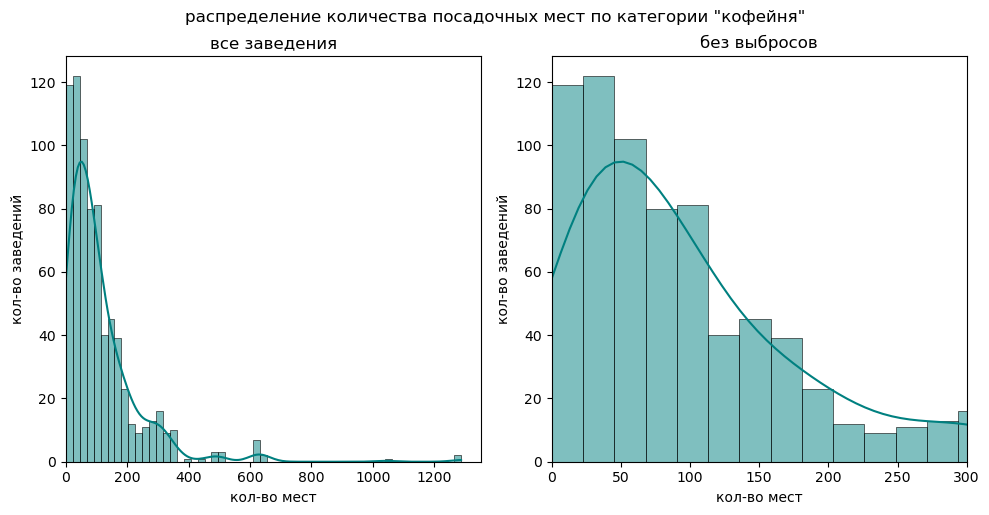

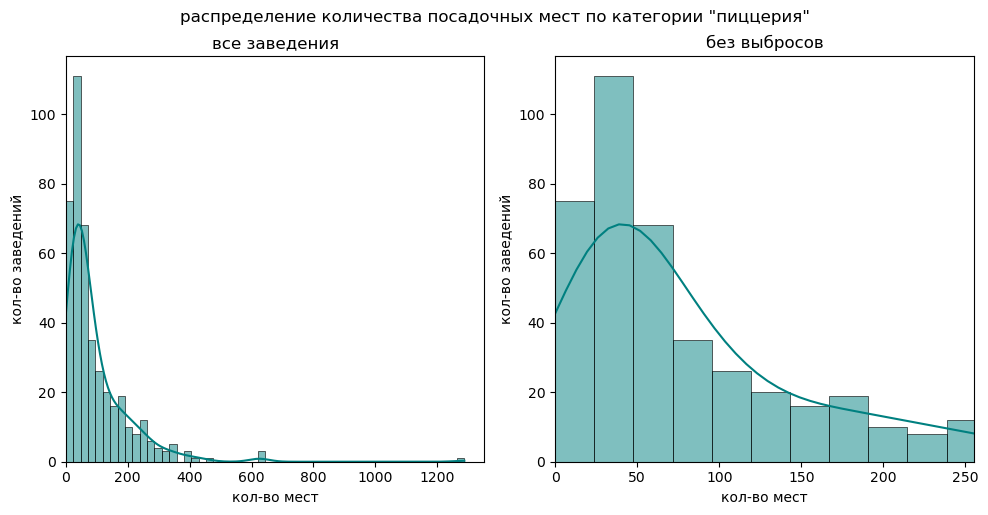

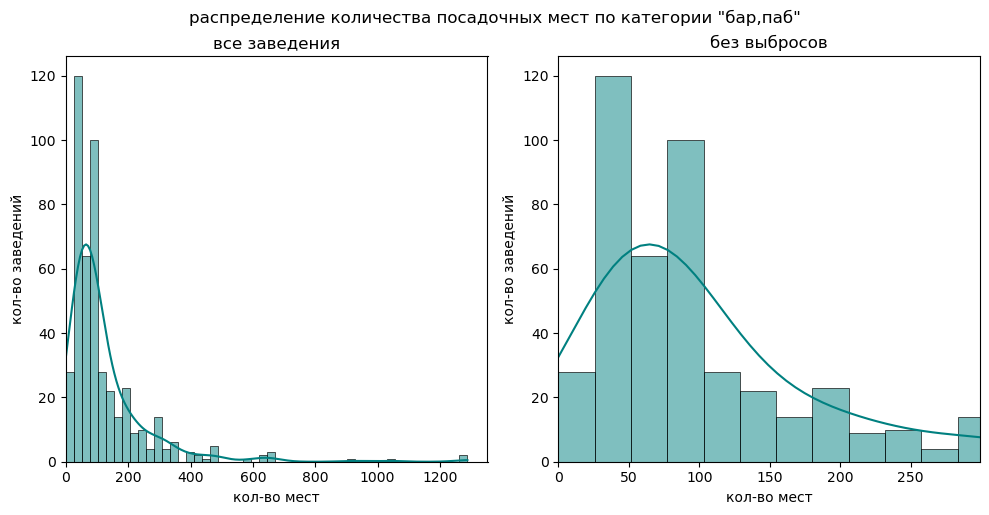

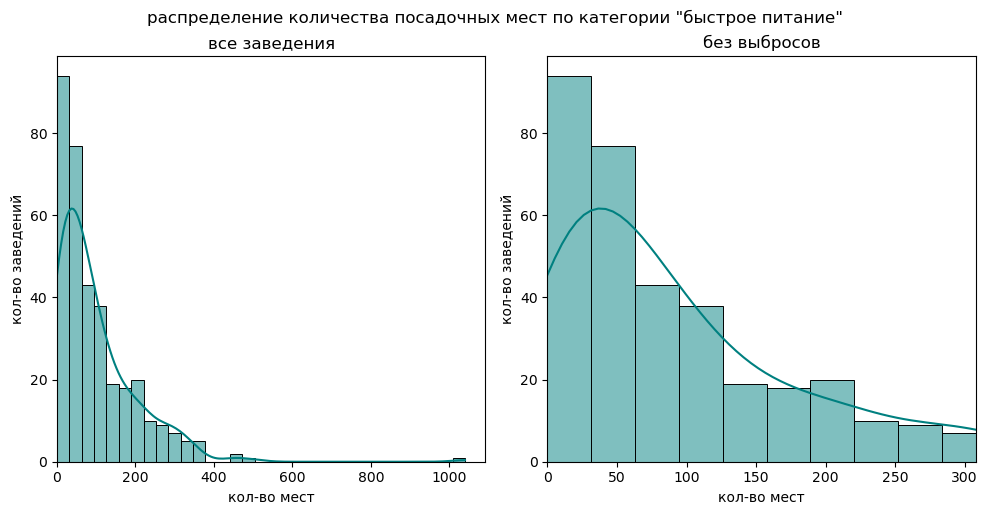

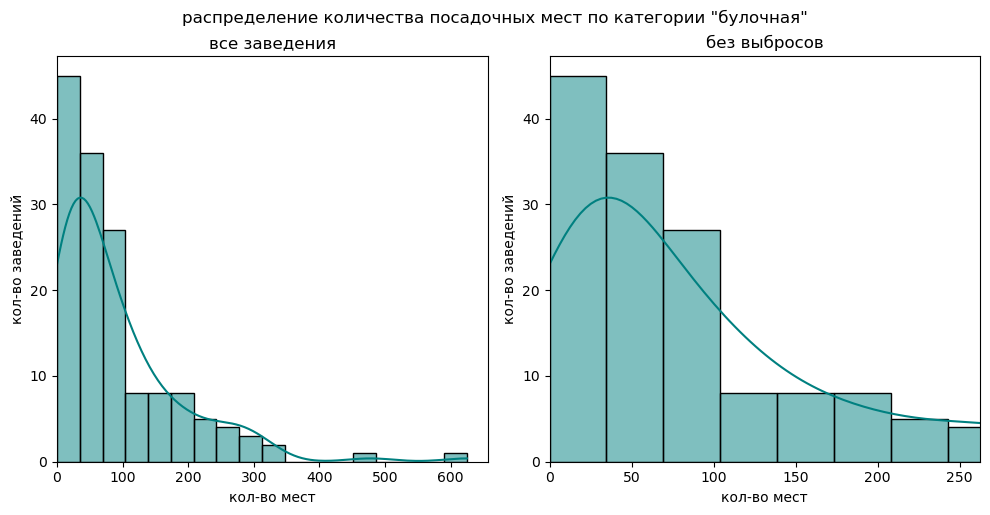

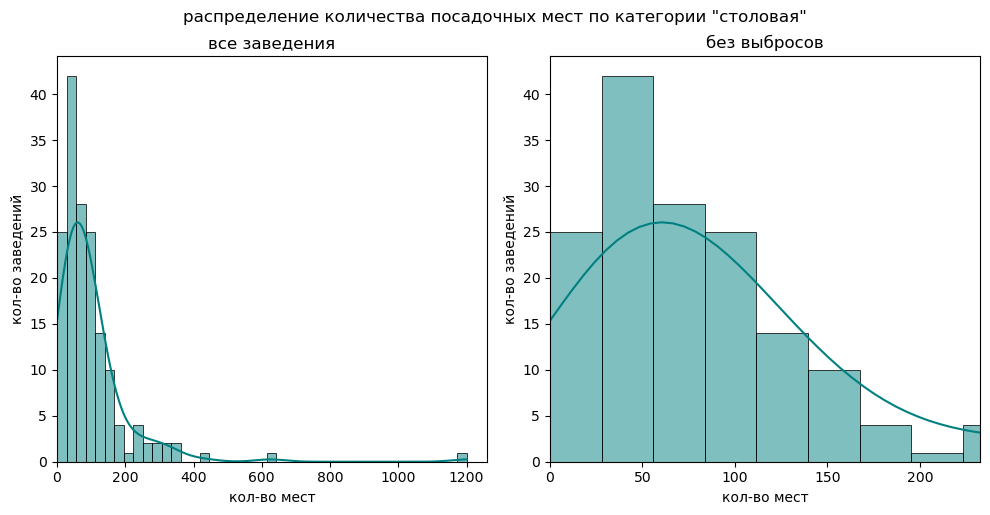

In [62]:
# строим в разрезе по категориям

categories_list = list(data['category'].unique())

for cat in categories_list:
    
    #считаем 1.5 интерквартильного размаха, чтобы убрать выбросы
    array = np.array(list(data.loc[((data['category'] == cat) == True) \
                                   & (data['seats'].isnull() == False)]['seats']))
    q3, q1 = np.percentile(array, [75 ,25])
    iqr = q3 - q1    
    upper = q3 + 1.5 * iqr # нам понадобится только верхняя граница, потому что нижняя везде будет 0
    
    fig = plt.figure(figsize=(10, 5))

    ax1 = plt.subplot(1, 2, 1)
    sns.histplot(x='seats', data=data.query('category == @cat'), kde=True, color='teal')
    plt.xlim(0,)
    plt.xlabel('кол-во мест')
    plt.ylabel('кол-во заведений')
    plt.title('все заведения')

    ax2 = plt.subplot(1, 2, 2)
    sns.histplot(x='seats', data=data.query('category == @cat'), kde=True, color='teal')
    plt.xlim(0, upper)
    plt.xlabel('кол-во мест')
    plt.ylabel('кол-во заведений');
    plt.title('без выбросов')
    
    plt.tight_layout()
    plt.suptitle('распределение количества посадочных мест по категории "{}"'.format(cat), y=1.02);


Взглянем на статистики количества мест для полных данных и в разбивке по категориям и только внутри "нормальных" значений. 

In [63]:
categories_list = list(data['category'].unique())

means = []
medians = []
    
for cat in categories_list:
    
    
    array = np.array(list(data.loc[((data['category'] == cat) == True) \
                               & (data['seats'].isnull() == False)]['seats']))
    
    q3, q1 = np.percentile(array, [75 ,25])
    iqr = q3 - q1    
    upper = q3 + 1.5 * iqr
    lower = q1 - 1.5 * iqr
    filtered = np.array(list(data.loc[((data['category'] == cat) == True) \
                               & (data['seats'].isnull() == False) \
                               & ((data['seats'] > lower) \
                               & (data['seats'] < upper))]['seats']))
    
    means.append(round(np.mean(filtered), 1))
    medians.append(np.median(filtered))
    
    print(f'среднее количество мест в категории {cat}: {round(np.mean(filtered), 1)}')
    print(f'медианное количество мест в категории {cat}: {np.median(filtered)}')          
    print(' ')

среднее количество мест в категории кафе: 71.0
медианное количество мест в категории кафе: 50.0
 
среднее количество мест в категории ресторан: 99.3
медианное количество мест в категории ресторан: 80.0
 
среднее количество мест в категории кофейня: 85.7
медианное количество мест в категории кофейня: 70.0
 
среднее количество мест в категории пиццерия: 73.9
медианное количество мест в категории пиццерия: 50.0
 
среднее количество мест в категории бар,паб: 88.8
медианное количество мест в категории бар,паб: 77.0
 
среднее количество мест в категории быстрое питание: 85.7
медианное количество мест в категории быстрое питание: 60.0
 
среднее количество мест в категории булочная: 69.3
медианное количество мест в категории булочная: 48.0
 
среднее количество мест в категории столовая: 73.8
медианное количество мест в категории столовая: 60.0
 


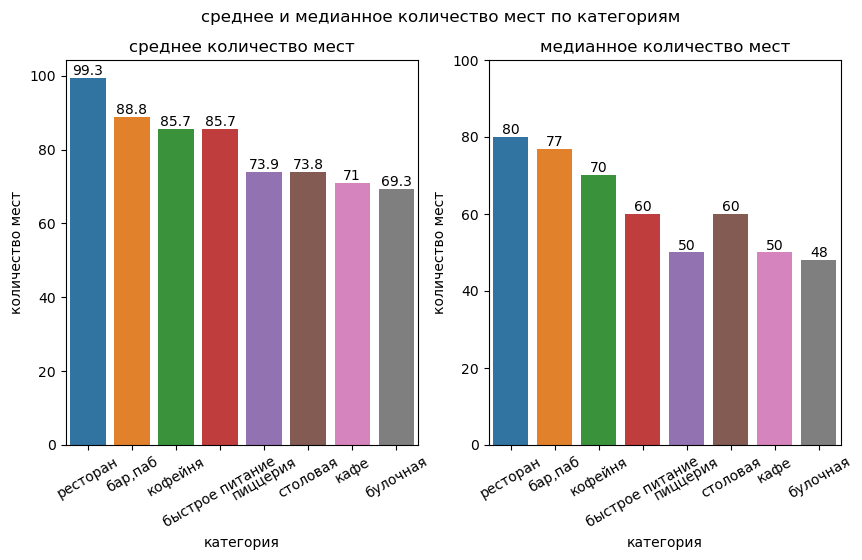

In [64]:
category_df = {'category':categories_list,'means':means,'medians':medians}
category_df = pd.DataFrame(category_df).sort_values(by='means', ascending=False)
category_df


fig = plt.figure(figsize=(10, 5))

ax1 = plt.subplot(1, 2, 1)
ax = sns.barplot(x='category',
                 y='means',
                 data=category_df)
ax.set_title('среднее количество мест')
ax.set(xlabel='категория', ylabel='количество мест')
ax.bar_label(ax.containers[0])
plt.xticks(rotation=30)

ax2 = plt.subplot(1, 2, 2)
ax = sns.barplot(x='category',
                 y='medians',
                 data=category_df)
ax.set_title('медианное количество мест')
ax.set(xlabel='категория', ylabel='количество мест')
ax.bar_label(ax.containers[0])
ax.set(ylim=(0, 100))
plt.xticks(rotation=30)

fig.suptitle('среднее и медианное количество мест по категориям');

Можно заключить, что в основном нормальные значения количества мест для кафе заканчиваются в районе значения 200-300. Среднее количество мест для разных категорий варьируется от 69 до 99, а медианное от 48 до 80. Так, в среденем бизнесу можно ориентироваться на 50-100 посадочных мест. 

Рестораны и бары вмещают в среднем около 100 человек. Меньше всего мест в булочных - 60.

### Сетевые завдения 
- соотношение сетевых и несетвых заведений;
- заведения каких категорий чаще являются сетевыми;
- топ самых больших сетей.

#### Соотношение сетевых и несетвых заведений

In [65]:
number_of_places_in_chains = data.pivot_table(index='chain', values='unique_place', aggfunc='count').reset_index()

number_of_places_in_chains['percent'] = (
    round(number_of_places_in_chains['unique_place'] / sum(number_of_places_in_chains['unique_place']) * 100, 1)
                                                    )

number_of_places_in_chains = (
                                number_of_places_in_chains.replace(
                                    {"chain": 
                                    {True: "chain",
                                     False: "not chain"}
                                    }
                                )
)
number_of_places_in_chains

,chain,unique_place,percent
0,not chain,5314,63.2
1,chain,3089,36.8


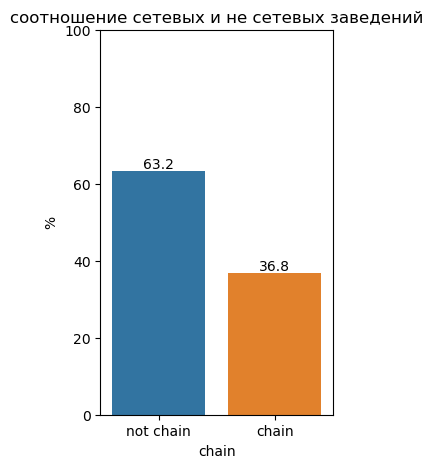

In [66]:
fig = plt.figure(figsize=(3, 5))

ax = sns.barplot(x='chain',
                 y='percent',
                 data=number_of_places_in_chains)
ax.set_title('соотношение сетевых и не сетевых заведений')
ax.set(ylabel='%')
ax.bar_label(ax.containers[0])
ax.set(ylim=(0, 100));

Количество заведений, не входящих в сети примерно в 1.7 раз больше, чем входящих. 

Входит в сети 3089 заведений; не входит - 5314.

#### Заведения каких категорий чаще являются сетевыми

In [67]:
chains = (
    data
    .query('chain == True').pivot_table(index = 'category', values='unique_place', aggfunc='count')
    .reset_index()
    .sort_values('unique_place', ascending=False)
)
chains

,category,unique_place
4,кофейня,731
6,ресторан,711
3,кафе,701
5,пиццерия,344
2,быстрое питание,193
0,"бар,паб",165
1,булочная,152
7,столовая,92


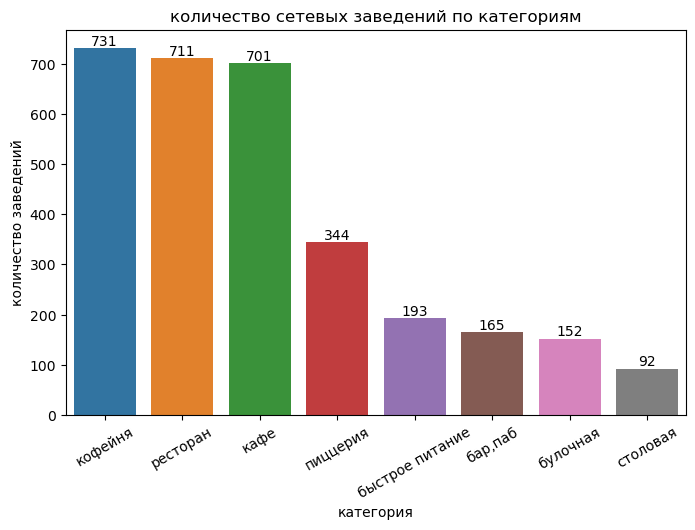

In [68]:
fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='category',
                 y='unique_place',
                 data=chains)
ax.set_title('количество сетевых заведений по категориям')
ax.set(xlabel='категория')
ax.set(ylabel='количество заведений')
ax.bar_label(ax.containers[0])
plt.xticks(rotation=30);

В сети кофеен, ресторанов и кафе входит примерно по 700 заведений. В пиццерии - меньше более чем в два раза - 344; В быстром питании, булочных и барах - от 150 до 190 заведений. Столовых меньше всего - 92.

In [69]:
categories = (
    data
    .pivot_table(index = 'category', values='unique_place', aggfunc='count')
    .reset_index()
    .sort_values('unique_place', ascending=False)
)

chains = categories.merge(chains, on='category')
chains['percent'] = round(chains['unique_place_y'] / chains['unique_place_x'] * 100, 2)
chains

,category,unique_place_x,unique_place_y,percent
0,кафе,2377,701,29.49
1,ресторан,2042,711,34.82
2,кофейня,1413,731,51.73
3,"бар,паб",764,165,21.60
4,пиццерия,633,344,54.34
5,быстрое питание,603,193,32.01
6,столовая,315,92,29.21
7,булочная,256,152,59.38


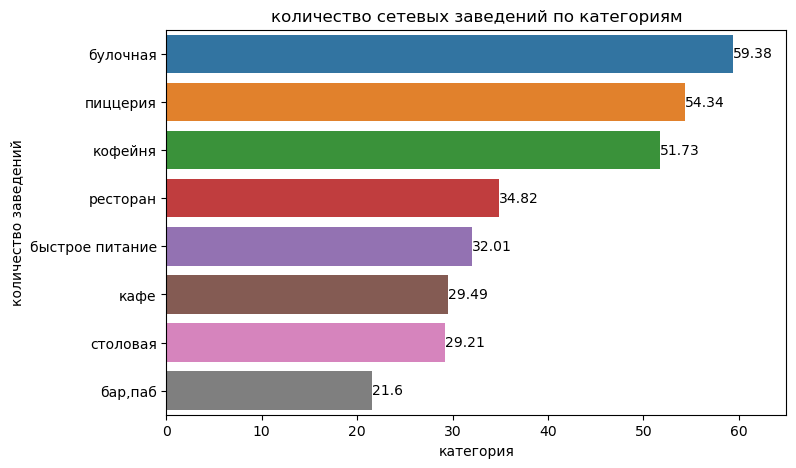

In [70]:
chains = chains.sort_values('percent', ascending=False)

fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='percent',
                 y='category',
                 data=chains)
ax.set_title('количество сетевых заведений по категориям')
ax.set(xlabel='категория')
ax.set(ylabel='количество заведений')
ax.set(xlim=(0, 65))
ax.bar_label(ax.containers[0]);

Самый большой процент сетевых заведений среди булочных (59%), пиццерий(54%) и кофеен (52%). Меньше всего сетевых баров (22%). Сетевых заведений среди столовых и кафе - около 29%, а среди ресторанов и быстрого питания - от 32% до 34%. 

#### Топ-15 сетей

In [71]:
top_chains = (
    data
    .query('chain == True').pivot_table(index = ('name', 'category'), values='unique_place', aggfunc='count')
    .reset_index()
    .sort_values('unique_place', ascending=False)
)
top_15_chains = top_chains.head(15)
top_15_chains

,name,category,unique_place
1118,Шоколадница,кофейня,119
516,Домино'с Пицца,пиццерия,77
514,Додо Пицца,пиццерия,74
219,One Price Coffee,кофейня,72
1134,Яндекс Лавка,ресторан,72
72,Cofix,кофейня,65
259,Prime,ресторан,49
561,КОФЕПОРТ,кофейня,42
627,Кулинарная лавка братьев Караваевых,кафе,39
960,Теремок,ресторан,36


In [72]:
(
    top_15_chains
    .pivot_table(index='category', values='name', aggfunc='count')
    .reset_index()
    .sort_values(by='name', ascending=False)
)

,category,name
2,кофейня,7
4,ресторан,3
1,кафе,2
3,пиццерия,2
0,булочная,1


Почти половина сетей в топ-15 по количеству заведений - кофейни. В топ-15 не попали бары, столовые и быстрое питание. Судя по всему, датасет нет учитывает многие рестораны быстрого питания, которые есть в москве (типа KFC или Burger King).

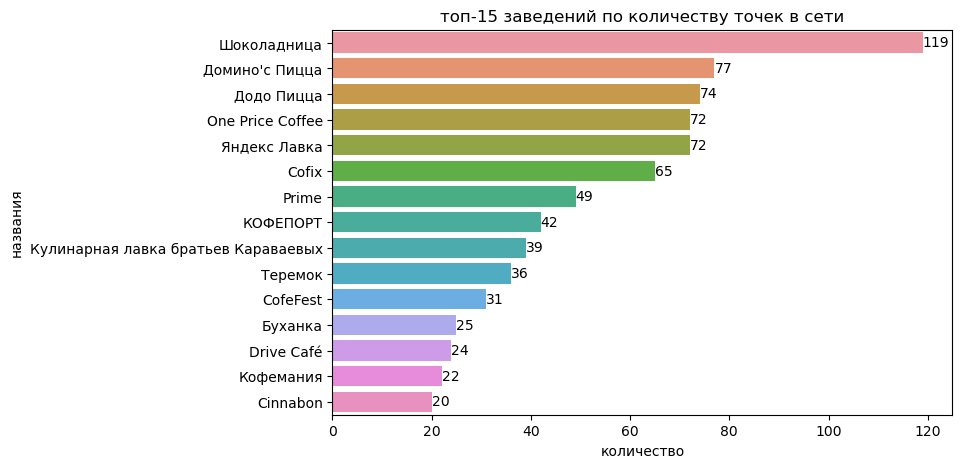

In [73]:
fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='unique_place',
                 y='name',
                 data=top_15_chains)
ax.set_title('топ-15 заведений по количеству точек в сети')
ax.set(xlabel='количество')
ax.set(ylabel='названия')
ax.bar_label(ax.containers[0]);

По количеству заведений уверенно лидирует сеть Шоколадница. Единсвтенные две сети пиццерий из топ-15 расположились на втором и третьем местах. 

---

Топ-15 сетей по среднему рейтингу

In [74]:
top_chains_rate = (
    data
    .query('chain == True').pivot_table(index = ('name', 'category'), values='rating', aggfunc='mean')
    .reset_index()
    .sort_values('rating', ascending=False)
)
top_chains_rate.query('rating > 4.8')

,name,category,rating
698,Маяк,ресторан,5.00
679,Маковка,кофейня,5.00
566,Как Дома,кафе,5.00
654,Летняя веранда,кафе,5.00
890,Свидание на крыше,кафе,5.00
543,Здрасте,кафе,4.90
558,Искра,"бар,паб",4.90
593,Ком 1989,кафе,4.90
90,Drive,кафе,4.90
596,Кондитерская Олега Ильина,ресторан,4.90


---

### Распределение заведений по районам

In [75]:
districts_points = (
    data.pivot_table(index='district', values='unique_place', aggfunc='count')
    .sort_values(by='unique_place', ascending=False)
    .reset_index()
)
districts_points['percent'] = (
    round(districts_points['unique_place'] / sum(districts_points['unique_place']) * 100, 1)
)
districts_points

,district,unique_place,percent
0,Центральный административный округ,2242,26.7
1,Северный административный округ,899,10.7
2,Южный административный округ,892,10.6
3,Северо-Восточный административный округ,890,10.6
4,Западный административный округ,850,10.1
5,Восточный административный округ,798,9.5
6,Юго-Восточный административный округ,714,8.5
7,Юго-Западный административный округ,709,8.4
8,Северо-Западный административный округ,409,4.9


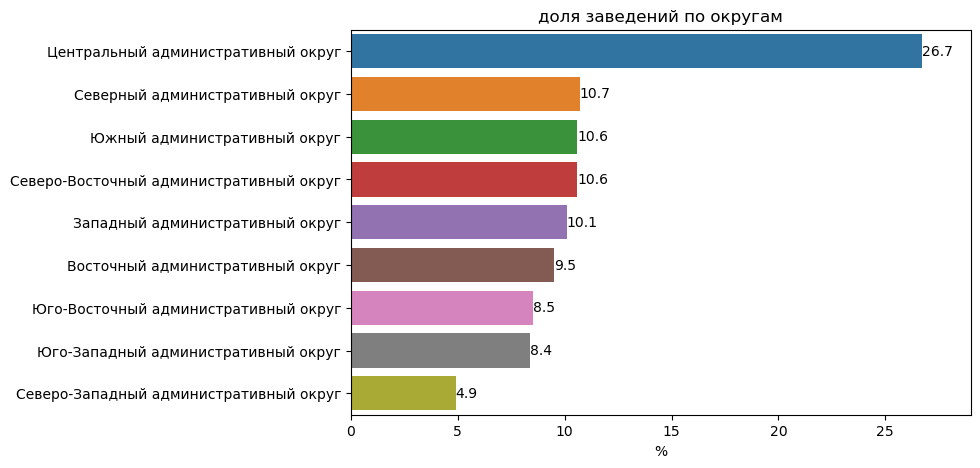

In [76]:
fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='percent',
                 y='district',
                 data=districts_points)
ax.set_title('доля заведений по округам')
ax.set(xlabel='%')
ax.set(ylabel='')
ax.set(xlim=(0, 29))
ax.bar_label(ax.containers[0]);

Заведения в ЦАО занимают больше четверти датасета. 

Меньше всего в СЗАО - около 5%. 
Остальные районы различаются несильно - от 8% до 11% от общего числа. 

<Figure size 800x500 with 0 Axes>

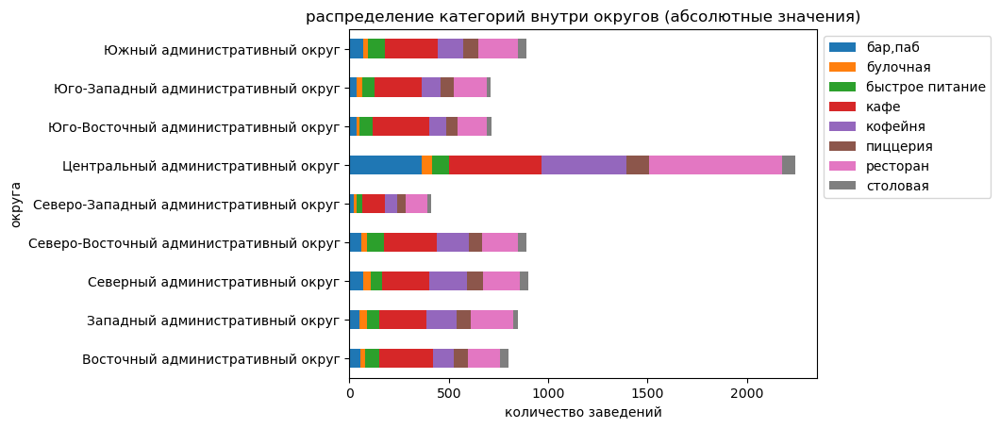

In [77]:
all_districts = (
    data
    .pivot_table(index='district', columns='category', values='unique_place', aggfunc='nunique')
)

fig = plt.figure(figsize=(8, 5))
ax = (
    all_districts
    .plot(
        kind = 'barh', 
        stacked=True, 
        title='распределение категорий внутри округов (абсолютные значения)')
)

plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
ax.set(ylabel='округа')
ax.set(xlabel='количество заведений')
plt.show();

<Figure size 800x500 with 0 Axes>

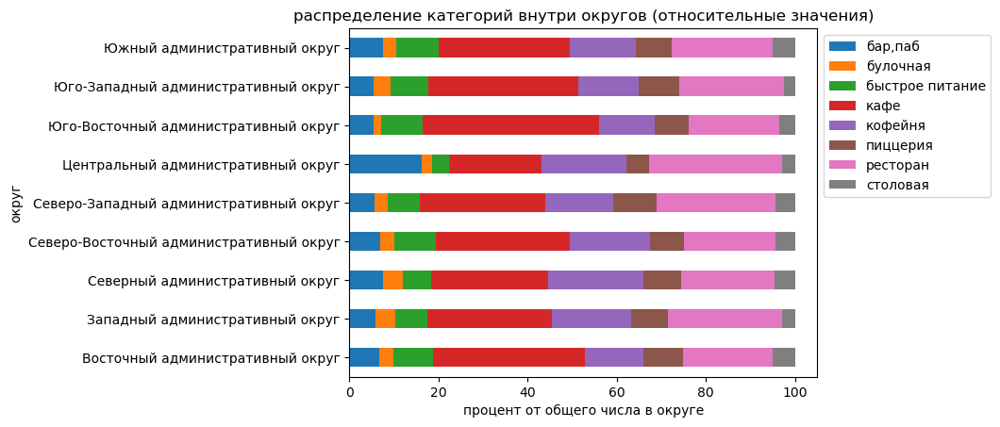

In [78]:
all_districts_share = (
    round(data.groupby(['district', 'category'])['unique_place'].count()/
    data.groupby(['district'])['category'].count() * 100, 2)
)
all_districts_share = pd.DataFrame(all_districts_share.unstack())


fig = plt.figure(figsize=(8, 5))
ax = (
    all_districts_share
    .plot(kind = 'barh', stacked=True, title='распределение категорий внутри округов (относительные значения)')
)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
ax.set(ylabel='округ')
ax.set(xlabel='процент от общего числа в округе')
plt.show();

По относительным показателям видно, что в центральном округе, например, больше баров и ресторанов, чем в остальных. Обычных кафе больше в Юго-Восточном и Восточном округах. В этих же округах чуть меньше кофеен, чем в других. Также в центральном округе меньше всего булочных и пиццерий (по сравнению с другими заведениями в округе).

---

### Распределение средних рейтингов по категориям заведений

In [79]:
rating_by_category = (
    data.pivot_table(index='category', values='rating', aggfunc='mean')
    .round(2)
    .reset_index()
    .sort_values(by='rating', ascending=False)
)
rating_by_category

,category,rating
0,"бар,паб",4.39
5,пиццерия,4.30
6,ресторан,4.29
4,кофейня,4.28
1,булочная,4.27
7,столовая,4.21
3,кафе,4.12
2,быстрое питание,4.05


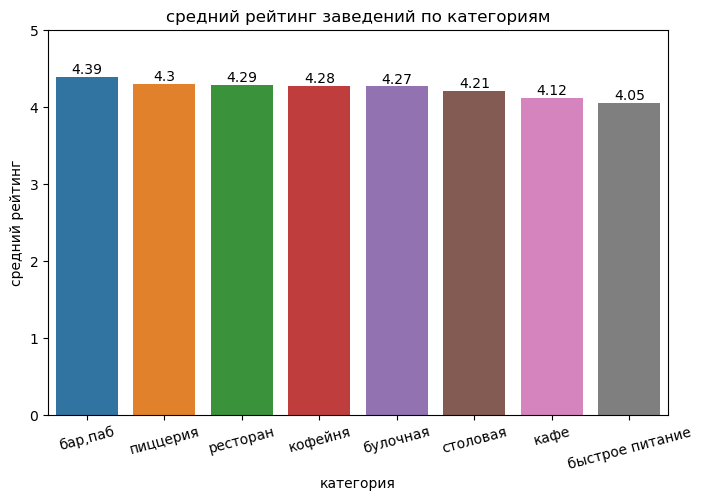

In [80]:
fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='category',
                 y='rating',
                 data=rating_by_category)
ax.set_title('средний рейтинг заведений по категориям')
ax.set(xlabel='категория')
ax.set(ylabel='средний рейтинг')
ax.bar_label(ax.containers[0])
plt.ylim(0, 5)
plt.xticks(rotation=15);

В среднем рейтинги очень похожи. И не опускаются ниже четырех. Выше всего - у баров - 4.39, а ниже всего у быстрого питания - 4.05

---

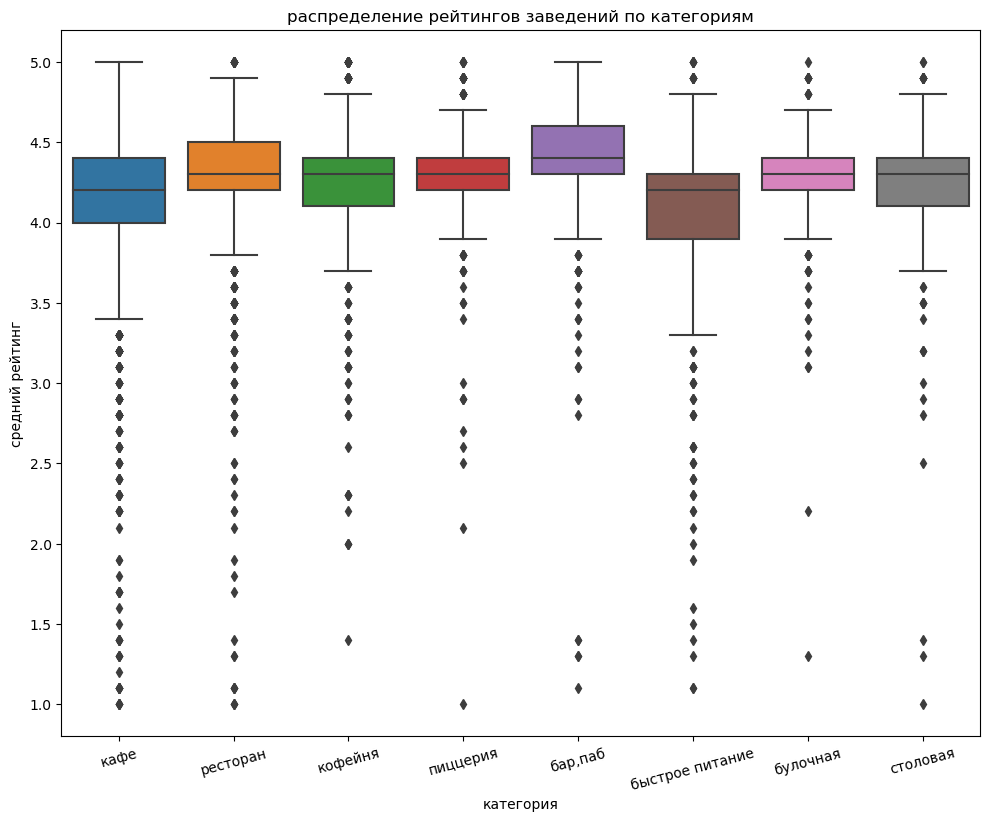

In [81]:
fig = plt.figure(figsize=(10, 8))
ax = sns.boxplot(data=data, x='category', y='rating')
ax.set_title('распределение рейтингов заведений по категориям')
ax.set(xlabel='категория')
ax.set(ylabel='средний рейтинг')
plt.tight_layout()
plt.xticks(rotation=15);

Видим, что "нормальные значения могут быть и ниже 3.5. В целом можно подтвердить выводы, что рейтинги похожи, но можно лучше разглядеть лидеров (рестораны и бары) и аутсайдеров (кафе и быстрое питание).

---

### Средние рейтинги каждого округа

In [82]:
rating_by_district = (
    data.pivot_table(index='district', values='rating', aggfunc='mean')
    .round(2)
    .reset_index()
    .sort_values(by='rating', ascending=False)
)
rating_by_district

,district,rating
5,Центральный административный округ,4.38
2,Северный административный округ,4.24
4,Северо-Западный административный округ,4.21
1,Западный административный округ,4.18
8,Южный административный округ,4.18
0,Восточный административный округ,4.17
7,Юго-Западный административный округ,4.17
3,Северо-Восточный административный округ,4.15
6,Юго-Восточный административный округ,4.10


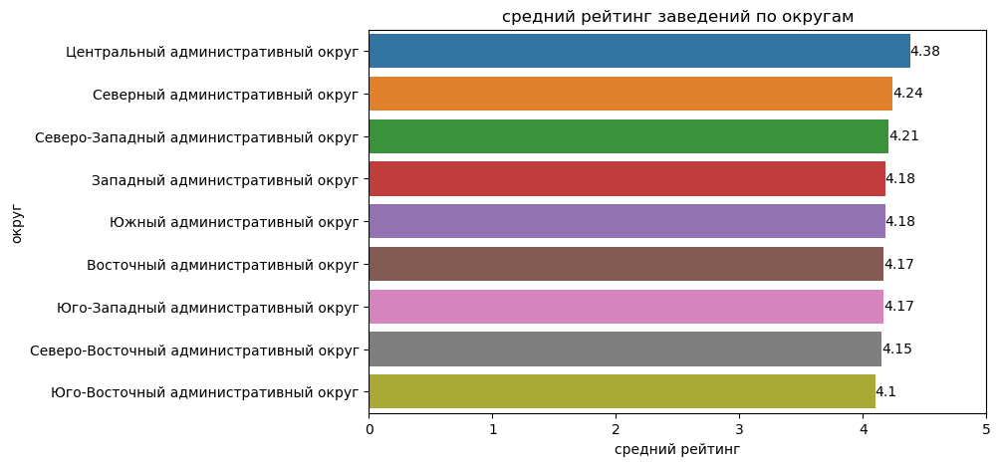

In [83]:
fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='rating',
                 y='district',
                 data=rating_by_district)

ax.set_title('средний рейтинг заведений по округам')
ax.set(xlabel='средний рейтинг')
ax.set(ylabel='округ')
ax.bar_label(ax.containers[0])
plt.xlim(0, 5);

Изобразим на карте:

In [92]:
geo = gpd.read_file(json_file)
geo = geo[['name','geometry']].rename(columns={"name": "district"})
geo_gdf = geo.merge(rating_by_district, on = "district")

In [94]:
m_lat, m_lng = 55.751244, 37.618423
m = Map(location=[m_lat, m_lng], zoom_start=10)

cp = Choropleth(
    geo_data=geo_gdf,
    data=geo_gdf,
    columns=['district', 'rating'],
    key_on='feature.properties.district',
    fill_color='OrRd',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам'
).add_to(m)

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}

district_info = folium.features.GeoJson(
    geo_gdf,
    style_function=style_function, 
    control=False,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['district'
                ,'rating'
               ],
        aliases=['округ: '
                ,'рейтинг: '
                 ],
        style=("background-color: #daede8; color: black; font-family: arial; font-size: 12px; padding: 5px;") 
    )
)

cp.add_child(district_info)
folium.LayerControl().add_to(cp)
m.keep_in_front(district_info)

m

Средние рейтинги по округам тоже не очень разнятся и колеблятся лишь от 4.1 (Юго-Восточный) до 4.38 (Центральный).

А еще, если смотреть географически, то может показаться, что оценки располагаются полярно - рейтинги Восточного ниже всего, затем самый высокие оценки в Центральном, а затем тоже более высокие оценки, чем у остальных - Северный и Северо-Западный. В принципе, такое положение дел совпадает с реальным, где Юго-Восточный не самый благополучный район Москвы, а Центральный, Северный и Северо-Западный - более благополучные. 

Кроме этого, такую оценку можно считать более-менее надежной, потому что в Центральном округе больше всего заведений. А, как правило, чем больше оценок, тем ниже средняя оценка. Значит, в Центральном окурге действительно заведения несколько лучше остальных. 

---

### Отображение всех заведений на карте

In [96]:
m = Map(location=[m_lat, m_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m)

# функция для создания кластеров по строке датафрейма
def create_clusters(row):
    icon_url = 'https://img.icons8.com/officel/512/marker.png'  
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['category']} {row['name']} {row['rating']}", 
        icon=icon
    ).add_to(marker_cluster)

data.apply(create_clusters, axis=1)

m

---

### Топ-15 улиц по количеству заведений

In [97]:
# топ улиц по количеству заведений 

top_streets = (
    data
    .pivot_table(index ='street', values='unique_place', aggfunc='count')
    .reset_index()
    .sort_values(by='unique_place', ascending=False)
)

top_streets.head(15)

,street,unique_place
1090,проспект Мира,183
773,Профсоюзная улица,122
1087,проспект Вернадского,108
525,Ленинский проспект,107
523,Ленинградский проспект,95
373,Дмитровское шоссе,88
455,Каширское шоссе,77
298,Варшавское шоссе,76
524,Ленинградское шоссе,70
550,МКАД,65


<Figure size 800x500 with 0 Axes>

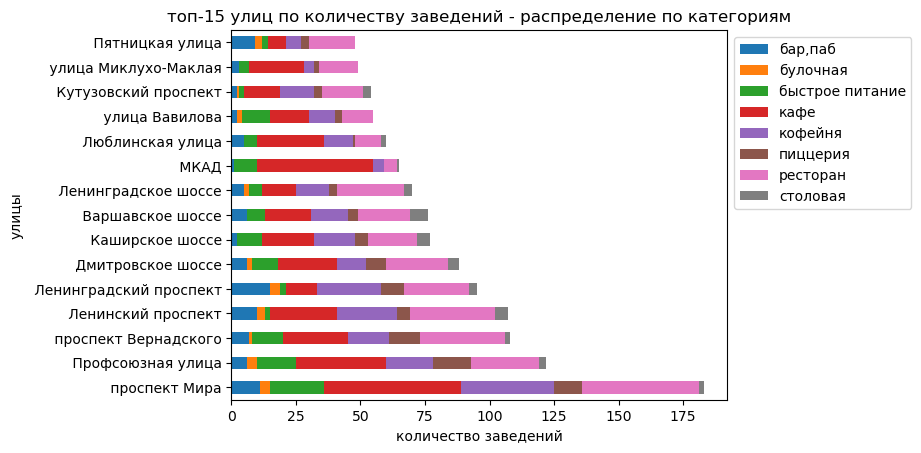

In [98]:
# датафрейм для создания визуализации по категориям

streets = data.groupby(['street', 'category'])['unique_place'].count()
streets = pd.DataFrame(streets.unstack())

top_15_streets = streets.merge(top_streets, on='street').sort_values(by='unique_place', ascending=False).head(15)
top_15_streets = top_15_streets.drop('unique_place', axis=1)
top_15_streets = top_15_streets.set_index('street')

# визуализация
fig = plt.figure(figsize=(8, 5))
ax = (
    top_15_streets
    .plot(kind = 'barh', stacked=True, title='топ-15 улиц по количеству заведений - распределение по категориям')
)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
ax.set(ylabel='улицы')
ax.set(xlabel='количество заведений')
plt.show();

С большим отрывом лидирует Проспект Мира. Большинство улиц в топ-15 - это шоссе и проспекты, а они просто длиннее. Впрочем, ленинградский проспект не так далеко от центра, а на 15 месте одно из самых популярных ресторанных мест города - Пятницкая улица, которая находится в центре города.

<Figure size 800x500 with 0 Axes>

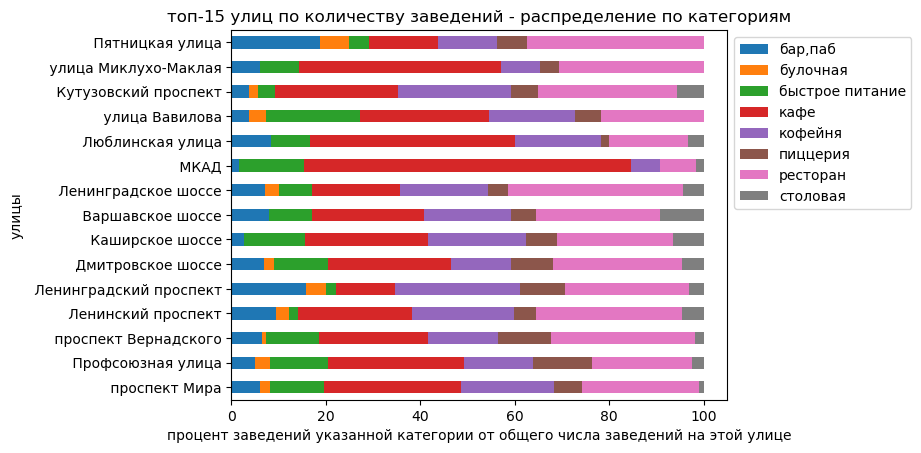

In [99]:
# датафрейм для создания визуализации по категориям

streets = (
    round(data.groupby(['street', 'category'])['unique_place'].count()/
    data.groupby(['street'])['category'].count() * 100, 2)
)
streets = pd.DataFrame(streets.unstack())

top_15_streets = streets.merge(top_streets, on='street').sort_values(by='unique_place', ascending=False).head(15)
top_15_streets = top_15_streets.drop('unique_place', axis=1)
top_15_streets = top_15_streets.set_index('street')

# визуализация
fig = plt.figure(figsize=(8, 5))
ax = (
    top_15_streets
    .plot(kind = 'barh', stacked=True, title='топ-15 улиц по количеству заведений - распределение по категориям')
)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
ax.set(ylabel='улицы')
ax.set(xlabel='процент заведений указанной категории от общего числа заведений на этой улице')
plt.show();

На этом графике хорошо видно, как количество заведений соотносится с типом улицы. Например, на МКАДе большинство заведений - кафе - видимо, придорожные закусочные. На модной Пятницкой - больше ресторанов и баров и совсем нет столовых. 

---

### Улицы с одним заведением

In [100]:
# находим улицы
one_place = (
    data
    .pivot_table(index='street', values='unique_place', aggfunc='count')
    .reset_index()
    .query('unique_place == 1')
    )

# возвращаем им всю информацию из датасета
one_place_data = one_place.merge(data, on='street')

one_place_data.describe()

,unique_place_x,lat,lng,rating,middle_avg_bill,middle_coffee_cup,seats
count,458.0,458.000000,458.000000,458.000000,165.000000,24.000000,156.000000
mean,1.0,55.760131,37.617146,4.236681,959.830303,186.166667,59.115385
std,0.0,0.063903,0.093523,0.461952,999.518083,55.544472,48.274880
min,1.0,55.578830,37.387459,1.000000,67.000000,95.000000,0.000000
25%,1.0,55.729272,37.561486,4.100000,325.000000,140.000000,30.000000
50%,1.0,55.760801,37.612995,4.300000,625.000000,177.500000,45.000000
75%,1.0,55.795678,37.667302,4.500000,1250.000000,213.750000,80.000000
max,1.0,55.914074,37.867004,5.000000,7000.000000,320.000000,240.000000


Так сложно сказать что-то конкретное об этих заведениях - всего таких получилось 458. Средний рейтинг не самый низкий. По показателям среднего чека и цены чашки кофе заведения попадают в категорию "Средние". Разброс мест тоже не очень большой и в пределах нормальных значений по датасету. 

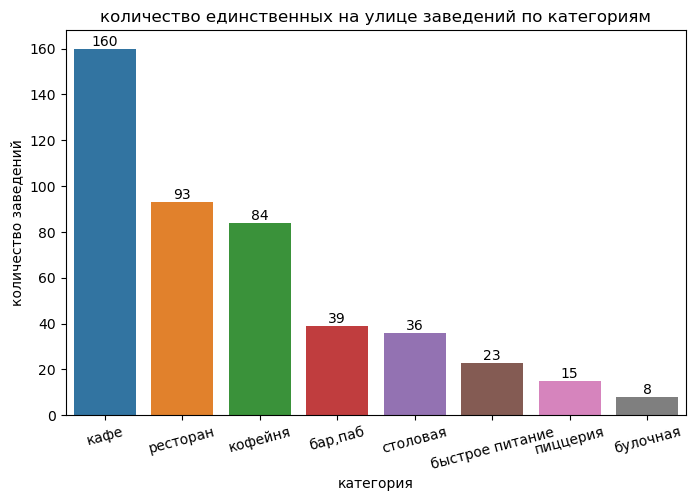

In [102]:
# распределение по категориям

one_place_category = (
                        one_place_data
                        .pivot_table(index='category', values='unique_place_y', aggfunc='count')
                        .reset_index()
                        .sort_values(by='unique_place_y', ascending=False)
                    )

fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='category',
                 y='unique_place_y',
                 data=one_place_category)
ax.set_title('количество единственных на улице заведений по категориям')
ax.set(xlabel='категория')
ax.set(ylabel='количество заведений')
ax.bar_label(ax.containers[0])
plt.xticks(rotation=15);

Видим, что с большей вероятностью одиночные заведения - это кафе. Почти в два раза реже - рестораны и кофейни. В два раза реже от последних - бары, столовые и быстрое питание. Меньше всего - пиццерий и булочных.

Но абсолютные показатели могут быть обманчивы. Лучше проверить долю заведений от общего числа по категории - это будет более показательно. 

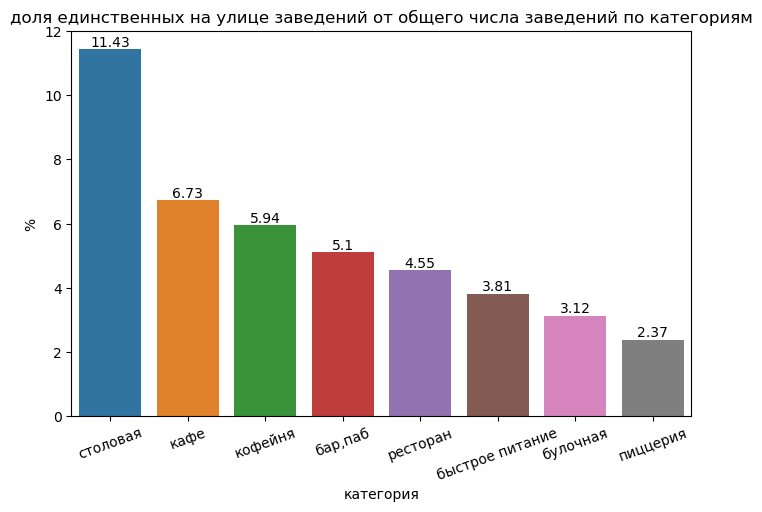

In [108]:
one_place_category_share = (
    round(one_place_data.groupby('category')['unique_place_y'].count()/
    data.groupby(['category'])['unique_place'].count() * 100, 2)
)
one_place_category_share = (
    pd.DataFrame(one_place_category_share)
    .reset_index()
    .sort_values(by=0, ascending=False)
)
one_place_category_share = one_place_category_share.rename(columns={0: "percent_of_total"})


fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='category',
                 y='percent_of_total',
                 data=one_place_category_share)
ax.set_title('доля единственных на улице заведений от общего числа заведений по категориям')
ax.set(xlabel='категория')
ax.set(ylabel='%')
ax.bar_label(ax.containers[0])
plt.xticks(rotation=20);

Так, можно сделать вывод, что чаще внутри категории единственные на улице остаются столовые - почти 12% от их общего числа. Вероятно, дело в каких-нибудь отдаленных улицах или промзонах, где держать много заведений не нужно и невозомжно. Реже всего одни на улице оказываются пиццерии. Возможно, чем меньше данный показатель, тем более устойчив тип заведения к конкуренции.

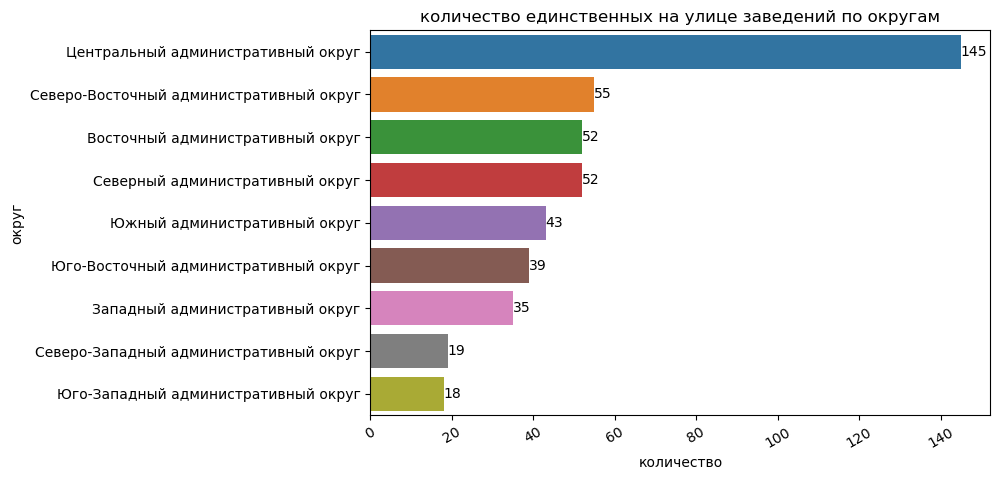

In [110]:
# распределение по округам

one_place_category = (
                        one_place_data
                        .pivot_table(index='district', values='unique_place_y', aggfunc='count')
                        .reset_index()
                        .sort_values(by='unique_place_y', ascending=False)
                    )

fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='unique_place_y',
                 y='district',
                 data=one_place_category)
ax.set_title('количество единственных на улице заведений по округам')
ax.set(xlabel='количество')
ax.set(ylabel='округ')
ax.bar_label(ax.containers[0])
plt.xticks(rotation=30);

В лидерах ЦАО, но мы помним, что там и больше всего заведений. Более наглядно будет проверить относительные показатели.

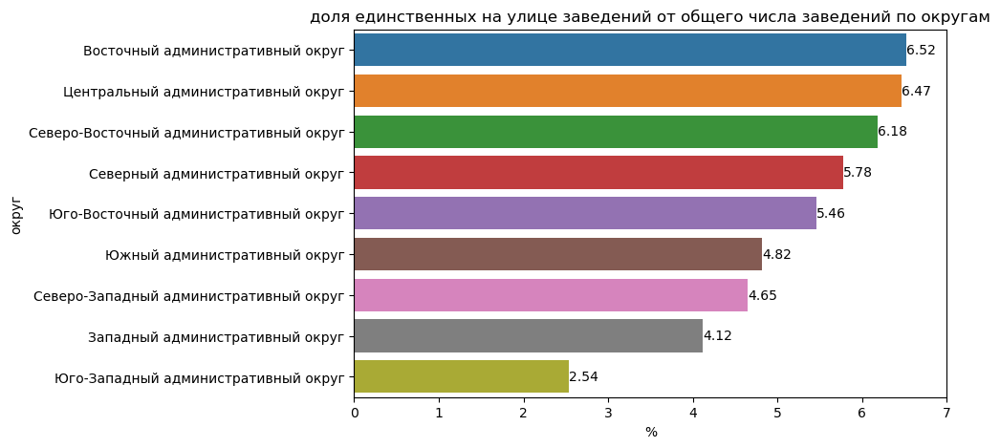

In [111]:
one_place_district_share = (
    round(one_place_data.groupby('district')['unique_place_y'].count()/
    data.groupby(['district'])['unique_place'].count() * 100, 2)
)
one_place_district_share = (
    pd.DataFrame(one_place_district_share)
    .reset_index()
    .sort_values(by=0, ascending=False)
)
one_place_district_share = one_place_district_share.rename(columns={0: "percent_of_total"})


fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='percent_of_total',
                 y='district',
                 data=one_place_district_share)
ax.set_title('доля единственных на улице заведений от общего числа заведений по округам')
ax.set(xlabel='%')
ax.set(ylabel='округ')
ax.bar_label(ax.containers[0])
ax.set(xlim=(0, 7));


Центральный округ все еще в лидерах, но примерно такой же процент и у восточного (а так как раз много производств и промзон). Чуть меньше показатель у Северо-Восточного. Меньше всего одиноких заведений в Юго-Западном округе. 

Стоит проверить, можно ли сделать дополнительные выводы после проверки распределния количества улиц в датасете по округам.

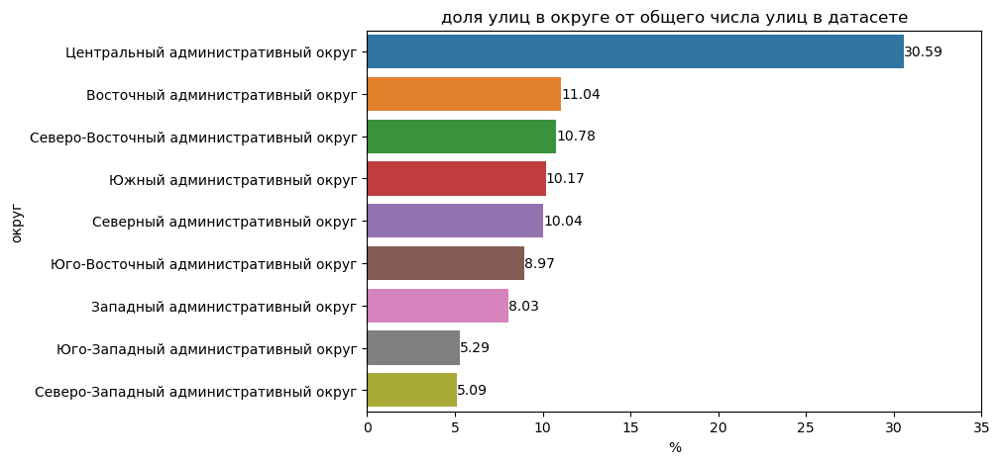

In [112]:
streets_by_districts = (
    data
    .pivot_table(index='district', values='street', aggfunc=('nunique'))
    .reset_index()
    .sort_values(by='street', ascending=False)
)
streets_by_districts['percent_of_total'] = round(
    streets_by_districts['street'] / sum(streets_by_districts['street']) * 100, 2
)

fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='percent_of_total',
                 y='district',
                 data=streets_by_districts)
ax.set_title('доля улиц в округе от общего числа улиц в датасете')
ax.set(xlabel='%')
ax.set(ylabel='округ')
ax.bar_label(ax.containers[0])
ax.set(xlim=(0, 35));


Действительно, гораздо больше улиц - в центральном округе. Таким образом, высокий процент одиноких заведений ничего не говорит, но только для этого округа. 

Например, в Северо-Западном округе меньше всего улиц, но процент одиноких заведений почти такой же, как и в ЦАО. 

Таким образом, сравнивая эти два показателя можно выводить специфику каждого отдельно округа.

---

Пытаться изобразить все одинокие заведения на карте было бы проблематично, потому что из придется разбивать на кластеры и не удастся охватить одним взглядом. Попробуем визуализировать с помощью хитмепа.   

In [114]:
m_lat, m_lng = 55.751244, 37.618423
m = Map(location=[m_lat, m_lng], zoom_start=11)

cp = Choropleth(
    geo_data=state_geo,
    data=rating_by_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='OrRd',
    fill_opacity=0
).add_to(m)

cp.geojson.add_child(
    folium.features.GeoJsonTooltip(
            fields=['name'],
            aliases=[''],
            style=("background-color: #daede8; color: black; font-family: arial; font-size: 12px; padding: 5px;") 
        )
)

for key in cp._children:
    if key.startswith('color_map'):
        del(cp._children[key])
        
cp.add_to(m)

lats_lngs = np.array(one_place_data[['lat', 'lng']])

HeatMap(lats_lngs).add_to(m)

folium.LayerControl().add_to(m)

m

Частично можно подвердить выдвинутое предположение - более красные места на карте свидетельствуют о том, что даже несмотря на то, что заведения находятся одни на улице, они близко к другим заведениям. Более разряженные территории - зеленый и голубой цвета - говорит о том, что заведения стоят чуть дальше друг от друга. 

---

### Медианный чек

#### Медианный чек по округам

In [115]:
median_bill = (
    data
    .pivot_table(index='district', values='middle_avg_bill', aggfunc='median')
    .reset_index()
    .sort_values(by='middle_avg_bill', ascending=False)
)
median_bill['median_bill'] = median_bill['middle_avg_bill'].astype(int)
median_bill = median_bill.drop('middle_avg_bill', axis=1)
median_bill

,district,median_bill
1,Западный административный округ,1000
5,Центральный административный округ,1000
4,Северо-Западный административный округ,700
2,Северный административный округ,650
7,Юго-Западный административный округ,600
0,Восточный административный округ,575
3,Северо-Восточный административный округ,500
8,Южный административный округ,500
6,Юго-Восточный административный округ,450


Изобразим на карте:

In [120]:
geo = gpd.read_file(json_file)
geo = geo[['name','geometry']].rename(columns={"name": "district"})
geo_gdf = geo.merge(median_bill, on = "district")

In [121]:
m_lat, m_lng = 55.751244, 37.618423
m = Map(location=[m_lat, m_lng], zoom_start=10)

cp = Choropleth(
    geo_data=geo_gdf,
    data=geo_gdf,
    columns=['district', 'median_bill'],
    key_on='feature.properties.district',
    fill_color='OrRd',
    fill_opacity=0.8,
    legend_name='медианный чек по округам'
).add_to(m)

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}

district_info = folium.features.GeoJson(
    geo_gdf,
    style_function=style_function, 
    control=False,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['district'
                ,'median_bill'
               ],
        aliases=['округ: '
                ,'медианный чек: '
                 ],
        style=("background-color: #daede8; color: black; font-family: arial; font-size: 12px; padding: 5px;") 
    )
)

cp.add_child(district_info)
folium.LayerControl().add_to(cp)
m.keep_in_front(district_info)

display(m)


В центральному округе самый высокий медианный чек. Это предсказуемо. Такое же высокое значение у Западного округа, что тоже довольно ожидаемо, учитывая большое количество "престижных улиц" (например, Кутузовский проспект) и дорогих районов (например, направление Рублевского Шоссе). 

В целом довольно предсказуемо лидирует центр, запад и северо-запад. Однако немного странно, что медианный чек в Восточном округе выше, чем в Северо-Восточном. Так что можно сказать, что удаленность от центра действительно важна, но не на 100%.

---

#### Медианный чек по категориям

In [122]:
median_bill_category = (
    data
    .pivot_table(index='category', values='middle_avg_bill', aggfunc='median')
    .reset_index()
    .sort_values(by='middle_avg_bill', ascending=False)
)
median_bill_category['median_bill'] = median_bill_category['middle_avg_bill'].astype(int)
median_bill_category = median_bill_category.drop('middle_avg_bill', axis=1)
median_bill_category

,category,median_bill
0,"бар,паб",1250
6,ресторан,1250
5,пиццерия,600
3,кафе,550
1,булочная,450
4,кофейня,400
2,быстрое питание,375
7,столовая,300


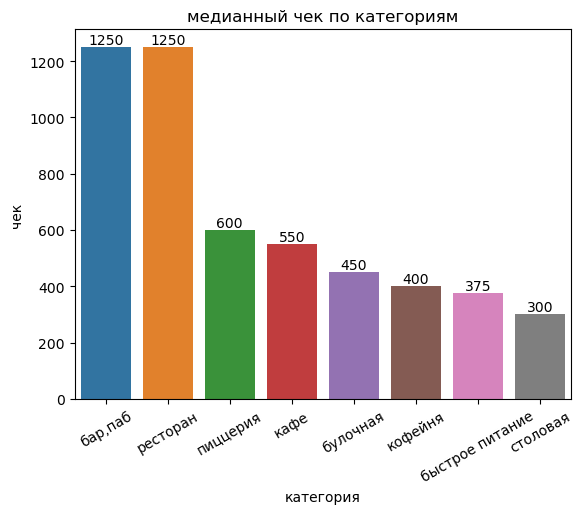

In [123]:
ax = sns.barplot(x='category',
                 y='median_bill',
                 data=median_bill_category)
ax.set_title('медианный чек по категориям')
ax.set(xlabel='категория')
ax.set(ylabel='чек')
ax.bar_label(ax.containers[0])
plt.xticks(rotation=30);

Бары и рестораны дороже всего. Пиццерии и кафе в два раза дешевле. Дешевле всего - столовые и быстрое питание. Заметим, что у кофеен тоже невысокий средний чек - 400 рублей. Видимо, в кафейнях чаще берут только один кофе. 

#### Медианный чек по категориям и округам

In [129]:
median_bill_district_category = (
    data
    .pivot_table(index=('district','category'), values='middle_avg_bill', aggfunc='median')
    .reset_index()
    .sort_values(by='middle_avg_bill', ascending=False)
)
median_bill_district_category['median_bill'] = median_bill_district_category['middle_avg_bill'].astype(int)
median_bill_district_category = median_bill_district_category.drop('middle_avg_bill', axis=1)
median_bill_district_category.sort_values(by='district')

,district,category,median_bill
5,Восточный административный округ,пиццерия,500
3,Восточный административный округ,кафе,450
4,Восточный административный округ,кофейня,400
0,Восточный административный округ,"бар,паб",1200
2,Восточный административный округ,быстрое питание,375
...,...,...,...
71,Южный административный округ,столовая,282
65,Южный административный округ,булочная,437
67,Южный административный округ,кафе,600
68,Южный административный округ,кофейня,387


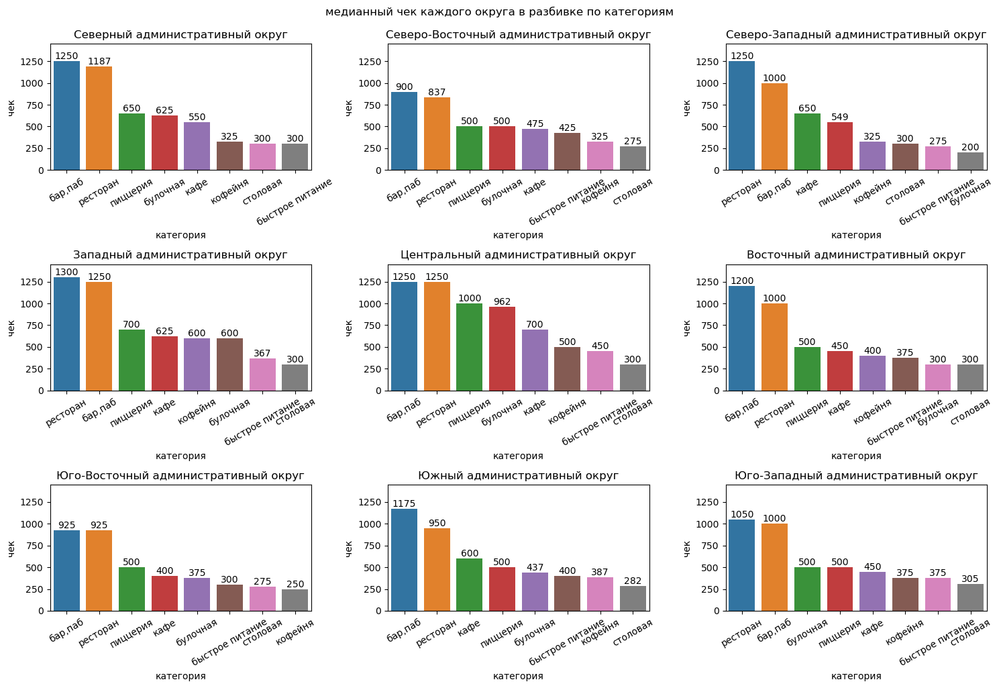

In [135]:
districts = list(data['district'].unique())
fig, axes = plt.subplots(ncols=3, nrows=3, figsize=(15,10))

for i, dist in enumerate(districts):
    ax = axes[int(i/3), i%3]
    sns.barplot(
        x='category',
        y='median_bill',
        data=median_bill_district_category.query('district == @dist'),
        ax=ax)
    ax.set_title(dist)
    ax.set(xlabel='категория')
    ax.set(ylabel='чек')
    ax.tick_params('x', labelrotation=30)
    ax.bar_label(ax.containers[0])
    ax.set(ylim=(0, 1450))
    plt.tight_layout()
    
fig.suptitle('медианный чек каждого округа в разбивке по категориям', y=1.02);

Данная визуализация помогает понять, что средний чек в  ресторанах и барах дороже в любом округе. Так как и столовые - дешевле всего в каждом округе. Но вот в середине распределения средний чек заведений выше в центральном округе, что тоже закономерно - там дороже любой тип заведений. Также видно, что север и запад чуть дороже остальных, кроме центра, в том числе и по заведениям в середине рейтинга по размеру среднего чека. 

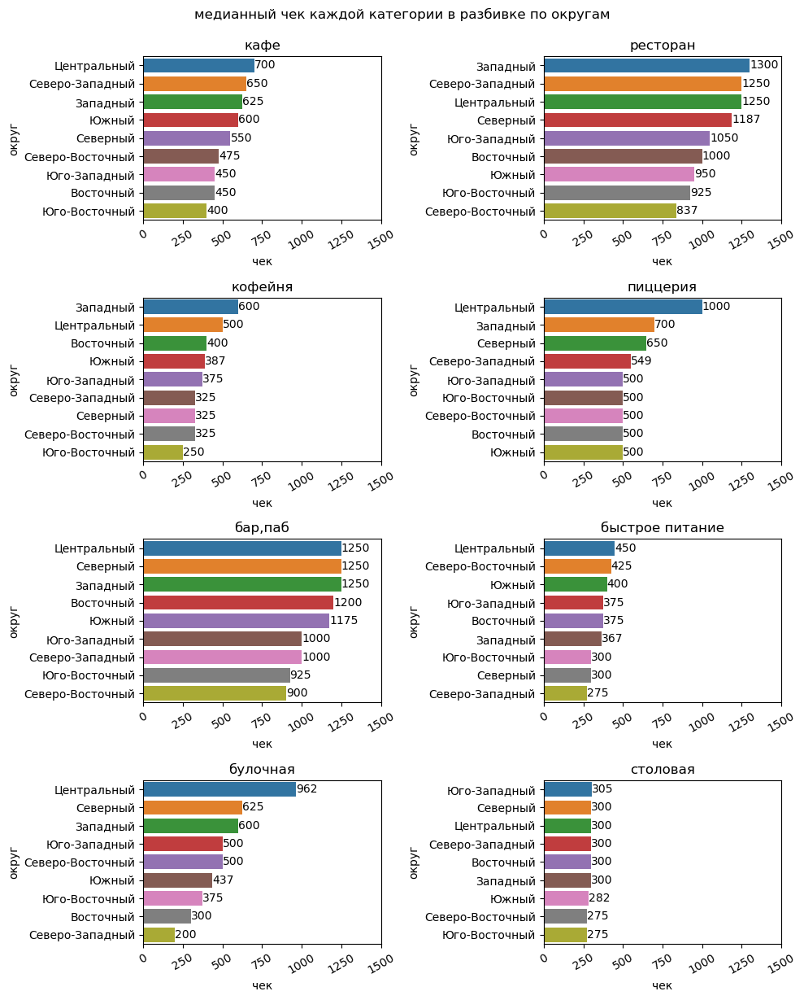

In [137]:
median_bill_district_category['district'] =  (
    median_bill_district_category['district'].str.split(' ', expand=True)[0]
)
median_bill_district_category

categories = list(data['category'].unique())
fig, axes = plt.subplots(ncols=2, nrows=4, figsize=(10,12))

for i, cat in enumerate(categories):
    ax = axes[int(i/2), i%2]
    sns.barplot(
        x='median_bill',
        y='district',
        data=median_bill_district_category.query('category == @cat'),
        ax=ax)
    ax.set_title(cat)
    ax.set(xlabel='чек')
    ax.set(ylabel='округ')
    ax.tick_params('x', labelrotation=30)
    ax.bar_label(ax.containers[0])
    ax.set(xlim=(0, 1500))
    plt.tight_layout()
    
fig.suptitle('медианный чек каждой категории в разбивке по округам', y=1.02);

А эти графики помогают понять, какие категории в каких округах дороже всего. 

Чаще всего самые дорогие - Центральный или Западный. Столовые одинаково дорогие везде, но несколько дороже на Юго-Западе. 

Самые большие отрывы по показателям: булочные в Центральном округе, Пиццерии в центральном округе - ощутимо дороже, чем где-либо, а так же кофейни в западном округе - так же ощутимо дороже, чем в остальных. 

### Поиск взаимосвязей

#### Корреляция расстояния до центра и среднего чека

In [138]:
def distance_calc(lat1, lng1, lat2, lng2, rounder):
    loc1 = (lat1, lng1)
    loc2 = (lat2, lng2)
    result = round(hs.haversine(loc1,loc2), rounder)
    return result


In [139]:
# создание датафрема

distance_data = data[['unique_place', 'district', 'category', 'lat', 'lng', 'middle_avg_bill']].copy()

distance_data['distance'] = (
    distance_data
    .apply(lambda row: distance_calc(m_lat, m_lng, row['lat'], row['lng'], 1), axis=1)
)
display(distance_data.head())


,unique_place,district,category,lat,lng,middle_avg_bill,distance
0,"WoWфлиМосква, улица Дыбенко, 7/1",Северный административный округ,кафе,55.878494,37.478860,NaN,16.6
1,"Четыре комнатыМосква, улица Дыбенко, 36, корп. 1",Северный административный округ,ресторан,55.875801,37.484479,1550.0,16.2
2,"ХазриМосква, Клязьминская улица, 15",Северный административный округ,кафе,55.889146,37.525901,1000.0,16.4
3,"Dormouse Coffee ShopМосква, улица Маршала Федо...",Северный административный округ,кофейня,55.881608,37.488860,NaN,16.6
4,"Иль МаркоМосква, Правобережная улица, 1Б",Северный административный округ,пиццерия,55.881166,37.449357,500.0,17.9


In [140]:
corr = distance_data['middle_avg_bill'].corr(distance_data['distance'])
print(f'коэф. корреляции между средним чеком и расстоянием до ценра для всего датасета: {corr}')


коэф. корреляции между средним чеком и расстоянием до ценра для всего датасета: -0.21300750427701026


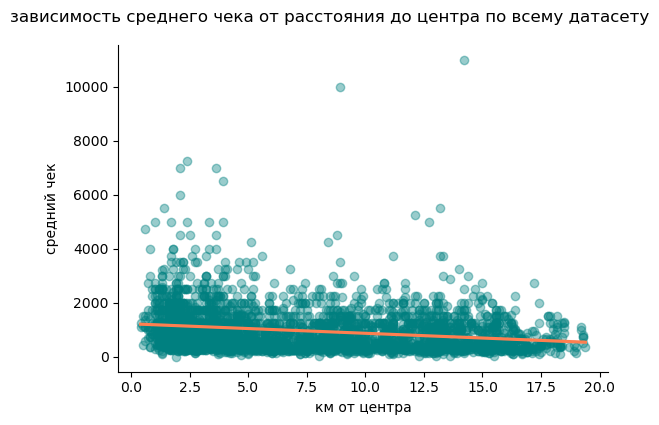

In [141]:
lm = (
    sns.lmplot(
    data=distance_data, x="distance", y="middle_avg_bill",
    height=4, aspect=1.5, 
    scatter_kws={'color': 'teal', 'alpha':0.4}, line_kws={'color': 'coral'}
).set_axis_labels('км от центра', 'средний чек')
    .fig
    .suptitle("зависимость среднего чека от расстояния до центра по всему датасету", y=1.05)
);

Зависимость есть, но небольшая. Причем зависимость отрицательная: чем больше км от центра, тем ниже чек. В целом закономерно и подтверждает предыдущие заключения.

Проверим в разрезе по категориям и районам. 

In [142]:
categories = list(distance_data['category'].unique())
districts = list(distance_data['district'].unique())


In [143]:
for cat in categories: 
    distance = distance_data.query('category == @cat')['distance']
    bill = distance_data.query('category == @cat')['middle_avg_bill']
    corr = round(distance.corr(bill), 3)
    print(f'коэф. корреляции для категории {cat}: {corr}')


коэф. корреляции для категории кафе: -0.06
коэф. корреляции для категории ресторан: -0.204
коэф. корреляции для категории кофейня: -0.305
коэф. корреляции для категории пиццерия: -0.394
коэф. корреляции для категории бар,паб: -0.153
коэф. корреляции для категории быстрое питание: -0.059
коэф. корреляции для категории булочная: -0.443
коэф. корреляции для категории столовая: -0.068


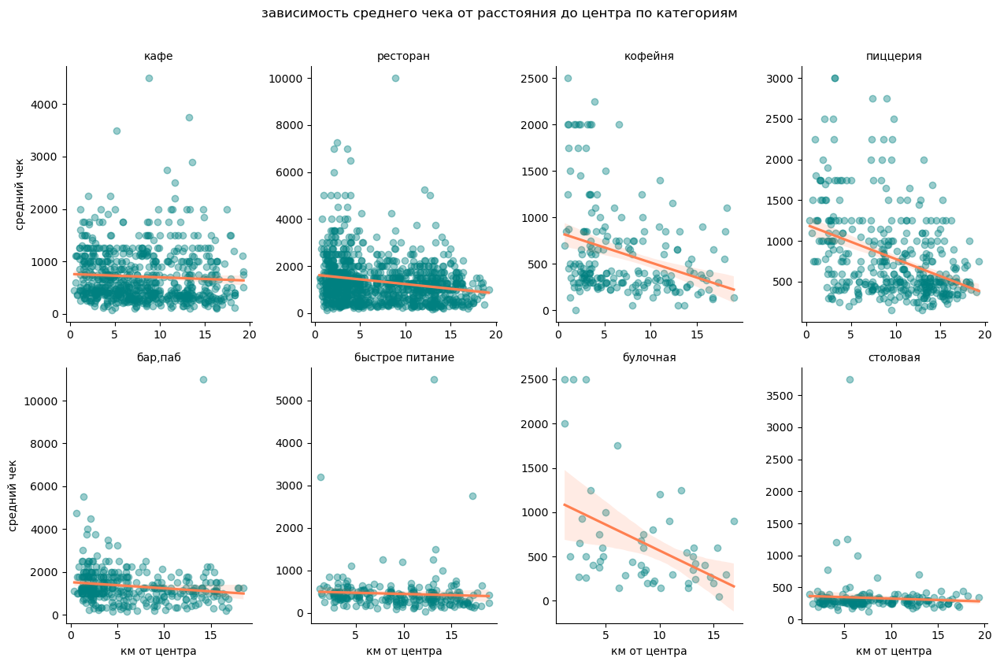

In [144]:
lm = (
    sns.lmplot(
    data=distance_data, x="distance", y="middle_avg_bill",
    col="category", height=4, aspect=0.8, facet_kws=dict(sharex=False, sharey=False), 
    col_wrap=4, scatter_kws={'color': 'teal', 'alpha':0.4}, line_kws={'color': 'coral'}
).set_axis_labels('км от центра', 'средний чек')
    .set_titles(col_template="{col_name}")
    .fig
    .suptitle("зависимость среднего чека от расстояния до центра по категориям", y=1.05)
);


Чем больше угол линии регресси по отношению к оси х, тем больше зависимость. 
Например, почти все столовые недорогие, вне зависимости, далеко они от центра или нет. А вот Булочные, судя по графику, дороже именно в центра и примерно в два раза дешевле на окраине. 

Также более высокую зависимость можно наблюдать у кофеен и пиццерий. Небольшая зависимость еще у кафе и заведений быстрого питания.

In [145]:
for dist in districts: 
    distance = distance_data.query('district == @dist')['distance']
    bill = distance_data.query('district == @dist')['middle_avg_bill']
    corr = round(distance.corr(bill), 3)
    print(f'коэф. корреляции для округа {dist}: {corr}')


коэф. корреляции для округа Северный административный округ: -0.091
коэф. корреляции для округа Северо-Восточный административный округ: -0.082
коэф. корреляции для округа Северо-Западный административный округ: -0.076
коэф. корреляции для округа Западный административный округ: -0.137
коэф. корреляции для округа Центральный административный округ: -0.168
коэф. корреляции для округа Восточный административный округ: 0.017
коэф. корреляции для округа Юго-Восточный административный округ: 0.116
коэф. корреляции для округа Южный административный округ: -0.077
коэф. корреляции для округа Юго-Западный административный округ: -0.136


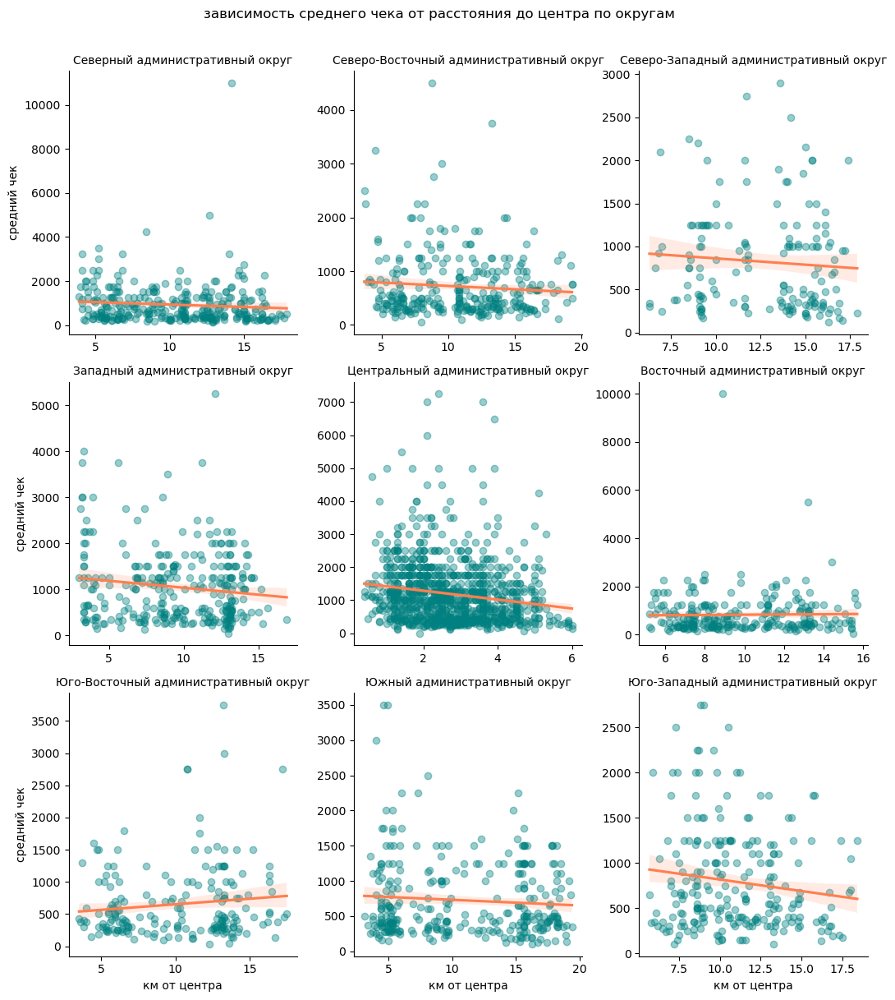

In [146]:
lm = (
    sns.lmplot(
    data=distance_data, x="distance", y="middle_avg_bill",
    col="district", height=4, aspect=0.9, facet_kws=dict(sharex=False, sharey=False), 
    col_wrap=3, scatter_kws={'color': 'teal', 'alpha':0.4}, line_kws={'color': 'coral'}
).set_axis_labels('км от центра', 'средний чек')
    .set_titles(col_template="{col_name}")
    .fig
    .suptitle("зависимость среднего чека от расстояния до центра по округам", y=1.01)
);
plt.tight_layout()


В целом корреляции по округам нельзя назвать достаточно сильными, но более-менее значимые корреляции наблюдаются у СЗАО, ЗАО, ЦАО, ЮЗАО и ЮВАО. Причем у последнего - показатель корреляции даже положительный, то есть, чем дальше от центра заведения в этом округе, тем там дороже чек. 

Таким образом, поиск зависимостей по расстоянию от центра в разбивке по округам не имеет особого смысла, потому что все что не в ЦАО и так далеко от "центра", а то что внутри ЦАО и так недалеко от "центра". 

---

#### Корреляция рейтинга и среднего чека

In [147]:
corr = data['rating'].corr(data['middle_avg_bill'])
print(f'коэф. корреляции между средним чеком и рейтингом для всего датасета: {corr}')

коэф. корреляции между средним чеком и рейтингом для всего датасета: 0.2373495781501691


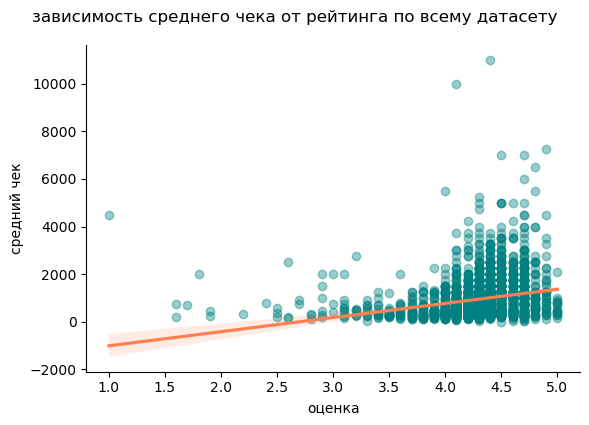

In [148]:
lm = (
    sns.lmplot(
    data=data, x="rating", y="middle_avg_bill",
    height=4, aspect=1.5, 
    scatter_kws={'color': 'teal', 'alpha':0.4}, line_kws={'color': 'coral'}
).set_axis_labels('оценка', 'средний чек')
    .fig
    .suptitle("зависимость среднего чека от рейтинга по всему датасету", y=1.05)
);

Частично можно заключить, что взаимосвязь (чем выше средний чек, тем выше оценка) есть, однако она не очень сильная.

Посмотрим в разрезе по категориям. 

In [149]:
for cat in categories: 
    rating = data.query('category == @cat')['rating']
    bill = data.query('category == @cat')['middle_avg_bill']
    corr = round(rating.corr(bill), 3)
    print(f'коэф. корреляции для категории {cat}: {corr}')

коэф. корреляции для категории кафе: 0.029
коэф. корреляции для категории ресторан: 0.287
коэф. корреляции для категории кофейня: 0.19
коэф. корреляции для категории пиццерия: 0.209
коэф. корреляции для категории бар,паб: 0.215
коэф. корреляции для категории быстрое питание: 0.078
коэф. корреляции для категории булочная: 0.234
коэф. корреляции для категории столовая: -0.046


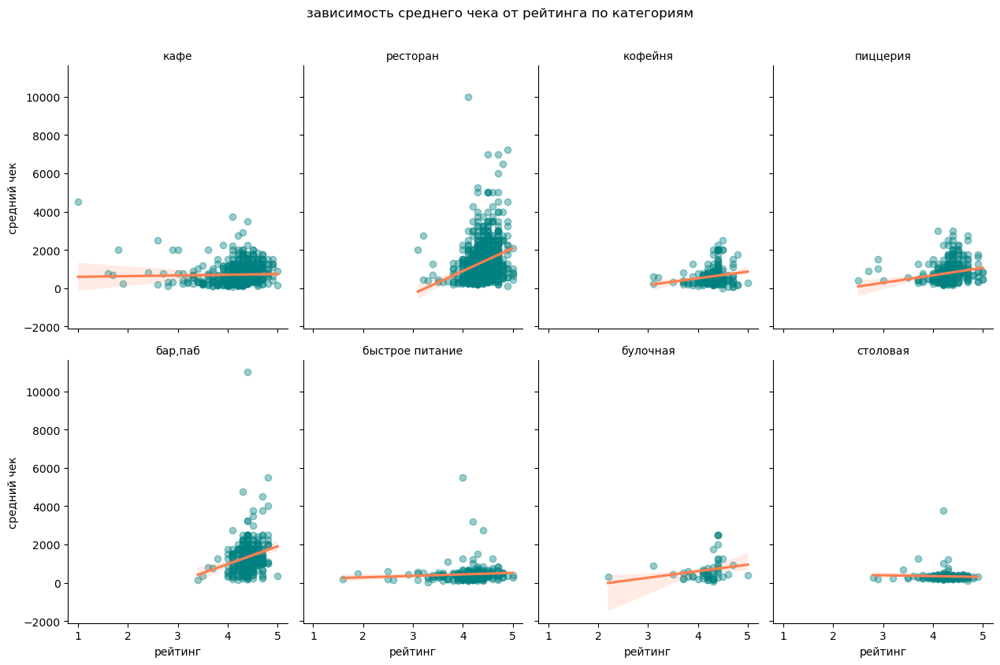

In [150]:
lm = (
    sns.lmplot(
    data=data, x="rating", y="middle_avg_bill",
    col="category", height=4, aspect=0.8, 
    col_wrap=4, scatter_kws={'color': 'teal', 'alpha':0.4}, line_kws={'color': 'coral'}
).set_axis_labels('рейтинг', 'средний чек')
    .set_titles(col_template="{col_name}")
    .fig
    .suptitle("зависимость среднего чека от рейтинга по категориям", y=1.05)
);

Самые большие зависимости можно наблюдать для кафе, коффен, ресторанов, пиццерий, баров и булочных. А для столовых и быстрого питания зависимоти почти нет - такая же картина, как и с зависимостью от расстояния. 

Проверим по округам.

In [151]:
for dist in districts: 
    rating = data.query('district == @dist')['rating']
    bill = data.query('district == @dist')['middle_avg_bill']
    corr = round(rating.corr(bill), 3)
    print(f'коэф. корреляции для категории {dist}: {corr}')

коэф. корреляции для категории Северный административный округ: 0.203
коэф. корреляции для категории Северо-Восточный административный округ: -0.014
коэф. корреляции для категории Северо-Западный административный округ: 0.11
коэф. корреляции для категории Западный административный округ: 0.188
коэф. корреляции для категории Центральный административный округ: 0.341
коэф. корреляции для категории Восточный административный округ: 0.099
коэф. корреляции для категории Юго-Восточный административный округ: 0.139
коэф. корреляции для категории Южный административный округ: 0.17
коэф. корреляции для категории Юго-Западный административный округ: 0.263


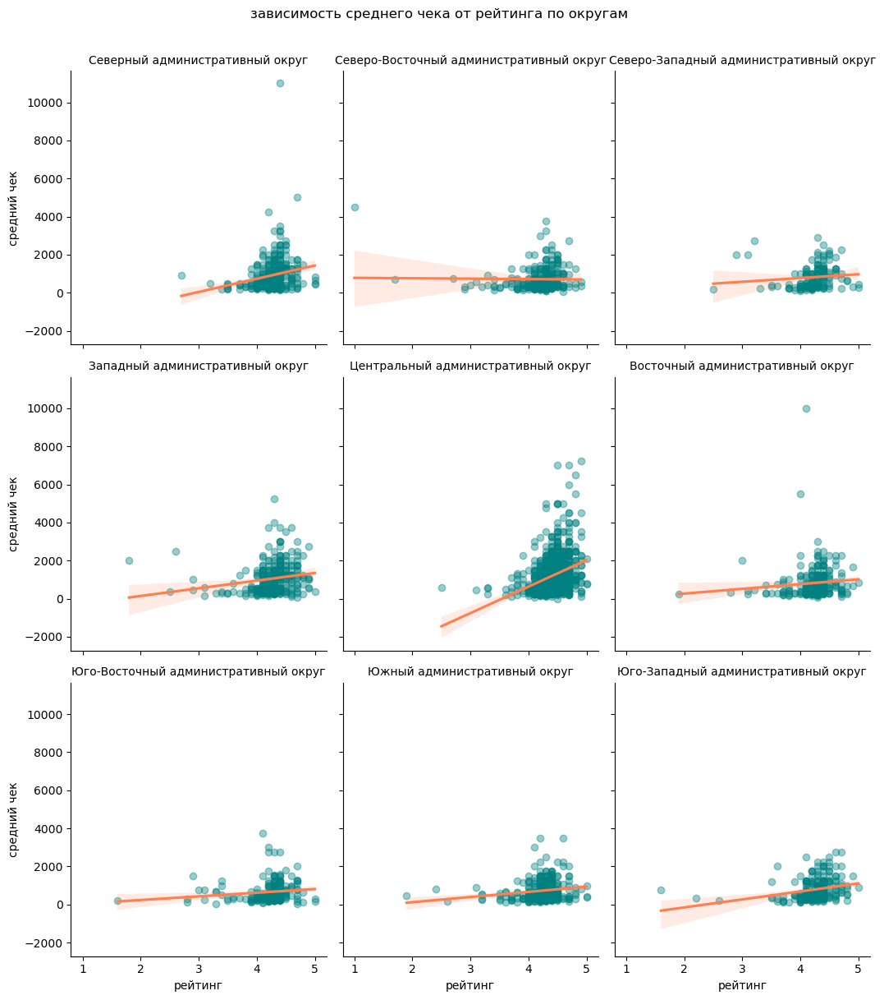

In [152]:
lm = (
    sns.lmplot(
    data=data, x="rating", y="middle_avg_bill",
    col="district", height=4, aspect=0.9, 
    col_wrap=3, scatter_kws={'color': 'teal', 'alpha':0.4}, line_kws={'color': 'coral'}
).set_axis_labels('рейтинг', 'средний чек')
    .set_titles(col_template="{col_name}")
    .fig
    .suptitle("зависимость среднего чека от рейтинга по округам", y=1.01)
)
plt.tight_layout();

Наибольшую зависимость можно ожидаемо наблюдать в ЦАО (где наверняка более требовательные клиенты), а так же в САО, ЮЗАО. 

По графикам так же хорошо видно распределение средних чеков по округам. В ЦАО, например, оно явно стремится в правый верхний угол графика, то есть к более дорогим заведениям с более высокой оценкой. А большинство значений, например, ВАО концентрируются справа внизу, то есть за более дешевыми, но тоже высоко оцененными клиентами завдениями лучше идти туда. А, например, в САО также относительно недорогие заведения, однако оценки там несколько ниже. 

---

#### Самые низкие и самые высокие оценки

Исследуем заведения по по показетелю рейтинга таким образом: посмотрим на распределение показателя для всего датасета. Отберем значения выше и ниже "нормальных".

In [153]:
array = np.array(list(data.loc[(data['rating'].isnull() == False)]['rating']))

display(data['rating'].describe())

q3, q1 = np.percentile(array, [75 ,25])
iqr = q3 - q1    
upper = round(q3 + 1.5 * iqr, 2)
lower = round(q1 - 1.5 * iqr, 2)

print(f'нижняя граница нормальных значений: {upper}')
print(f'верхняя граница нормальных значений: {lower}')

count    8403.000000
mean        4.229894
std         0.470426
min         1.000000
25%         4.100000
50%         4.300000
75%         4.400000
max         5.000000
Name: rating, dtype: float64

нижняя граница нормальных значений: 4.85
верхняя граница нормальных значений: 3.65


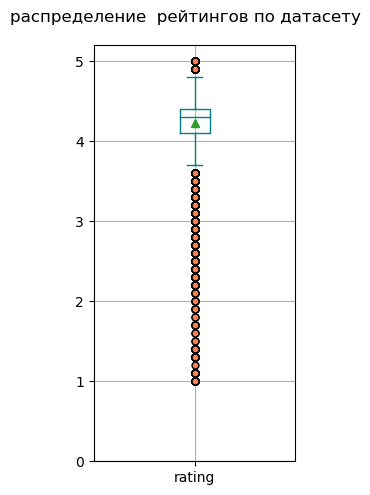

In [154]:
# визуализация

flierprops=dict(marker='o', markerfacecolor='coral', markersize=5,
                  linestyle='none')

fig = plt.figure(figsize=(2.5, 5))
data['rating'].plot(
    kind='box', 
    subplots=True, 
    figsize=(5,5),
    grid=True, 
    xlabel='рейтинг', 
    title='распределение  рейтингов по датасету', 
    color='teal',
    flierprops=flierprops, 
    showmeans=True
);
plt.ylim(ymin=0, ymax = 5.2)
plt.tight_layout()
plt.show()

Средняя оценка по датасету - 4.2, а медианная - 4.3. 

Можно считать обычными оценки от 3.65 до 4.85. Все что выше - будем считать очень хорошими оценками, все что ниже - очень плохими. В данном случае нас интересуют именно аномалии - нужно выяснить, почему те или иные заведения имеют необычно высокий или необычно низкий рейтинг.

---

Лучшие заведения

In [155]:
excellent = data.copy().query('rating > 4.85')
excellent.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,seats
count,348.000000,348.000000,348.000000,49.000000,26.000000,171.000000
mean,55.749909,37.624862,4.930172,1230.714286,166.076923,89.508772
std,0.071161,0.108294,0.045967,1276.868729,43.800386,98.454132
min,55.589937,37.357339,4.900000,120.000000,90.000000,0.000000
25%,55.689151,37.551931,4.900000,450.000000,136.250000,37.000000
50%,55.754681,37.622573,4.900000,850.000000,157.500000,70.000000
75%,55.795479,37.696049,5.000000,1500.000000,193.750000,100.000000
max,55.909740,37.874466,5.000000,7250.000000,275.000000,760.000000


Всего заведений с необычно высокими оценками 348.

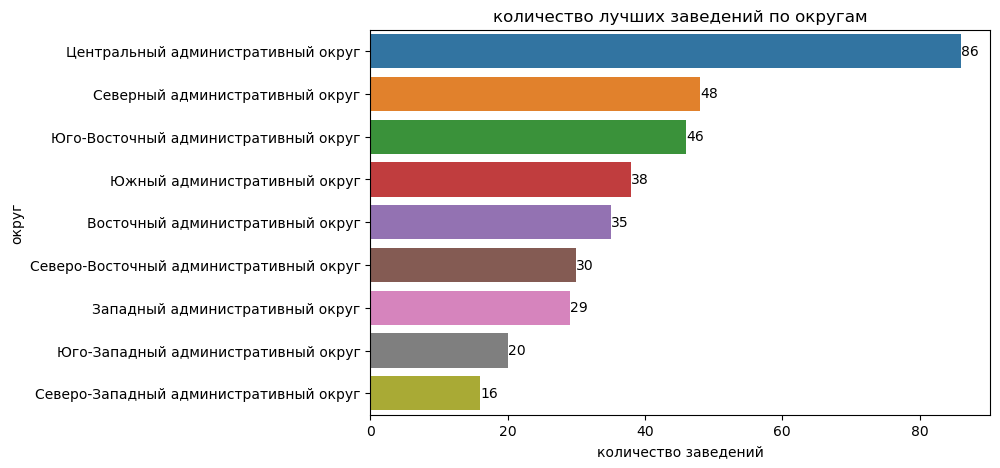

In [157]:
excellent_by_district = (
    excellent.pivot_table(index='district', values='unique_place', aggfunc='nunique')
    .reset_index()
    .sort_values(by='unique_place', ascending=False)
)

# визуализация
fig = plt.figure(figsize=(8, 5))
ax = sns.barplot(x='unique_place',
                 y='district',
                 data=excellent_by_district)
ax.set_title('количество лучших заведений по округам')
ax.set(xlabel='количество заведений')
ax.bar_label(ax.containers[0])
ax.set(ylabel='округ');

Лидирует ожидаемо ЦАО. Меньше всего - весь запад, ранее мы частично отмечали, что там в целом оценки ниже. 

<Figure size 800x500 with 0 Axes>

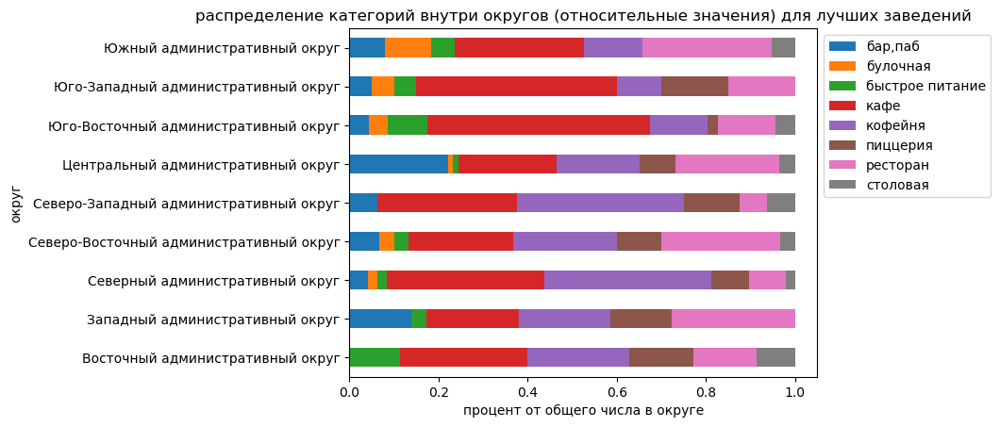

In [158]:
excellent_grouped = (
    excellent.groupby(['district', 'category'])['unique_place'].count()/
    excellent.groupby('district')['unique_place'].count()
)
excellent_grouped = pd.DataFrame(excellent_grouped.unstack())

fig = plt.figure(figsize=(8, 5))
ax = (
    excellent_grouped
    .plot(kind = 'barh', stacked=True, title='распределение категорий внутри округов (относительные значения) для лучших заведений')
)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
ax.set(ylabel='округ')
ax.set(xlabel='процент от общего числа в округе')
plt.show();

Распределения заведений с высокими оценками заметно отличается по округам. Бары из восточного оркуга не попали в топ заведений, как, например, булочные из ЗАО и ЮЗАО. Самые большие оценки у баров, ожидаемо, в центре. А вот больше всего кафе с высокими оценками - в ЮВАО. В Южном округе нет пиццерий с высокими оценками, а в СЗАО, ЗАО и ВАО нет булочных с высокими оценками.

---

Посмотрим на соотношение сетевых и несетвых заведений с хорошими оценками. 

In [159]:
excellent_chains = excellent.pivot_table(index='chain', values='unique_place', aggfunc='count').reset_index()

excellent_chains['percent'] = (
    round(excellent_chains['unique_place'] / sum(excellent_chains['unique_place']) * 100, 1)
                                                    )

excellent_chains = (
                    excellent_chains.replace(
                        {"chain": 
                        {True: "chain",
                         False: "not chain"}
                        }
                    )
)
excellent_chains

,chain,unique_place,percent
0,not chain,258,74.1
1,chain,90,25.9


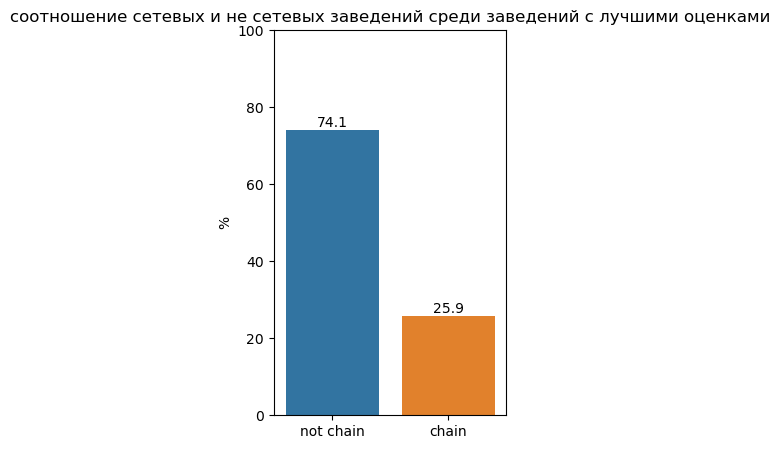

In [162]:
fig = plt.figure(figsize=(3, 5))

ax = sns.barplot(x='chain',
                 y='percent',
                 data=excellent_chains)
ax.set_title('соотношение сетевых и не сетевых заведений среди заведений с лучшими оценками')
ax.set(ylabel='%')
ax.bar_label(ax.containers[0])
ax.set(xlabel='')
ax.set(ylim=(0, 100));

Процентное соотношение иное, чем по датасету. В целом тоже преобладают несетевые заведения, однако не так сильно (во всем датасете 63% на 37%, среди лучших заведений - 74% на 26%). Видимо, в несетевых заведениях проще поддерживать высокие стандарты обслууживания и и проявлять индивидуальный подход. 

---

Теперь рассмотрим заведения с худшими оценками.

In [163]:
bad = data.copy().query('rating < 3.65')
bad.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,seats
count,582.000000,582.000000,582.000000,110.000000,10.000000,284.000000
mean,55.742562,37.623347,2.951890,593.227273,111.000000,93.633803
std,0.080098,0.112212,0.689924,625.518349,38.218669,119.569367
min,55.578446,37.390600,1.000000,30.000000,60.000000,0.000000
25%,55.677882,37.527528,2.700000,275.000000,83.750000,30.000000
50%,55.734443,37.633093,3.200000,392.500000,105.000000,60.000000
75%,55.805194,37.710154,3.500000,700.000000,129.250000,120.000000
max,55.924367,37.863495,3.600000,4500.000000,189.000000,1288.000000


Заведений с низкими оценками больше - 582.

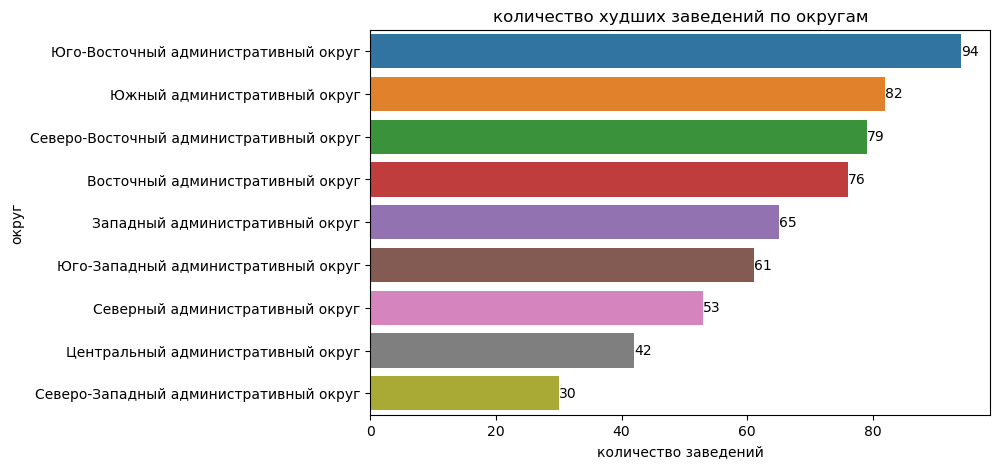

In [165]:
# датафрейм для создания визуализации по категориям
bad_by_district = (
    bad.pivot_table(index='district', values='unique_place', aggfunc='nunique')
    .reset_index()
    .sort_values(by='unique_place', ascending=False)
)

# визуализация
fig = plt.figure(figsize=(8, 5))
ax = sns.barplot(x='unique_place',
                 y='district',
                 data=bad_by_district)
ax.set_title('количество худших заведений по округам')
ax.set(xlabel='количество заведений')
ax.bar_label(ax.containers[0])
ax.set(ylabel='округ');

Больше всего заведений с низкими оценками в ЮВАО. Следом идут ЮАО, СВАО, ВАО. Таким образом, восток и юго-восток получается действительно менее благополучным, чем север и северо-запад.

<Figure size 800x500 with 0 Axes>

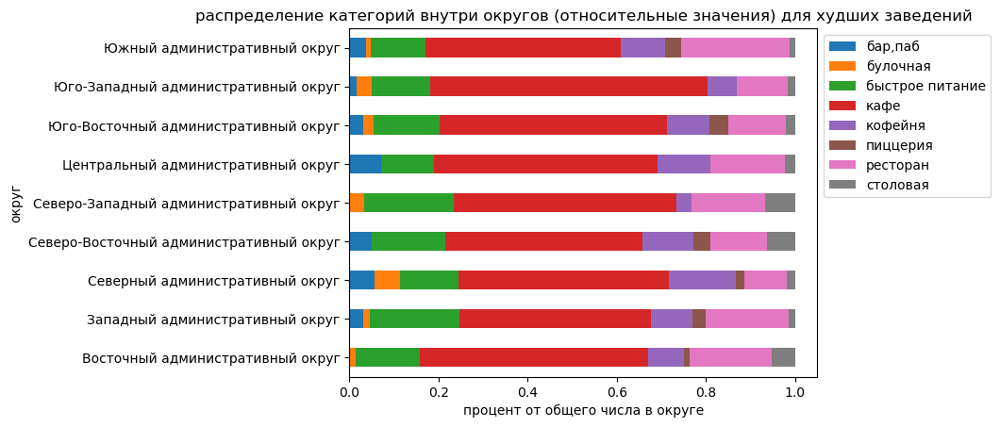

In [166]:
bad_grouped = (
    bad.groupby(['district', 'category'])['unique_place'].count()/
    bad.groupby('district')['unique_place'].count()
)
bad_grouped = pd.DataFrame(bad_grouped.unstack())

fig = plt.figure(figsize=(8, 5))
ax = (
    bad_grouped
    .plot(kind = 'barh', stacked=True, title='распределение категорий внутри округов (относительные значения) для худших заведений')
)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
ax.set(ylabel='округ')
ax.set(xlabel='процент от общего числа в округе')
plt.show();


По этому графику видно, что чаще всего плохие оценки получают кафе, а реже всего - пиццерии. Баров, булочных и столовых относительно немного в этом распределнии.

---

In [167]:
bad_chains = bad.pivot_table(index='chain', values='unique_place', aggfunc='count').reset_index()

bad_chains['percent'] = (
    round(bad_chains['unique_place'] / sum(bad_chains['unique_place']) * 100, 1)
                                                    )

bad_chains = (
                bad_chains.replace(
                    {"chain": 
                    {True: "chain",
                     False: "not chain"}
                    }
                )
)
bad_chains

,chain,unique_place,percent
0,not chain,421,72.3
1,chain,161,27.7


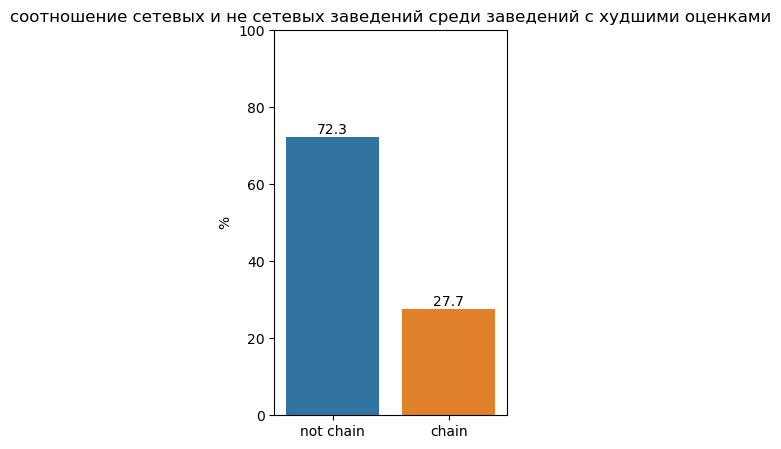

In [169]:
fig = plt.figure(figsize=(3, 5))

ax = sns.barplot(x='chain',
                 y='percent',
                 data=bad_chains)
ax.set_title('соотношение сетевых и не сетевых заведений среди заведений с худшими оценками')
ax.set(ylabel='%')
ax.bar_label(ax.containers[0])
ax.set(xlabel='')
ax.set(ylim=(0, 100));

Вопреки ожиданиям, среди заведений с более плохими оценками также похожее распределение, несколько отличное от общего по датасету - так же больше несетевых заведений. По-видимому, многие несетвые заведения не справляются с высокими стандартами обслуживания. 

---


#### Часы работы

**24/7**

Высяним, сколько заведений с графиком 24/7.

In [170]:
all_day = data.loc[data['is_24/7'] == True]
print(f'количество заведений с графиком 24/7: {len(all_day)} - {round(len(all_day)/len(data), 2)}% от общего числа')

количество заведений с графиком 24/7: 737 - 0.09% от общего числа


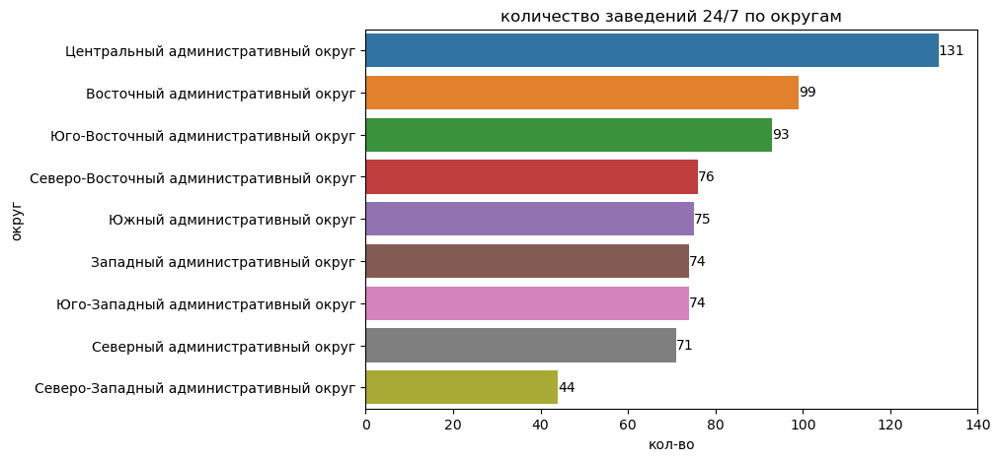

In [171]:
all_day_districts = (
    all_day
    .pivot_table(index='district', values='unique_place', aggfunc='nunique')
    .reset_index()
    .sort_values(by='unique_place', ascending=False)
)

fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='unique_place',
                 y='district',
                 data=all_day_districts)
ax.set_title('количество заведений 24/7 по округам')
ax.set(xlabel='кол-во')
ax.set(ylabel='округ')
ax.bar_label(ax.containers[0])
ax.set(xlim=(0,140));

Больше всего в центре - это закономерно; меньше всего - в СЗАО - тоже закономерно, потому что там и меньше заведений в принципе. 

<Figure size 800x500 with 0 Axes>

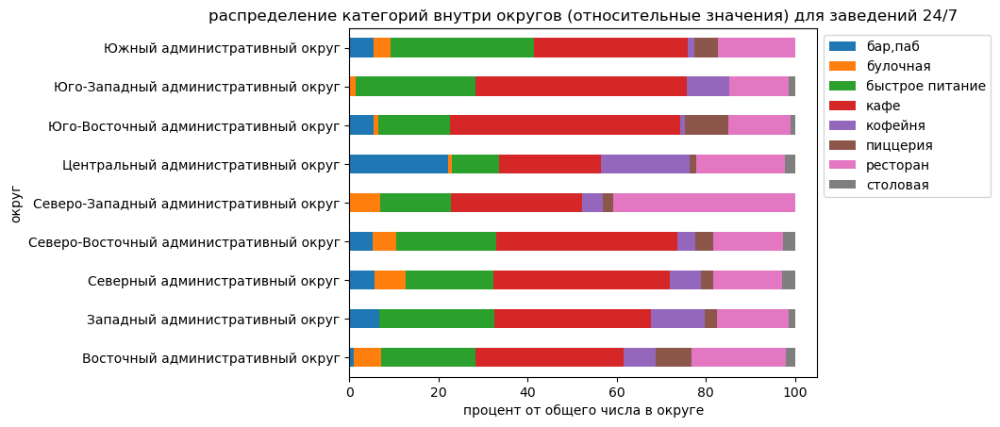

In [172]:
all_day_districts_share = (
    round(all_day.groupby(['district', 'category'])['unique_place'].count()/
    all_day.groupby(['district'])['category'].count() * 100, 2)
)
all_day_districts_share = pd.DataFrame(all_day_districts_share.unstack())


fig = plt.figure(figsize=(8, 5))
ax = (
    all_day_districts_share
    .plot(kind = 'barh', stacked=True, title='распределение категорий внутри округов (относительные значения) для заведений 24/7')
)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
ax.set(ylabel='округ')
ax.set(xlabel='процент от общего числа в округе')
plt.show();

Распределения различны для всех округов, но моэно сказать, что почти всегда большую долю занимает кафе. Исключение составляет конечно же центр, с большей долей баров, а также СЗАО с неожиданно большой долей круглосуточных ресторанов. 

---

Посмотрим, как распределены оценки круглосуточных заведений в сравнении со всем датасетом. 

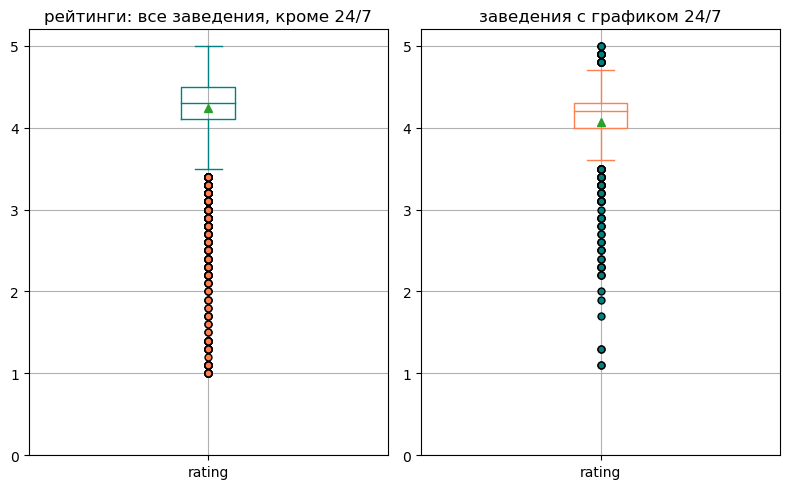

In [173]:
data_other = data.loc[data['is_24/7'] != True]

fig, axs = plt.subplots(1, 2, figsize=(8, 5))

ax1 = plt.subplot(1, 2, 1)
flierprops=dict(marker='o', markerfacecolor='coral', markersize=5,
                  linestyle='none')
ax1 = data_other['rating'].plot(
    kind='box', 
    subplots=True, 
    figsize=(5,5),
    grid=True, 
    xlabel='рейтинг', 
    color='teal',
    flierprops=flierprops, 
    showmeans=True
);
plt.ylim(ymin=0, ymax = 5.2)
plt.tight_layout()
plt.title('рейтинги: все заведения, кроме 24/7')

ax2 = plt.subplot(1, 2, 2)
flierprops=dict(marker='o', markerfacecolor='teal', markersize=5,
                  linestyle='none')
ax2 = all_day['rating'].plot(
    kind='box', 
    subplots=True, 
    figsize=(5,5),
    grid=True, 
    xlabel='рейтинг', 
    color='coral',
    flierprops=flierprops, 
    showmeans=True
);
plt.ylim(ymin=0, ymax = 5.2)
plt.tight_layout()
plt.title('заведения с графиком 24/7')
plt.show()

"Нормальные значения" рейтингов заведений 24/7 заканчиваются примерно на том же уровне, что и у остальных заведений, однако верхняя граница заканчивается несколько раньше (у остальных вместе взятых доходит прямо до 5 - максимальной оценки). В целом можно сказать, что график работы не сильно сказывается на оценке. 

---

Сравним показатели среднего чека для заведений 24/7 и остальных. 

In [174]:
# мы не смодем сравнить абсолютные значения, потому что остальных оценок гораздо больше
# можно попробовать сравнить долю оценки среди всех оценок по категории времени работы

data_other_rating = (
    data_other
    .pivot_table(index='rating', values='unique_place', aggfunc='count')
    .reset_index()
)
data_other_rating['percent'] = (
    round(data_other_rating['unique_place']/sum(data_other_rating['unique_place']) * 100, 2)
)
data_other_rating['data'] = 'все остальные часы работы'

all_day_rating = (
    all_day
    .pivot_table(index='rating', values='unique_place', aggfunc='count')
    .reset_index()
)
all_day_rating['percent'] = (
    round(all_day_rating['unique_place']/sum(all_day_rating['unique_place']) * 100, 2)
)
all_day_rating['data'] = '24/7'

ratings_ratio = pd.concat([data_other_rating, all_day_rating]).reset_index()

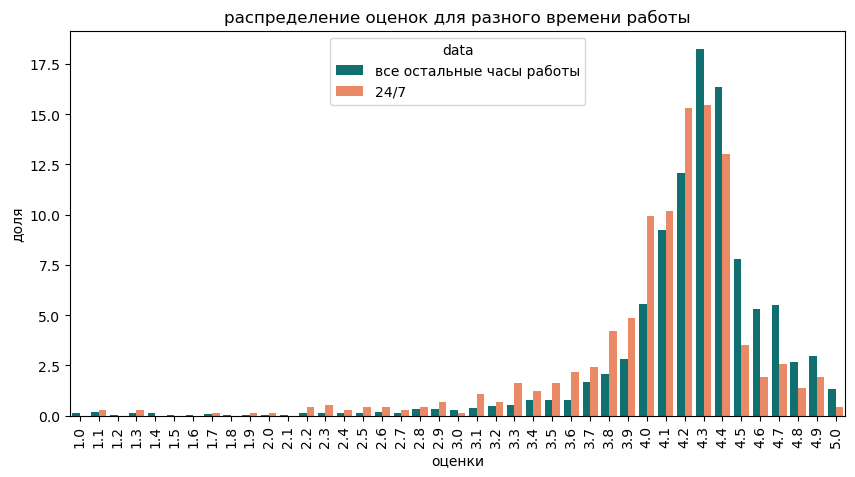

In [175]:
# визуализация
fig = plt.figure(figsize=(10, 5))
ax = sns.barplot(x='rating',
                 y='percent',
                 hue='data',
                 data=ratings_ratio, 
                 palette=('teal', 'coral'))
ax.set_title('распределение оценок для разного времени работы')
ax.set(xlabel='оценки')
ax.set(ylabel='доля')
plt.xticks(rotation=90);

Распределения очень похожи, однако видно, что "остальные часы работы" смещены немного правее, а в районе оценок 4.3 и 4.4 имеют более выраженный пик (то есть доля таких оценок выше).

---

**Все часы работы**

Выведем самые популряные часы работы, не учитывая тех заведений, где часы не указаны.

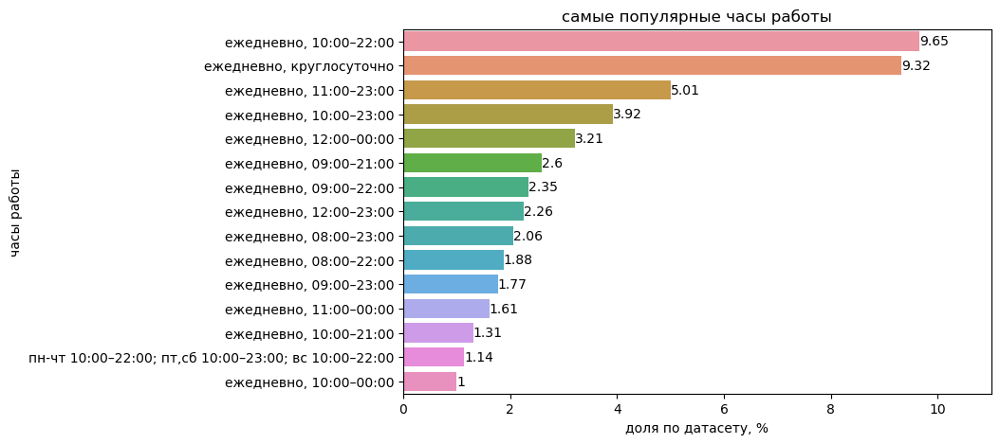

In [176]:
hours = (
    data.query('hours != "unknown"').pivot_table(index='hours', values='unique_place', aggfunc='count')
    .reset_index()
    .sort_values(by='unique_place', ascending=False)
)
hours['percent'] = round(hours['unique_place'] / sum(hours['unique_place']) * 100, 2)


fig = plt.figure(figsize=(8, 5))

ax = sns.barplot(x='percent',
                 y='hours',
                 data=hours.head(15)
)
ax.set_title('самые популярные часы работы')
ax.set(xlabel='доля по датасету, %')
ax.set(ylabel='часы работы')
ax.bar_label(ax.containers[0])
ax.set(xlim=(0,11));

Самые популярные часы работы - ежедневные. Самое простое - 10-22 и 24/7 - очевидно, самые поплярные варианты. В остальном понятно, что чем чаще и дольше график работы, тем таких заведений больше.

----

Самые популярные часы работы по округам

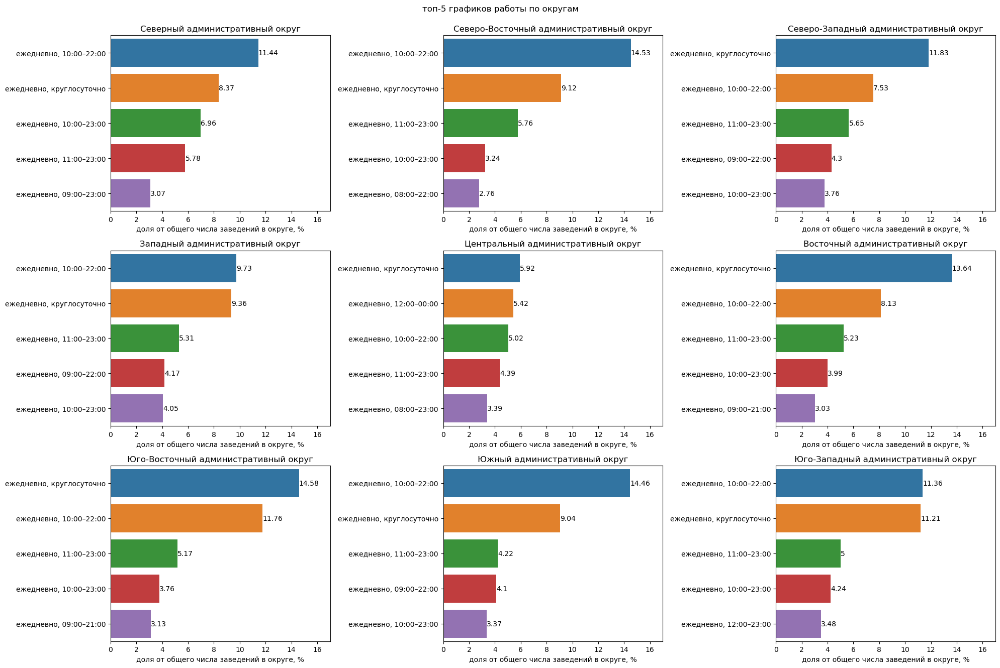

In [182]:
hours_data = data.query('hours != "unknown"')

fig, axes = plt.subplots(ncols=3, nrows=3, figsize=(20,13))

for i, dist in enumerate(districts):
    dist_data = hours_data.query('district == @dist')
    hours = list((
            dist_data
            .pivot_table(index='hours', values='unique_place', aggfunc='count')
            .reset_index()
            .sort_values(by='unique_place', ascending=False)
            .head(5)
            )['hours'])
    filtered = dist_data.loc[dist_data['hours'].isin(hours) == True]
    filtered = (
        filtered
        .pivot_table(index='hours', values='unique_place', aggfunc='count')
        .reset_index()
        .sort_values(by='unique_place', ascending=False)
    )
    filtered['percent'] = round(filtered['unique_place'] / dist_data['unique_place'].count() * 100, 2)
    ax = axes[int(i/3), i%3]
    sns.barplot(
        x='percent',
        y='hours',
        data=filtered,
        ax=ax)
    ax.set_title(dist)
    ax.set(xlabel='доля от общего числа заведений в округе, %')
    ax.set(ylabel='')
    plt.tight_layout()
    ax.bar_label(ax.containers[0])
    ax.set(xlim=(0,17));
    
fig.suptitle('топ-5 графиков работы по округам', y=1.02);

Круглосутчоные заведения на первом месте не только в центре, но и ВАО, ЮВАО и СЗАО. В топ по всем округам попали только ежедневно открытые завдеедния с одинаковым графиком каждый день.

----

Самые популярные часы работы по категориям

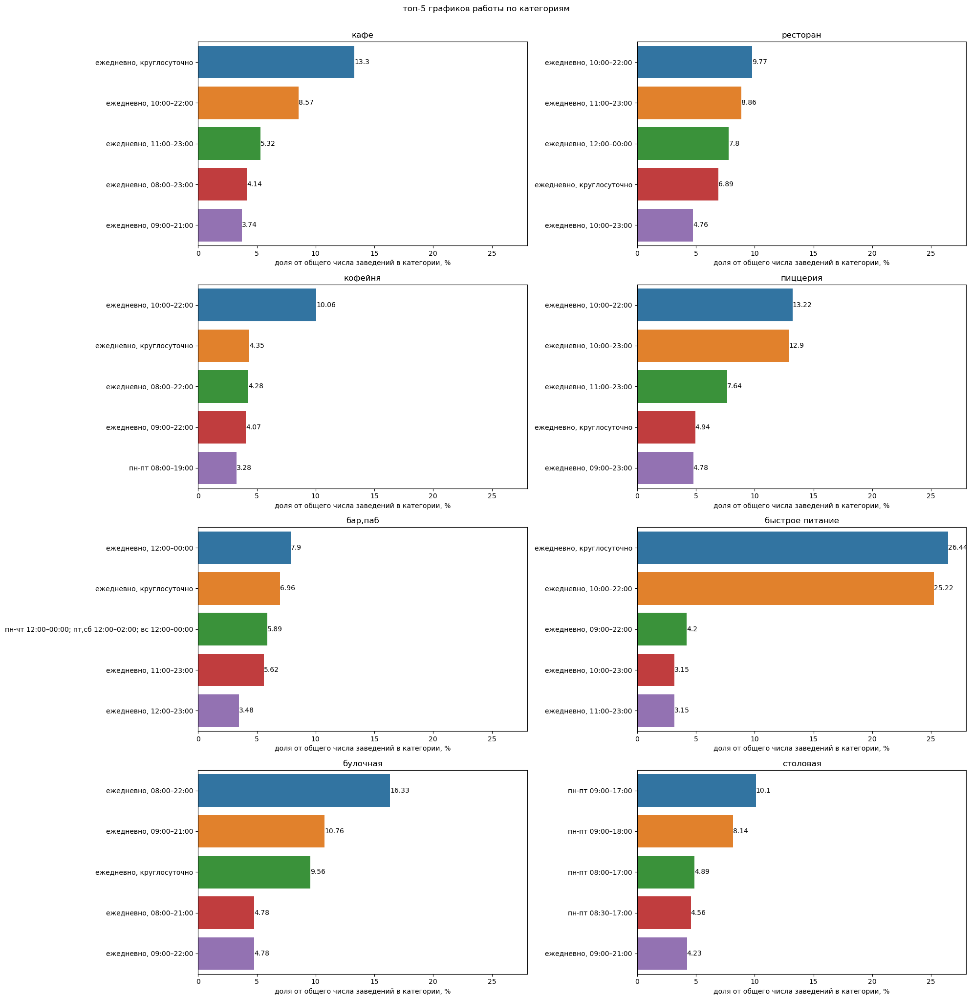

In [183]:
fig, axes = plt.subplots(ncols=2, nrows=4, figsize=(20,20))

for i, cat in enumerate(categories):
    cat_data = hours_data.query('category == @cat')
    hours = list((
            cat_data
            .pivot_table(index='hours', values='unique_place', aggfunc='count')
            .reset_index()
            .sort_values(by='unique_place', ascending=False)
            .head(5)
            )['hours'])
    filtered = cat_data.loc[cat_data['hours'].isin(hours) == True]
    filtered = (
        filtered
        .pivot_table(index='hours', values='unique_place', aggfunc='count')
        .reset_index()
        .sort_values(by='unique_place', ascending=False)
    )
    filtered['percent'] = round(filtered['unique_place'] / cat_data['unique_place'].count() * 100, 2)
    ax = axes[int(i/2), i%2]
    sns.barplot(
        x='percent',
        y='hours',
        data=filtered,
        ax=ax)
    ax.set_title(cat)
    ax.set(xlabel='доля от общего числа заведений в категории, %')
    ax.set(ylabel='')
    ax.bar_label(ax.containers[0])
    plt.tight_layout()
    ax.set(xlim=(0,28));
    
fig.suptitle('топ-5 графиков работы по категориям', y=1.02);

Самый большой процент заведений 24/7 - в категориях кафе и быстрое питание. У быстрого питания наиболее большая разнциа первых двух мест - по графикам 24/7 и 10-22 работают примерно по четверти заведений. 

Среди кофеен, пиццерий и ресторанов также популярнее всего график 10-22, а бары чаще роботают до полуночи или вообще круглосуточно. 

### общие выводы по разделу

- Всего в датасете 8403 заведения, разбитых по восьми категориям: рестораны, кафе, кофейни, пиццерии, быстрое питание, булочные, бары, столовые.

- Самые больше категории - кафе (28%), рестораны(24%) и кофейни(17%). Бары, быстрое питание и пиццерии занимают от 7% до 9%. Меньше всего булочных и столовых - по 3-4%

- "Нормальные значения" посадочных мест - от 0 до 200. Среднее значение количества посадочных мест варьируется в зависимости от категории заведения - примерно от 70 до 90. Медианное значение - примерно от 50 до 80. Больше всего мест в среднем в ресторанах - около 100, меньше всего в булочных  - 60. 

- Входит в сети 3089 заведений; не входит - 5314.

- В сети кофеен, ресторанов и кафе входит примерно по 700 заведений. В пиццерии - меньше более чем в два раза - 344; В быстром питании, булочных и барах - от 150 до 190 заведений. Столовых меньше всего - 92.

- UPD: **Самый большой процент сетевых заведений внутри категории - среди булочных (59%), пиццерий(54%) и кофеен (52%). Меньше всего сетевых баров (22%). Сетевых заведений среди столовых и кафе - около 29%, а среди ресторанов и быстрого питания - от 32% до 34%.**

- Топ-15 сетей по количеству заведений:
     - 'Шоколадница',
     - "Домино'с Пицца",
     - 'Додо Пицца',
     - 'One Price Coffee',
     - 'Яндекс Лавка',
     - 'Cofix',
     - 'Prime',
     - 'КОФЕПОРТ',
     - 'Кулинарная лавка братьев Караваевых',
     - 'Теремок',
     - 'CofeFest',
     - 'Буханка',
     - 'Drive Café',
     - 'Кофемания',
     - 'Cinnabon'

- В топ-15 больше всего кофеен - 7. 

- Заведения в ЦАО занимают больше четверти датасета. Меньше всего в СЗАО - около 5%. Остальные районы различаются несильно - от 8% до 11% от общего числа.

- В центральном округе больше баров и ресторанов, чем в остальных. Обычных кафе больше в Юго-Восточном и Восточном округах. В этих же округах чуть меньше кофеен, чем в других. Также в центральном округе меньше всего булочных и пиццерий.

- В среднем рейтинги по категориям очень похожи. И не опускаются ниже четырех. Выше всего - у баров - 4.39, а ниже всего у быстрого питания - 4.05

- Средние рейтинги по округам тоже не очень разнятся и колеблятся лишь от 4.1 (Юго-Восточный) до 4.38 (Центральный).

- По количеству заведений на одной улице с большим отрывом лидирует Проспект Мира. Большинство улиц в топ-15 - это шоссе и проспекты, но 15 месте одно из самых популярных ресторанных мест города - Пятницкая улица, которая  находится в центре. Вот топ-15 улиц:
     - ' проспект Мира',
     - ' Профсоюзная улица',
     - ' проспект Вернадского',
     - ' Ленинский проспект',
     - ' Ленинградский проспект',
     - ' Дмитровское шоссе',
     - ' Каширское шоссе',
     - ' Варшавское шоссе',
     - ' Ленинградское шоссе',
     - ' МКАД',
     - ' Люблинская улица',
     - ' улица Вавилова',
     - ' Кутузовский проспект',
     - ' улица Миклухо-Маклая',
     - ' Пятницкая улица'

- Улиц с одним заведением - 458. Чаще всего это кафе (35%), в два раза реже - рестораны и кофейни. Если смотреть по доле таких заведений внутри категории, то чаще всего такие заведения - это столовые (12% от категории), кафе и кофейни - около 6%. Чаще всего такие заведения - в ЦАО, но там и много улиц, а изображение на тепловой карте помогает понять, что концентрация заведений все равно высокая. 

- Cамый высокий медианный чек - у ЦАО И ЗАО - 1000 рублей. Самый низкий - ЮВАО - 450 рублей. В целом центр, север и запад дороже юга и востока города. 

- Самый высокий медианный чек по категориям - бары и рестораны - по 1250 рублей. Самый низкий - быстрое питание и столовые - 375 и 300 рублей. 

- Средний чек в ресторанах и барах дороже в любом округе. Так как и столовые - дешевле всего в каждом округе. Но вот в середине распределения средний чек заведений выше в центральном округе, что тоже закономерно - там дороже любой тип заведений. Север и запад чуть дороже остальных, кроме центра, в том числе и по заведениям в середине рейтинга по размеру среднего чека.

- По всему датасету есть небольшая зависимость медленного чека от расстояния до центра города. Все столовые недорогие, вне зависимости, далеко они от центра или нет. А вот Булочные, судя по графику, дороже именно в центра и примерно в два раза дешевле на окраине. Также более высокую зависимость можно наблюдать у кофеен и пиццерий. Небольшая зависимость еще у кафе и заведений быстрого питания.

- По всему датасету есть взаимосвязь между средним чеком и рейтингом заведений (чем выше чек, тем выше оценка), но она несильная. Наибольшую зависимость можно ожидаемо наблюдать в ЦАО, САО, ЮЗАО.

- Можно считать обычными оценки от 3.65 до 4.85. С оценками выше - 348 заведений. Больше всего высоких оценок в ЦАО (86), а так же 74% заведений с такими оценками - несетевые. Заведений с оценками ниже 3.65 - 582. Больше всего их в ЮВАО  и ЮАО (94, 82), чаще всего это кафе, несетевых заведений среди этого числа - 72%.

- Примерно 1% заведений в датасете работает 24/7. Чаще всего это кафе, а в ЦАО - бары, в СЗАО - рестораны. График 24/7 не сильно меняет оценку заведений в худшую сторону.

- Самые частые часы работы заведений - "ежедневно с 10 до 22" и 24/7. Круглосутчоные заведения на первом месте не только в центре, но и ВАО, ЮВАО и СЗАО. В топ по всем округам попали только ежедневно открытые завдеедния с одинаковым графиком каждый день.

- Самый большой процент заведений 24/7 - в категориях кафе и быстрое питание. У быстрого питания наиболее большая разнциа первых двух мест - по графикам 24/7 и 10-22 работают примерно по четверти заведений. Среди кофеен, пиццерий и ресторанов также популярнее всего график 10-22, а бары чаще роботают до полуночи или вообще круглосуточно.

---

## Детализация исследования: открытие кофейни

Перед основными пунктами взглянем на статистики и корреляции по срезу с кофейнями.

In [184]:
ch = data.query('category == "кофейня"')

ch.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,seats
count,1413.000000,1413.000000,1413.000000,200.000000,521.000000,751.000000
mean,55.756130,37.599649,4.277282,614.210000,172.545106,111.199734
std,0.064374,0.089454,0.372250,501.083154,65.816633,127.837772
min,55.581907,37.371261,1.400000,0.000000,60.000000,0.000000
25%,55.719992,37.537096,4.100000,300.000000,124.000000,40.000000
50%,55.759599,37.599096,4.300000,400.000000,170.000000,80.000000
75%,55.796430,37.655903,4.400000,750.000000,225.000000,144.000000
max,55.920257,37.864105,5.000000,2500.000000,375.000000,1288.000000


Достаточно сильный разброс значений можно наблюдать только среди данных о среднем чеке и количестве мест. 

In [185]:
ch.corr()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats,is_24/7
lat,1.000000,-0.118957,0.019817,0.010066,-0.019321,-0.024264,-0.057299,-0.020257
lng,-0.118957,1.000000,0.044841,-0.085370,-0.108092,-0.092656,-0.103363,0.022159
rating,0.019817,0.044841,1.000000,0.189510,0.144380,-0.192178,-0.048259,-0.033821
middle_avg_bill,0.010066,-0.085370,0.189510,1.000000,NaN,0.283413,0.058767,0.426684
middle_coffee_cup,-0.019321,-0.108092,0.144380,NaN,1.000000,-0.076693,-0.017864,0.139273
chain,-0.024264,-0.092656,-0.192178,0.283413,-0.076693,1.000000,0.100348,0.142452
seats,-0.057299,-0.103363,-0.048259,0.058767,-0.017864,0.100348,1.000000,-0.038928
is_24/7,-0.020257,0.022159,-0.033821,0.426684,0.139273,0.142452,-0.038928,1.000000


Особо сильных зависимостей не наблюдается.

### Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?

In [186]:
print(f'всего кофеен в датасете: {len(ch)} - {round(len(ch)/len(data) * 100, 2)}%')

всего кофеен в датасете: 1413 - 16.82%


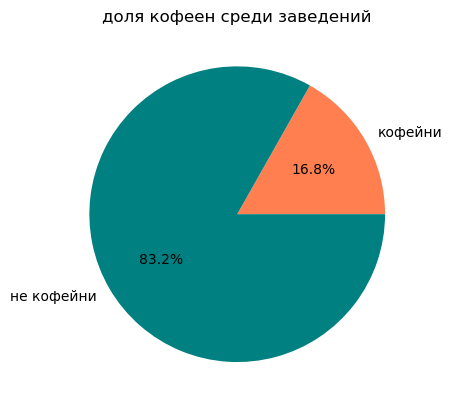

In [187]:
# визуализация

values = (len(ch), (len(data) - len(ch)))
labels = ('кофейни', 'не кофейни')
plt.title('доля кофеен среди заведений')
plt.pie(values, labels=labels, autopct='%1.1f%%', colors=('coral', 'teal'));

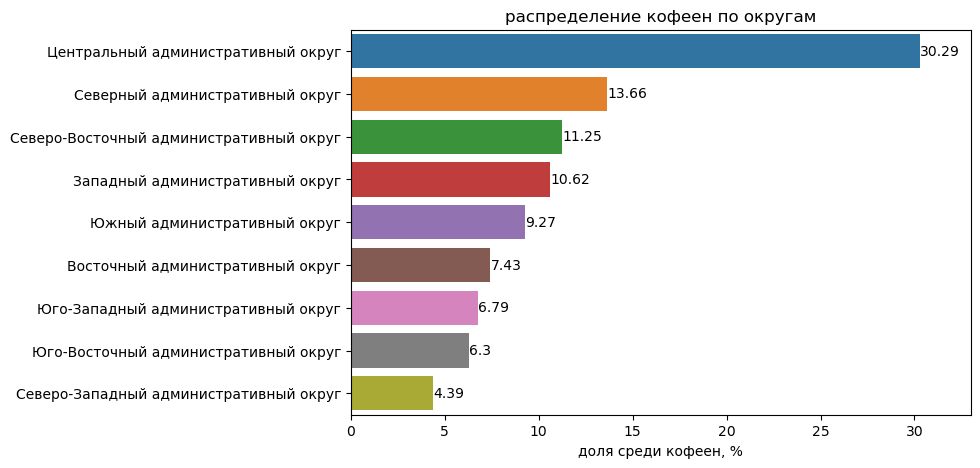

In [189]:
ch_dist = (
    pd.DataFrame(
        round(ch.groupby('district')['unique_place'].count() / 
              sum(ch.groupby(['district'])['unique_place'].count())*100, 2)
    )
).reset_index().sort_values(by='unique_place', ascending=False)

fig = plt.figure(figsize=(8, 5))
ax = sns.barplot(x='unique_place',
                 y='district',
                 data=ch_dist
)
ax.set_title('распределение кофеен по округам')
ax.set(xlabel='доля среди кофеен, %')
ax.set(ylabel='')
ax.bar_label(ax.containers[0])
ax.set(xlim=(0,33));

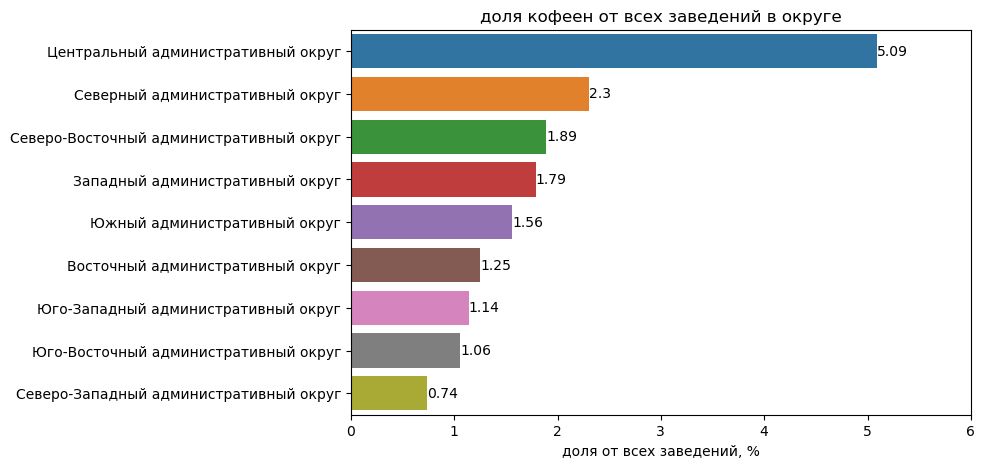

In [190]:
ch_dist_of_total = (
    pd.DataFrame(
        round(ch.groupby('district')['unique_place'].count() / 
              sum(data.groupby(['district'])['unique_place'].count())*100, 2)
    )
).reset_index().sort_values(by='unique_place', ascending=False)

fig = plt.figure(figsize=(8, 5))
ax = sns.barplot(x='unique_place',
                 y='district',
                 data=ch_dist_of_total
)
ax.set_title('доля кофеен от всех заведений в округе')
ax.set(xlabel='доля от всех заведений, %')
ax.set(ylabel='')
ax.bar_label(ax.containers[0])
ax.set(xlim=(0,6));

Больше всего кофеен в ЦАО. Меньше всего в СЗАО. В целом больше кофеен на севере и западе, кроме СЗАО, на востоке и юге в целом меньше.

Изобразим кофейни на карте.

In [191]:
from folium.plugins import HeatMap

m_lat, m_lng = 55.751244, 37.618423
m = Map(location=[m_lat, m_lng], zoom_start=11)

cp = Choropleth(
    geo_data=state_geo,
    data=rating_by_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='OrRd',
    fill_opacity=0
).add_to(m)

cp.geojson.add_child(
    folium.features.GeoJsonTooltip(
            fields=['name'],
            aliases=[''],
            style=("background-color: #daede8; color: black; font-family: arial; font-size: 12px; padding: 5px;") 
        )
)

for key in cp._children:
    if key.startswith('color_map'):
        del(cp._children[key])
        
cp.add_to(m)

lats_lngs = np.array(ch[['lat', 'lng']])

HeatMap(lats_lngs).add_to(m)

folium.LayerControl().add_to(m)

m

При отдаленном рассмотрении может показаться, что вся Москва покрыта кофейнями. Найти место для кофейни действительно непросто, но это возможно.

---

Возьмем к примеру, Северо-Запданый округ. Там меньше всего кофеен, а значит можно занять эту нишу.
Ниже на карте оранжевыми кругами отмечено несколько мест, где кофеен явно не хватает, хотя на увеличенной карте казалось наоборот. 
 

In [192]:
m_lat, m_lng = 55.816908, 37.457542
m = Map(location=[m_lat, m_lng], zoom_start=12.1)

cp = Choropleth(
    geo_data=state_geo,
    data=rating_by_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='OrRd',
    fill_opacity=0
).add_to(m)

cp.geojson.add_child(
    folium.features.GeoJsonTooltip(
            fields=['name'],
            aliases=[''],
            style=("background-color: #daede8; color: black; font-family: arial; font-size: 12px; padding: 5px;") 
        )
)

for key in cp._children:
    if key.startswith('color_map'):
        del(cp._children[key])
        
cp.add_to(m)

lats_lngs = np.array(ch[['lat', 'lng']])

HeatMap(lats_lngs).add_to(m)

folium.CircleMarker(location=(55.858527,37.419004),radius=25, color='coral', fill_color='red').add_to(m)
folium.CircleMarker(location=(55.817897,37.429948),radius=28, color='coral', fill_color='red').add_to(m)
folium.CircleMarker(location=(55.796167,37.460332),radius=28, color='coral', fill_color='red').add_to(m)
folium.CircleMarker(location=(55.812568,37.399521),radius=20, color='coral', fill_color='red').add_to(m)
folium.CircleMarker(location=(55.846602,37.360039),radius=30, color='coral', fill_color='red').add_to(m)

folium.LayerControl().add_to(m)

m

 Чтобы сформилировать рекомендации для предпринимателей, добавим и другое предложение - кофейня в Юго-Восточном округе. В зависимости от угла зрения, любая опция может быть перспективной. Нанесем на карту несколько точек аналогично примеру выше. 

In [193]:
m_lat, m_lng = 55.689391, 37.737865
m = Map(location=[m_lat, m_lng], zoom_start=12.1)

cp = Choropleth(
    geo_data=state_geo,
    data=rating_by_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='OrRd',
    fill_opacity=0
).add_to(m)

cp.geojson.add_child(
    folium.features.GeoJsonTooltip(
            fields=['name'],
            aliases=[''],
            style=("background-color: #daede8; color: black; font-family: arial; font-size: 12px; padding: 5px;") 
        )
)

for key in cp._children:
    if key.startswith('color_map'):
        del(cp._children[key])
        
cp.add_to(m)

lats_lngs = np.array(ch[['lat', 'lng']])

HeatMap(lats_lngs).add_to(m)

folium.CircleMarker(location=(55.655026,37.699542),radius=24, color='coral', fill_color='red').add_to(m)
folium.CircleMarker(location=(55.677524,37.749077),radius=23, color='coral', fill_color='red').add_to(m)
folium.CircleMarker(location=(55.707542,37.765085),radius=28, color='coral', fill_color='red').add_to(m)

folium.LayerControl().add_to(m)

m

---

Нанесем на карту так же просто все точки кофеен в Москве.

In [194]:
m_lat, m_lng = 55.751244, 37.618423
m = Map(location=[m_lat, m_lng], zoom_start=11)

marker_cluster = MarkerCluster().add_to(m)

# функция для создания кластеров по строке датафрейма
def create_clusters(row):
    icon_url = 'https://img.icons8.com/fluency/512/kawaii-coffee.png'  
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['category']} {row['name']} {row['rating']}", 
        icon=icon
    ).add_to(marker_cluster)

ch.apply(create_clusters, axis=1)

m

Итак, больше всего кофеен в центре. Места притяжения кофеен - жилые районы и проходные места. Пропуски на тепловой карте обычно совпадают с крупными развязками, магистралями, промзонами, где кофейням неоткуда и взяться, и где они не нужны. И тем не менее при приближении можно убедиться, что до сих пор в городе есть "белые пятна", где кофейни можно было бы разместить.

### Есть ли круглосуточные кофейни?

In [195]:
all_day_ch = ch.loc[ch['is_24/7'] == True]
print(f'количество круглосуточных кофеен: {len(all_day_ch)} - {round(len(all_day_ch)/len(ch) * 100, 2)}%')

количество круглосуточных кофеен: 61 - 4.32%


In [196]:
all_day_ch_grouped = (
    all_day_ch.pivot_table(index=('name', 'chain'), values='unique_place', aggfunc='count')
    .reset_index()
    .sort_values(by='unique_place', ascending=False)
)
all_day_ch_grouped

,name,chain,unique_place
21,Шоколадница,True,17
16,Кофемания,True,8
9,Wild Bean Cafe,True,8
8,Wild Bean,True,5
13,Кофе Хауз,True,3
10,You&coffee,True,2
1,Cofix,True,2
14,Кофе с собой,True,2
20,Столица,False,1
19,Пирог Хауз,True,1


In [197]:
all_day_ch_grouped = (
    all_day_ch.pivot_table(index=('unique_place', 'chain'), values='name', aggfunc='count')
    .reset_index()
    .sort_values(by='unique_place', ascending=False)
)

all_day_ch_grouped_chain = all_day_ch_grouped.groupby(['chain']).agg('count').reset_index()
all_day_ch_grouped_chain = all_day_ch_grouped_chain.replace({'chain':{False: 'не сетевые', True: 'сетевые'}})
all_day_ch_grouped_chain

,chain,unique_place,name
0,не сетевые,9,9
1,сетевые,52,52


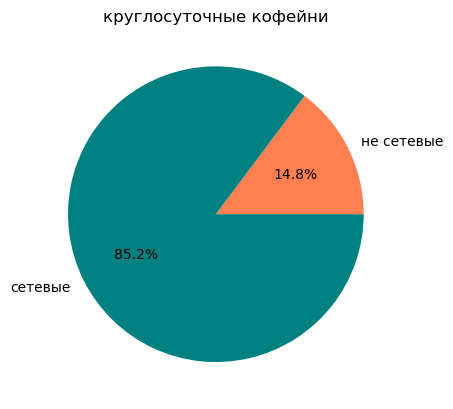

In [198]:
labels = list(all_day_ch_grouped_chain['chain'])
values = list(all_day_ch_grouped_chain['name'])
plt.title('круглосуточные кофейни')
plt.pie(values, labels=labels, autopct='%1.1f%%', colors=('coral', 'teal'));

Есть 61 круглосуточная кофеня, причем большинство их них - сетевые. 

### Какие у кофеен рейтинги? Как они распределяются по районам?

In [199]:
print(f'средний рейтинг кофеен для всего датасета: {round(ch["rating"].mean(), 2)}')

средний рейтинг кофеен для всего датасета: 4.28


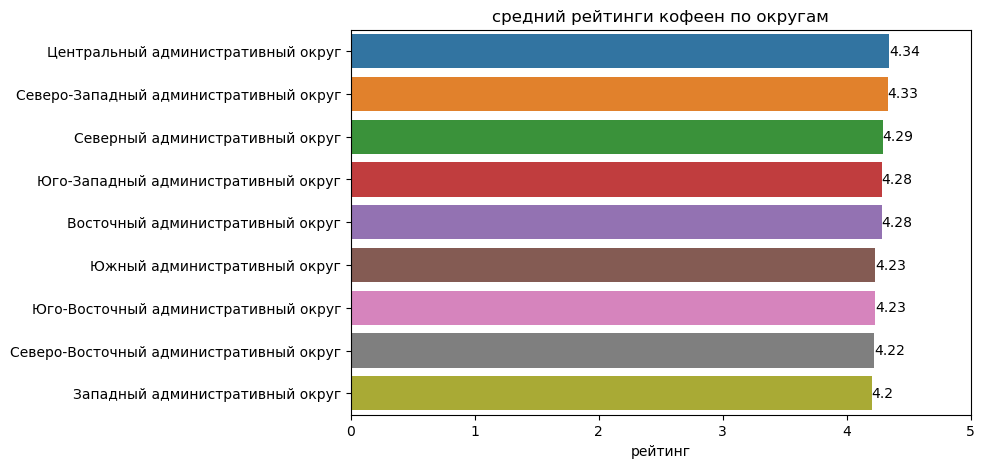

In [200]:
ch_rating = (
    ch.pivot_table(index='district', values='rating', aggfunc='mean')
    .reset_index()
    .sort_values(by='rating', ascending=False)
)
ch_rating['rating'] = round(ch_rating['rating'], 2)

fig = plt.figure(figsize=(8, 5))
ax = sns.barplot(x='rating',
                 y='district',
                 data=ch_rating
)
ax.set_title('средний рейтинги кофеен по округам')
ax.set(xlabel='рейтинг')
ax.set(ylabel='')
ax.bar_label(ax.containers[0])
ax.set(xlim=(0,5));

Рейтинги по окургам очень похожи. Выше всего - в Центральном (4.34) и Северо-Западном (4.33). Ниже всего - в Западном (4.2).

### На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

In [201]:
print(f'медианная стоимость чашки капучино в кофейне: {ch["middle_coffee_cup"].median()} рублей')

медианная стоимость чашки капучино в кофейне: 170.0 рублей


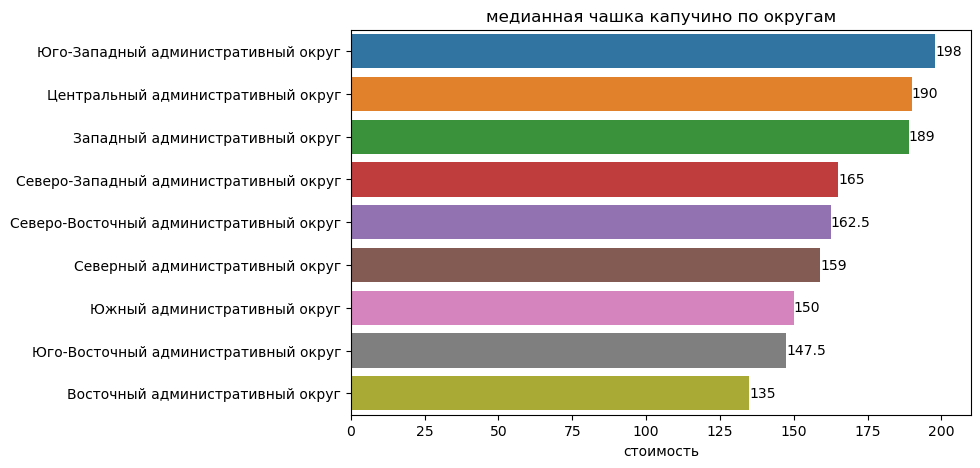

In [202]:
ch_cup = (
    ch.pivot_table(index='district', values='middle_coffee_cup', aggfunc='median')
    .reset_index()
    .sort_values(by='middle_coffee_cup', ascending=False)
)

fig = plt.figure(figsize=(8, 5))
ax = sns.barplot(x='middle_coffee_cup',
                 y='district',
                 data=ch_cup
)
ax.set_title('медианная чашка капучино по округам')
ax.set(xlabel='стоимость')
ax.set(ylabel='')
ax.bar_label(ax.containers[0])
ax.set(xlim=(0,210));

При ценообразовании в кофейне можно ориентироваться на множетсво факторов. Среди них также и средняя цена у конкурентов. В Москве - это в среднем 170 рублей, но зависит и от района. Если предприниматели решат открыть кофейню в центре или на севере и западе - цена может быть выше - в районе 200 рублей. Если на юге или востоке - ниже, в районе 150 рублей.

### Расстояние до центра

Проверим, как на среднюю стоимость чашки кофе и на среднюю оценку влияет расстояние до центра. 

In [204]:
ch_distance = ch[['unique_place', 'district', 'lat', 'lng', 'rating', 'chain', 'middle_coffee_cup']].copy()

ch_distance['distance'] = (
    distance_data
    .apply(lambda row: distance_calc(m_lat, m_lng, row['lat'], row['lng'], 1), axis=1)
)

corr = ch_distance['middle_coffee_cup'].corr(ch_distance['distance'])
print(f'коэф. корреляции между стоимостью чашки кофе и расстоянием до ценра для всех кофеен: {corr}')

коэф. корреляции между стоимостью чашки кофе и расстоянием до ценра для всех кофеен: -0.14828272776644613


Есть отрицательная корреляция, но она несильная. Вероятно, в сетевых кофейнях цены везде одинаковые. 

Проверим без сетевых. 

In [205]:
ch_not_chain = ch_distance.loc[ch_distance['chain'] != True]

corr = ch_not_chain['middle_coffee_cup'].corr(ch_not_chain['distance'])
print(f'коэф. корреляции между стоимостью чашки кофе и расстоянием до ценра для несетвых кофеен: {corr}')


коэф. корреляции между стоимостью чашки кофе и расстоянием до ценра для несетвых кофеен: -0.3041554143041204


Действительно так. Сделаем график, чтобы показать инвесторам: они не собирались открывать сетевую кофейню, а значит этот фактор им будет полезно учесть. 

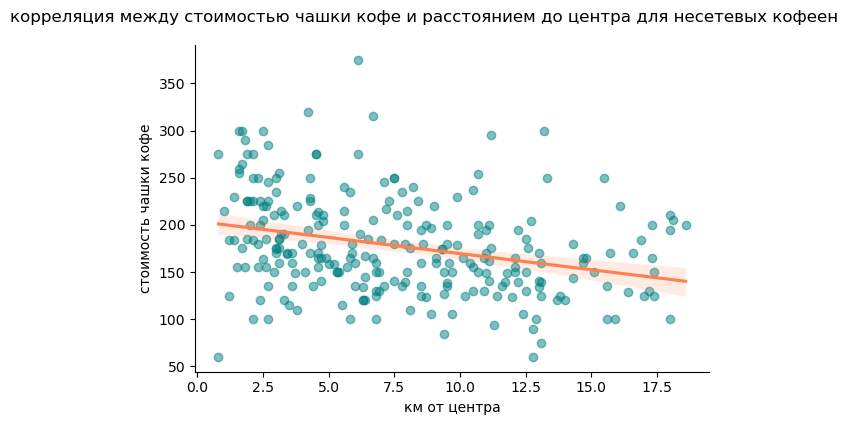

In [206]:
lm = (
    sns.lmplot(
    data=ch_not_chain, x="distance", y="middle_coffee_cup",
    height=4, aspect=1.5, 
    scatter_kws={'color': 'teal', 'alpha':0.5}, line_kws={'color': 'coral'}
).set_axis_labels('км от центра', 'стоимость чашки кофе')
    .fig
    .suptitle("корреляция между стоимостью чашки кофе и расстоянием до центра для несетевых кофеен", y=1.05)
);


In [208]:
corr = ch_distance['rating'].corr(ch_distance['distance'])
print(f'коэф. корреляции между рейтингом и расстоянием до ценра для всех кофеен: {corr}')

коэф. корреляции между рейтингом и расстоянием до ценра для всех кофеен: -0.09708664396555917


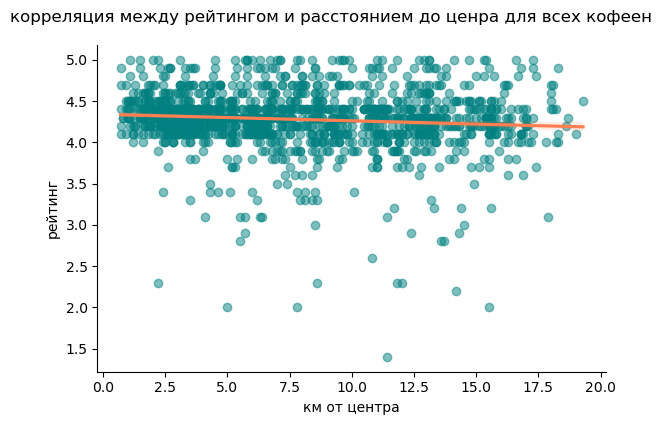

In [209]:
lm = (
    sns.lmplot(
    data=ch_distance, x="distance", y="rating",
    height=4, aspect=1.5, 
    scatter_kws={'color': 'teal', 'alpha':0.5}, line_kws={'color': 'coral'}
).set_axis_labels('км от центра', 'рейтинг')
    .fig
    .suptitle("корреляция между рейтингом и расстоянием до ценра для всех кофеен", y=1.05)
);

Можно сказать, что расстояние почти никак не влияет на рейтинг. 

### Конкуренция

Возможно инвесторам будет интересно узнать про конкуренцию кофеен в Москве. Например, на каких улицах уже много кофеен и как это влияет на чену чашки кофе в них. 

In [210]:
ch_streets = (
    ch.groupby(['street', 'district']).agg({'unique_place':['count'], 'middle_coffee_cup':['median']})
).reset_index()
ch_streets.columns = ch_streets.columns.droplevel(1)
ch_streets = ch_streets.sort_values(by='unique_place', ascending=False)
ch_streets.query('unique_place > 10')

,street,district,unique_place,middle_coffee_cup
217,Ленинградский проспект,Северный административный округ,25,180.0
490,проспект Мира,Северо-Восточный административный округ,19,180.0
221,Ленинский проспект,Юго-Западный административный округ,18,221.0
343,Профсоюзная улица,Юго-Западный административный округ,18,150.0
491,проспект Мира,Центральный административный округ,17,225.0
183,Каширское шоссе,Южный административный округ,16,140.0
488,проспект Вернадского,Западный административный округ,16,197.5
122,Варшавское шоссе,Южный административный округ,14,185.0
296,Новослободская улица,Центральный административный округ,13,127.5
218,Ленинградское шоссе,Северный административный округ,13,195.0


In [211]:
corr = round(ch_streets['unique_place'].corr(ch_streets['middle_coffee_cup']), 2)
print(
    f'коэф. корреляции между количеством заведений на улице и ценой чашки за кофе: {corr}')

коэф. корреляции между количеством заведений на улице и ценой чашки за кофе: 0.01


Можно сказать, что зависимости нет. Например, на улицах с более чем десятью кофейнями совершенно разные медианные цены - от 95 до 250 рублей. Таким образом, на цену влияют скорее всего другие факторы, а фактор конкуренции и соседтства нужно рассматривать более точно и конкретно для каждого случая. 

Выведем теперь топ самых дорогих улиц (c хотя бы несколькими заведениями).

In [212]:
ch_streets.query('unique_place > 1').sort_values(by='middle_coffee_cup', ascending=False).head(10)

,street,district,unique_place,middle_coffee_cup
89,Большая Никитская улица,Центральный административный округ,3,328.0
161,Енисейская улица,Северо-Восточный административный округ,2,287.0
396,Стремянный переулок,Центральный административный округ,2,285.0
270,Мясницкая улица,Центральный административный округ,4,283.0
618,улица Серпуховский Вал,Южный административный округ,2,275.0
434,Центральный административный округ,Центральный административный округ,4,275.0
317,Осенняя улица,Западный административный округ,2,270.0
372,Сельскохозяйственная улица,Северо-Восточный административный округ,8,266.5
222,Ленинский проспект,Южный административный округ,2,266.0
521,улица Большая Якиманка,Центральный административный округ,2,265.0


Большинство улиц из центрального округа, но встречаются и другие. Например, Сельскохозяйственная улица - это где-то в парке ВДНХ, неудивительно, что заведений несколько, да и еще они попали в топ. Таким образом, цены за чашку капучино обусловлены более широким контекстом, чем просто наличие конкурирующих заведений (в данном примере - большой поток клиентов и большой спрос).

### Посадочные места

Помня о том, что посадочные места указаны не везде, и о том, что среди значений посадочных мест были "выбросы", найдем "нормальное" для датасета значения посадочных мест в кофейне. 

In [213]:
array = np.array(list(ch.loc[(data['seats'].isnull() == False)]['seats']))

display(ch['seats'].describe())

q3, q1 = np.percentile(array, [75 ,25])
iqr = q3 - q1    
upper = round(q3 + 1.5 * iqr)
lower = round(q1 - 1.5 * iqr)

print(f'нижняя граница нормальных значений: {upper}')
print(f'верхняя граница нормальных значений: {lower}')

count     751.000000
mean      111.199734
std       127.837772
min         0.000000
25%        40.000000
50%        80.000000
75%       144.000000
max      1288.000000
Name: seats, dtype: float64

нижняя граница нормальных значений: 300
верхняя граница нормальных значений: -116


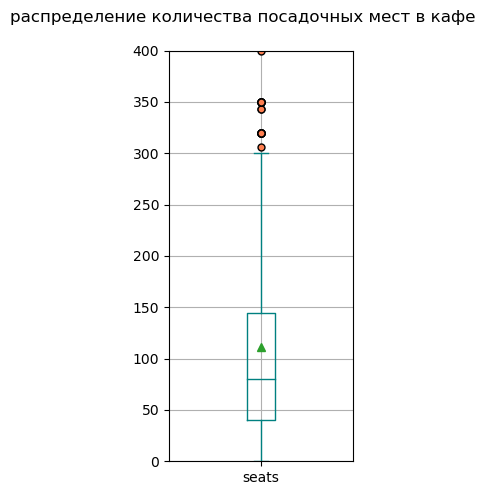

In [214]:
flierprops=dict(marker='o', markerfacecolor='coral', markersize=5,
                  linestyle='none')

fig = plt.figure(figsize=(2.5, 5))
ch['seats'].plot(
    kind='box', 
    subplots=True, 
    figsize=(5,5),
    grid=True, 
    xlabel='seats', 
    title='распределение количества посадочных мест в кафе', 
    color='teal',
    flierprops=flierprops, 
    showmeans=True
);
plt.ylim(ymin=0, ymax = 400)
plt.tight_layout()
plt.show()

Судя по рассчетам, "нормальные значения" могут достигать и 300 мест. Но нам видится это слишком большим показателем. Возможно, данные по местам несколько завышены, а мы не можем устранить аномалии более точно. В таком случае проще ориентироваться на медиану - около 80 мест, ну и еще руководствоваться здравым смыслом. 

---

### Общие выводы

- Всего кофеен в датасете: 1413 - это  16.82% от общего числа заведений. 

- Больше всего кофеен в ЦАО. Меньше всего в СЗАО. В целом больше кофеен на севере и западе, кроме СЗАО, на востоке и юге в целом меньше.

- При отдаленном рассмотрении может показаться, что вся Москва покрыта кофейнями. Найти место для кофейни действительно непросто, но это возможно. На примере с СЗАО и ЮВАО мы нашли неплохие места для новых заведений в этих округах и добавим объяснения в рекомендации предпринимателям ниже. 

- Места притяжения кофеен - жилые районы и "проходные" места. Пропуски на тепловой карте обычно совпадают с крупными развязками, магистралями, промзонами, где кофейням неоткуда и взяться, и где они не нужны. И тем не менее при приближении можно убедиться, что до сих пор в городе есть "белые пятна", где кофейни можно было бы разместить.

- Количество круглосуточных кофеен: 61 - это 4.32% от общего числа кофеен. В 85% случаев - это сетевые заведения. 

- Средний рейтинг кофеен для всего датасета: 4.28. Рейтинги по окургам очень похожи. Выше всего - в Центральном (4.34) и Северо-Западном (4.33). Ниже всего - в Западном (4.2)

- Медианная стоимость чашки капучино в кофейне: 170.0 рублей. При ценообразовании в кофейне можно ориентироваться на множетсво факторов. Среди них также и средняя цена у конкурентов. В Москве - это в среднем 170 рублей, но зависит и от района. Если предприниматели решат открыть кофейню в центре или на севере и западе - цена может быть выше - в районе 200 рублей. Если на юге или востоке - ниже, в районе 150 рублей.

- Есть корреляция между стоимостью чашки кофе и расстоянием до центра - чем дальше, тем дешевле. Корреляция сильнее для несетевых заведений, потому что у сетевых заведений цены как правило одни и те же, а заведения могут находиться как близко к центру, так и далеко. 

- Наличие других кофеен на улице не сильно влияет на цены - важен контекст. 

- В случае выбора количества мест лучше ориентироваться на медианное значение по датасету - это около 80 мест. 

---

### Рекомендации и предложения 

Мы рассмотрели данные по всему датасету, а так же детально по кофеням. Можем выдвинуть следующие предложения и рекомендации по открытию кофейни в Москве: 

- Инвесторы правы, конкуренция не страшна - много заведений находятся вплотную друг к другу, многие места пустуют. Важнее понимать запрос бизнеса и учитывать контекст кроме соседства заведений и конкуренции; 
- Кофейни занимают около 17% завдений общепита в Москве и получают средние хорошие оценки независимо от района - это перспективное направление; 
- Сетевых кофеен много и они могут держать более низкие цены в любом районе, но это не должно отпугивать бизнесменов - у несетевых заведений как правило оценки выше, а еще они могут подстраиваться под контекст места, устанавливая свою ценовую политику;
- Открывая кофейню лучше ориентироваться на режим работы "каждый день в одни и те же часы"; 
- Если инвесторы не боятся конкуренции, то открытие в центре - хорошее базовое решение. Но мы бы предложили два альтернативных варианта:

1) Северо-Западный округ: 
    
    - в этом округе в принципе мало заведений и мало кофеен, достаточно высокие цены, а значит заведений не    хватает; 
    - в этом округе есть перспективные места, где нет кофеен поблизости - можно максимизировать выручку за счет более низкой конкурецнии, а так же удовлетворить запросы местного коммюнити - в СЗАО так же как и везде    достаточно большие жилые массивы, включая новые районы, привлекательные для инвестиций; 
    - север и запад традиционно более благополучные районы, а значит можно по умолчанию рассчитывать на более   высокую выручку и удовлетворенность клиентов; 
    - в этом округе можно ориетироваться на цену чашки кофе в 170-200 рублей.
        
2) Юго-Восточный округ: 
    
    - в этом округе тоже мало кофеен, по сравнению с другими. Цены здесь ниже, значит можно рассчитывать на    более непритязательных клиентов. 
    - в этом районе есть скопления огромных жилмассивов, и, учитывая "белые пятна" на карте кофеен, можно       рассчитывать на большой поток клиентов; 
    - преследуя идею о классной кофейне для друзей, можно поддержать именно местное коммюнити и                деконструировать представление о Юге и Востоке столицы как о менее благополучных местах. К примеру, мы     отметили на карте потецниальное место для кофейни в микрорайоне Курьяново - там нет кофейни, а сам район    отрезан от другого железной дорогой, промзоной и рекой, хотя само место очень уютное - возомжно местным     жителям (или гостям и туристам?) не хватает как раз такой "кофейни для друзей"; 
    - в этом округе можно ориентироваться на цену чашки кофе в 150-180 рублей. 

## Презентация

Презентация: <https://drive.google.com/file/d/1evRWtWApSd8CAH88uieH66QFeq1-XyMA/view?usp=sharing> 

## Выводы

Мы проделали следующую работу: получили данные из датасета `/datasets/moscow_places.csv`, сделали обзор данных и подготовили их к анализу. Провели комплексный анализ данных. После этого детализировали исследование в контексте открытия кофейни по запросам заказчиков. В завершение - сформулировали общие выводы и подготовили презентацию для заказчиков.

---

**1. Выводы по разделу с исследовательским анализом данных:**

- Всего в датасете 8403 заведения, разбитых по восьми категориям: рестораны, кафе, кофейни, пиццерии, быстрое питание, булочные, бары, столовые.

- Самые больше категории - кафе (28%), рестораны(24%) и кофейни(17%). Бары, быстрое питание и пиццерии занимают от 7% до 9%. Меньше всего булочных и столовых - по 3-4%

- "Нормальные значения" посадочных мест - от 0 до 200. Среднее значение количества посадочных мест варьируется в зависимости от категории заведения - примерно от 70 до 90. Медианное значение - примерно от 50 до 80. Больше всего мест в среднем в ресторанах - около 100, меньше всего в булочных  - 60. 

- Входит в сети 3089 заведений; не входит - 5314.

- В сети кофеен, ресторанов и кафе входит примерно по 700 заведений. В пиццерии - меньше более чем в два раза - 344; В быстром питании, булочных и барах - от 150 до 190 заведений. Столовых меньше всего - 92.

- UPD: **Самый большой процент сетевых заведений внутри категории - среди булочных (59%), пиццерий(54%) и кофеен (52%). Меньше всего сетевых баров (22%). Сетевых заведений среди столовых и кафе - около 29%, а среди ресторанов и быстрого питания - от 32% до 34%.**

- Топ-15 сетей по количеству заведений:
     - 'Шоколадница',
     - "Домино'с Пицца",
     - 'Додо Пицца',
     - 'One Price Coffee',
     - 'Яндекс Лавка',
     - 'Cofix',
     - 'Prime',
     - 'КОФЕПОРТ',
     - 'Кулинарная лавка братьев Караваевых',
     - 'Теремок',
     - 'CofeFest',
     - 'Буханка',
     - 'Drive Café',
     - 'Кофемания',
     - 'Cinnabon'

- В топ-15 больше всего кофеен - 7. 

- Заведения в ЦАО занимают больше четверти датасета. Меньше всего в СЗАО - около 5%. Остальные районы различаются несильно - от 8% до 11% от общего числа.

- В центральном округе больше баров и ресторанов, чем в остальных. Обычных кафе больше в Юго-Восточном и Восточном округах. В этих же округах чуть меньше кофеен, чем в других. Также в центральном округе меньше всего булочных и пиццерий.

- В среднем рейтинги по категориям очень похожи. И не опускаются ниже четырех. Выше всего - у баров - 4.39, а ниже всего у быстрого питания - 4.05

- Средние рейтинги по округам тоже не очень разнятся и колеблятся лишь от 4.1 (Юго-Восточный) до 4.38 (Центральный).

- По количеству заведений на одной улице с большим отрывом лидирует Проспект Мира. Большинство улиц в топ-15 - это шоссе и проспекты, но 15 месте одно из самых популярных ресторанных мест города - Пятницкая улица, которая  находится в центре. Вот топ-15 улиц:
     - ' проспект Мира',
     - ' Профсоюзная улица',
     - ' проспект Вернадского',
     - ' Ленинский проспект',
     - ' Ленинградский проспект',
     - ' Дмитровское шоссе',
     - ' Каширское шоссе',
     - ' Варшавское шоссе',
     - ' Ленинградское шоссе',
     - ' МКАД',
     - ' Люблинская улица',
     - ' улица Вавилова',
     - ' Кутузовский проспект',
     - ' улица Миклухо-Маклая',
     - ' Пятницкая улица'

- Улиц с одним заведением - 458. Чаще всего это кафе (35%), в два раза реже - рестораны и кофейни. Если смотреть по доле таких заведений внутри категории, то чаще всего такие заведения - это столовые (12% от категории), кафе и кофейни - около 6%. Чаще всего такие заведения - в ЦАО, но там и много улиц, а изображение на тепловой карте помогает понять, что концентрация заведений все равно высокая. 

- Cамый высокий медианный чек - у ЦАО И ЗАО - 1000 рублей. Самый низкий - ЮВАО - 450 рублей. В целом центр, север и запад дороже юга и востока города. 

- Самый высокий медианный чек по категориям - бары и рестораны - по 1250 рублей. Самый низкий - быстрое питание и столовые - 375 и 300 рублей. 

- Средний чек в ресторанах и барах дороже в любом округе. Так как и столовые - дешевле всего в каждом округе. Но вот в середине распределения средний чек заведений выше в центральном округе, что тоже закономерно - там дороже любой тип заведений. Север и запад чуть дороже остальных, кроме центра, в том числе и по заведениям в середине рейтинга по размеру среднего чека.

- По всему датасету есть небольшая зависимость медленного чека от расстояния до центра города. Все столовые недорогие, вне зависимости, далеко они от центра или нет. А вот Булочные, судя по графику, дороже именно в центра и примерно в два раза дешевле на окраине. Также более высокую зависимость можно наблюдать у кофеен и пиццерий. Небольшая зависимость еще у кафе и заведений быстрого питания.

- По всему датасету есть взаимосвязь между средним чеком и рейтингом заведений (чем выше чек, тем выше оценка), но она несильная. Наибольшую зависимость можно ожидаемо наблюдать в ЦАО, САО, ЮЗАО.

- Можно считать обычными оценки от 3.65 до 4.85. С оценками выше - 348 заведений. Больше всего высоких оценок в ЦАО (86), а так же 74% заведений с такими оценками - несетевые. Заведений с оценками ниже 3.65 - 582. Больше всего их в ЮВАО  и ЮАО (94, 82), чаще всего это кафе, несетевых заведений среди этого числа - 72%.

- Примерно 1% заведений в датасете работает 24/7. Чаще всего это кафе, а в ЦАО - бары, в СЗАО - рестораны. График 24/7 не сильно меняет оценку заведений в худшую сторону.

- Самые частые часы работы заведений - "ежедневно с 10 до 22" и 24/7. Круглосутчоные заведения на первом месте не только в центре, но и ВАО, ЮВАО и СЗАО. В топ по всем округам попали только ежедневно открытые завдеедния с одинаковым графиком каждый день.

- Самый большой процент заведений 24/7 - в категориях кафе и быстрое питание. У быстрого питания наиболее большая разнциа первых двух мест - по графикам 24/7 и 10-22 работают примерно по четверти заведений. Среди кофеен, пиццерий и ресторанов также популярнее всего график 10-22, а бары чаще роботают до полуночи или вообще круглосуточно.

---

**2. Общие выводы по детализированному исследованию для открытия кофейни**

- Всего кофеен в датасете: 1413 - это  16.82% от общего числа заведений. 

- Больше всего кофеен в ЦАО. Меньше всего в СЗАО. В целом больше кофеен на севере и западе, кроме СЗАО, на востоке и юге в целом меньше.

- При отдаленном рассмотрении может показаться, что вся Москва покрыта кофейнями. Найти место для кофейни действительно непросто, но это возможно. На примере с СЗАО и ЮВАО мы нашли неплохие места для новых заведений в этих округах и добавим объяснения в рекомендации предпринимателям ниже. 

- Места притяжения кофеен - жилые районы и "проходные" места. Пропуски на тепловой карте обычно совпадают с крупными развязками, магистралями, промзонами, где кофейням неоткуда и взяться, и где они не нужны. И тем не менее при приближении можно убедиться, что до сих пор в городе есть "белые пятна", где кофейни можно было бы разместить.

- Количество круглосуточных кофеен: 61 - это 4.32% от общего числа кофеен. В 85% случаев - это сетевые заведения. 

- Средний рейтинг кофеен для всего датасета: 4.28. Рейтинги по окургам очень похожи. Выше всего - в Центральном (4.34) и Северо-Западном (4.33). Ниже всего - в Западном (4.2)

- Медианная стоимость чашки капучино в кофейне: 170.0 рублей. При ценообразовании в кофейне можно ориентироваться на множетсво факторов. Среди них также и средняя цена у конкурентов. В Москве - это в среднем 170 рублей, но зависит и от района. Если предприниматели решат открыть кофейню в центре или на севере и западе - цена может быть выше - в районе 200 рублей. Если на юге или востоке - ниже, в районе 150 рублей.

- Есть корреляция между стоимостью чашки кофе и расстоянием до центра - чем дальше, тем дешевле. Корреляция сильнее для несетевых заведений, потому что у сетевых заведений цены как правило одни и те же, а заведения могут находиться как близко к центру, так и далеко. 

- Наличие других кофеен на улице не сильно влияет на цены - важен контекст. 

- В случае выбора количества мест лучше ориентироваться на медианное значение по датасету - это около 80 мест.

---

**3. Рекомендации и предложения для заказчиков по детализированному исследованию для открытия кофейни**

Мы рассмотрели данные по всему датасету, а так же детально по кофеням. Можем выдвинуть следующие предложения и рекомендации по открытию кофейни в Москве: 

- Инвесторы правы, конкуренция не страшна - много заведений находятся вплотную друг к другу, многие места пустуют. Важнее понимать запрос бизнеса и учитывать контекст кроме соседства заведений и конкуренции; 
- Кофейни занимают около 17% завдений общепита в Москве и получают средние хорошие оценки независимо от района - это перспективное направление; 
- Сетевых кофеен много и они могут держать более низкие цены в любом районе, но это не должно отпугивать бизнесменов - у несетевых заведений как правило оценки выше, а еще они могут подстраиваться под контекст места, устанавливая свою ценовую политику;
- Открывая кофейню лучше ориентироваться на режим работы "каждый день в одни и те же часы"; 
- Если инвесторы не боятся конкуренции, то открытие в центре - хорошее базовое решение. Но мы бы предложили два альтернативных варианта:

1) Северо-Западный округ: 
    
    - в этом округе в принципе мало заведений и мало кофеен, достаточно высокие цены, а значит заведений не    хватает; 
    - в этом округе есть перспективные места, где нет кофеен поблизости - можно максимизировать выручку за счет более низкой конкурецнии, а так же удовлетворить запросы местного коммюнити - в СЗАО так же как и везде    достаточно большие жилые массивы, включая новые районы, привлекательные для инвестиций; 
    - север и запад традиционно более благополучные районы, а значит можно по умолчанию рассчитывать на более   высокую выручку и удовлетворенность клиентов; 
    - в этом округе можно ориетироваться на цену чашки кофе в 170-200 рублей.
        
2) Юго-Восточный округ: 
    
    - в этом округе тоже мало кофеен, по сравнению с другими. Цены здесь ниже, значит можно рассчитывать на    более непритязательных клиентов. 
    - в этом районе есть скопления огромных жилмассивов, и, учитывая "белые пятна" на карте кофеен, можно       рассчитывать на большой поток клиентов; 
    - преследуя идею о классной кофейне для друзей, можно поддержать именно местное коммюнити и                деконструировать представление о Юге и Востоке столицы как о менее благополучных местах. К примеру, мы     отметили на карте потецниальное место для кофейни в микрорайоне Курьяново - там нет кофейни, а сам район    отрезан от другого железной дорогой, промзоной и рекой, хотя само место очень уютное - возомжно местным     жителям (или гостям и туристам?) не хватает как раз такой "кофейни для друзей"; 
    - в этом округе можно ориентироваться на цену чашки кофе в 150-180 рублей. 